In [3]:
%load_ext autoreload
%autoreload 2

import numpy as np; np.set_printoptions(precision=2); np.random.seed(0)
import torch; torch.set_printoptions(precision=2)
seed = 1

torch.manual_seed(seed)
import torch.nn as nn
import matplotlib.pyplot as plt
# import matplotlib 
from matplotlib.font_manager import FontProperties
from mpl_toolkits import mplot3d
import matplotlib.pylab as pl
from mpltern.ternary.datasets import get_scatter_points


import seaborn as sns
import time
import sys
import itertools 
import random; random.seed(0)
import datetime
import pickle
import copy
import pandas as pd
import scipy; from scipy import stats; from scipy.stats import wilcoxon
import os

from sklearn.cluster import KMeans
from sklearn.manifold import MDS
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity

import sys
sys.path.append("../two_module_rnn/code")
os.chdir('/home/yl4317/Documents/two_module_rnn/code')
# from model_working import *
from functions import *

os.chdir('/home/yl4317/Documents/two_module_rnn/code/code_for_figs')

print(torch.__version__)
print(sys.version)
                
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
1.13.1+cu116
3.10.8 (main, Nov 24 2022, 14:13:03) [GCC 11.2.0]


# Generate data

In [5]:
start = time.time()
plt.rc('font', size=12)

all_data = []

for model_name in sorted(os.listdir('/scratch/yl4317/two_module_rnn/saved_models/')):
    if ('2023-05-10' in model_name) and 'wcst' in model_name and 'success' in model_name:
        print(model_name+'\n')
        
#         # load model
        path_to_file = '/scratch/yl4317/two_module_rnn/saved_models/'+model_name
        with HiddenPrints():
            model, hp_test, hp_task_test, optim, saved_data = load_model_v2(path_to_file=path_to_file,model_name=model_name, simple=False, plot=False, toprint=False)
        if hp_test['dt']!=10:
            continue
        if hp_test['dend_nonlinearity'] not in ['subtractive', 'divisive_2']:
            continue
#         if hp_test['sparse_srsst_to_sredend']!=0:
#             continue
        for key in ['dend_nonlinearity', 'sparse_srsst_to_sredend', 'initialization_weights', 'activation']:
            print(key, hp_test[key])
            
        # make noiseless
#         model.rnn.network_noise = 0
#         hp_test['input_noise_perceptual'] = 0
#         hp_test['input_noise_rule'] = 0
        
        # generate some neural data
#         neural_data = generate_neural_data_test(model=model, n_trials_test=100, switch_every_test=10, to_plot=False, hp_test=hp_test, hp_task_test=hp_task_test, compute_current=False)
        with open('/scratch/yl4317/two_module_rnn/saved_testdata/'+model_name+'_testdata_noiseless_no_current_matrix', 'rb') as f:
            neural_data = pickle.load(f)
        test_data = neural_data['test_data']
        mean_test_perf = np.mean([_[0] for _ in test_data['perfs']])
        if mean_test_perf<=0.8:
            print('perf too low ({}), pass\n'.format(mean_test_perf))
            continue
        rnn_activity = neural_data['rnn_activity'].detach().cpu().numpy()
#         current_matrix = neural_data['current_matrix']
        
        # generate trial labels
        trial_labels = label_trials_wcst(test_data=test_data)
        rule1_trs_stable = trial_labels['rule1_trs_stable']
        rule2_trs_stable = trial_labels['rule2_trs_stable']
        rule1_trs_after_error = trial_labels['rule1_trs_after_error']
        rule2_trs_after_error = trial_labels['rule2_trs_after_error']
        c1_trs_stable = trial_labels['c1_trs_stable']
        c2_trs_stable = trial_labels['c2_trs_stable']
        c3_trs_stable = trial_labels['c3_trs_stable']
        resp_trs_stable = {'c1': c1_trs_stable, 'c2': c2_trs_stable, 'c3': c3_trs_stable}    # to be used as an argument in the "compute_sel_wcst" function
        error_trials = trial_labels['error_trials']
        
        # compute cell selectivity
        all_sels = compute_sel_wcst(rnn_activity=rnn_activity, hp=hp_test, hp_task=hp_task_test, rules=test_data['rules'],
                                         rule1_trs_stable=trial_labels['rule1_trs_stable'], rule2_trs_stable=trial_labels['rule2_trs_stable'],
                                         rule1_trs_after_error = trial_labels['rule1_trs_after_error'], rule2_trs_after_error=trial_labels['rule2_trs_after_error'],
                                         resp_trs_stable = resp_trs_stable, trs_by_center_card=trial_labels['trs_by_center_card_stable'],
                                         stims=test_data['stims'], error_trials=trial_labels['error_trials'], trial_labels=trial_labels)

        # define neuron pools
#         subcg_pfc_idx = define_subpop_pfc(model=model, hp_task=hp_task_test, hp=hp_test, rnn_activity=rnn_activity, 
#                                           rule_sel=all_sels['rule_normalized_activity'], err_sel=all_sels['error_normalized'], 
#                                           rule1_trs_stable=rule1_trs_stable, 
#                                           rule2_trs_stable=rule2_trs_stable, 
#                                           rule1_after_error_trs=rule1_trs_after_error,
#                                           rule2_after_error_trs=rule2_trs_after_error,
#                                           rule_threshold=0.5, err_threshold=0.5)
        subcg_sr_idx = define_subpop_sr_wcst(model=model, hp_task=hp_task_test, hp=hp_test, rnn_activity=rnn_activity, 
                                          rule_sel=all_sels['rule_normalized_activity'], resp_sel=all_sels['resp_normalized'], ref_card_sel=all_sels['ref_card_normalized'],
                                          rule1_trs_stable=rule1_trs_stable, 
                                          rule2_trs_stable=rule2_trs_stable, 
                                          rule_threshold=0, resp_threshold=0)
#         for subcg in subcg_pfc_idx.keys():
#             model.rnn.cg_idx['subcg_pfc_'+subcg] = subcg_pfc_idx[subcg]
        for subcg in subcg_sr_idx.keys():
            model.rnn.cg_idx['subcg_sr_'+subcg] = subcg_sr_idx[subcg]
            
        w_in_eff = model.rnn.effective_weight(w=model.rnn.w_in, mask=model.rnn.mask_in).detach().cpu().numpy()
#         n_features_per_rule = 2
#         n_rules = 2
#         n_test_cards = 3
#         center_card_idx = np.arange(0, n_features_per_rule * n_rules)
#         idx = center_card_idx[-1] + 1   
#         for tc in range(n_test_cards):
#             idxx = idx+n_features_per_rule*n_rules
#             w_in_idx = np.arange(idx, idxx)
#             dend_idx = []
#         for tc in range(n_test_cards)
#             for n in subcg_sr_idx['respc{}'.format(c+1)]:
#                 dend_idx.extend([(n + b*model.rnn.n['sr_esoma']) for b in range(model.rnn.n_branches)])
#             w_in_same_card = w_in_eff[np.ix_(w_in_idx, dend_idx)] 
            
#             w_in_diff_card = 

        all_data.append({'model': model, 'model_name': model_name, 'hp': hp_test, 
                         'n_sr_esoma': model.rnn.n['sr_esoma'], 'n_branches': model.rnn.n_branches, 
                         'w_in_eff': w_in_eff, 'subcg_sr_idx': subcg_sr_idx, 'all_sels': all_sels})
                
print('Elapsed time: {}s'.format(time.time()-start))     

success_2023-05-10-14-28-42_wcst_105_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_106_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_10_sparsity0

dend_nonlinearity subtractive
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_112_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
perf too low (0.0), pass

success_2023-05-10-14-28-42_wcst_115_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
perf too low (0.125), pass

success_2023-05-10-14-28-42_wcst_116_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
succ

# Are neurons selective for e.g. blue, color rule and choice 1 simply receive strong input connections from neurons encoding blue in reference card and test card 1?

success_2023-05-10-14-28-42_wcst_105_sparsity0
t=7.134990915733794, p-value=1.0193939176361003e-10


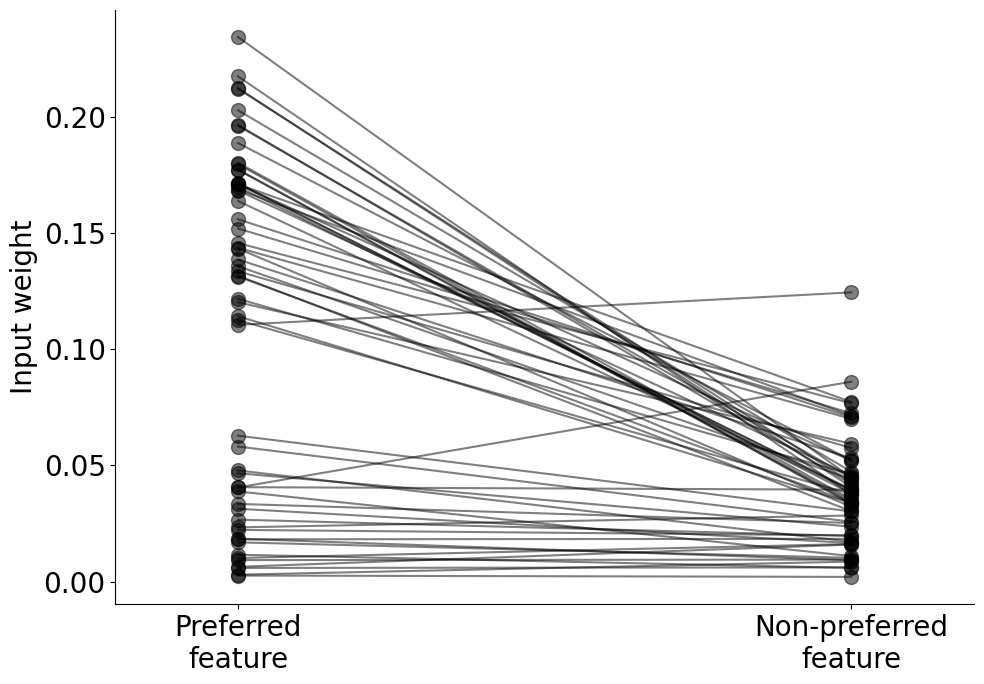

success_2023-05-10-14-28-42_wcst_106_sparsity0
t=9.374152384072454, p-value=4.734995240042624e-15


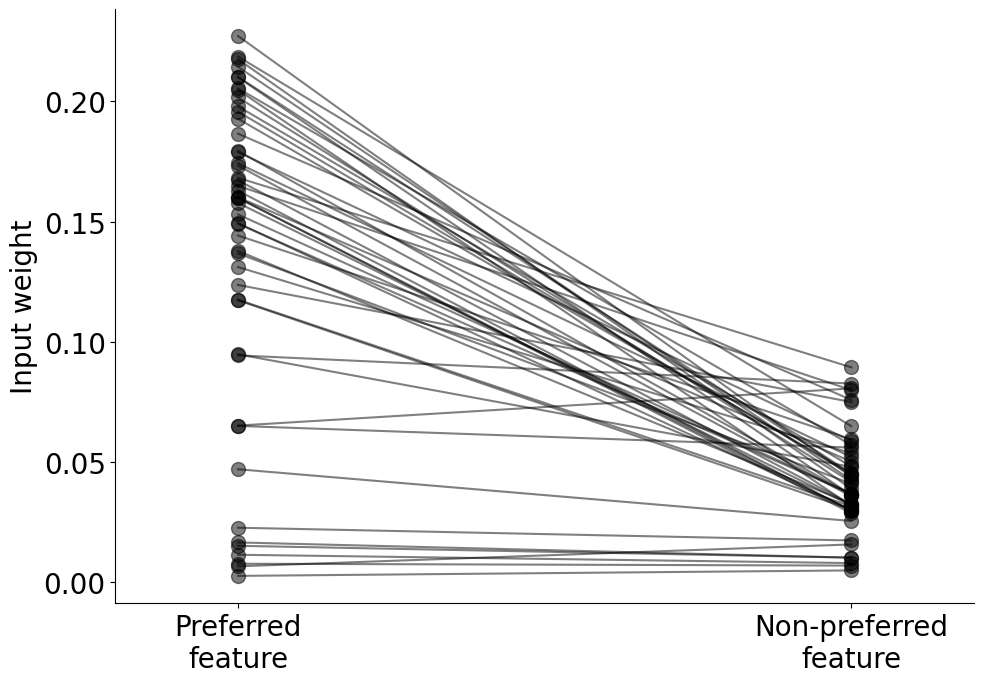

success_2023-05-10-14-28-42_wcst_10_sparsity0
t=11.082923698136593, p-value=2.5784669336975575e-19


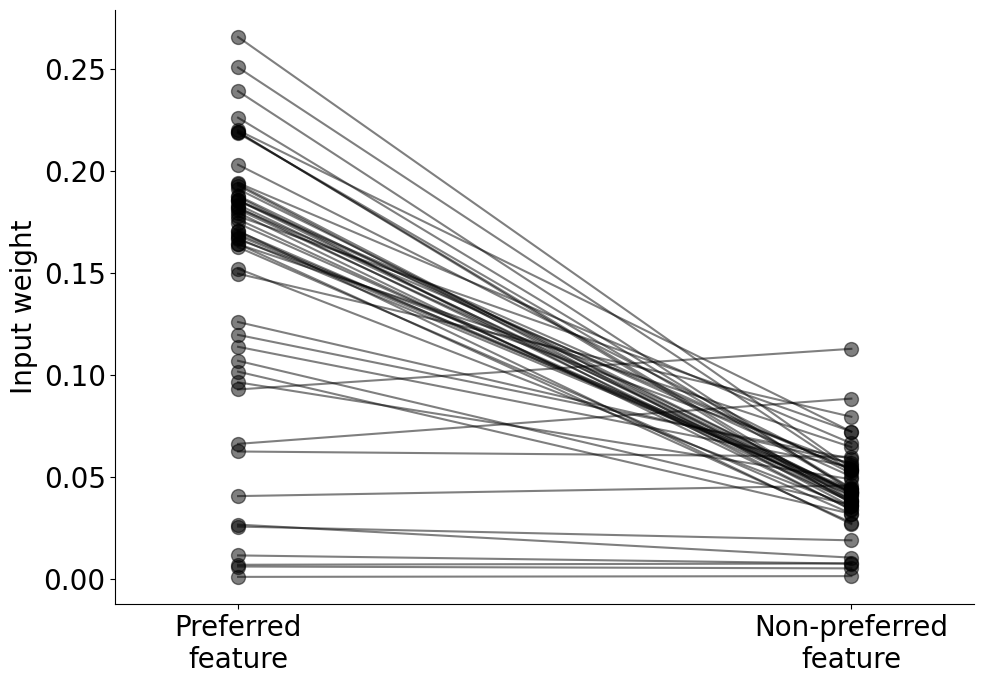

success_2023-05-10-14-28-42_wcst_116_sparsity0
t=7.237048351300219, p-value=1.626618328372496e-10


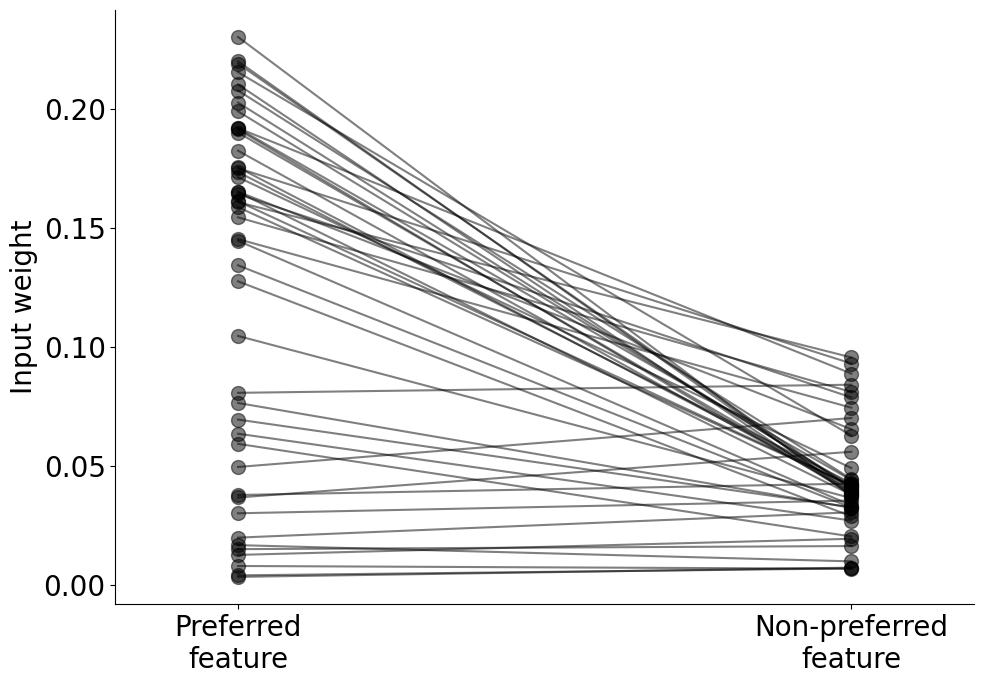

success_2023-05-10-14-28-42_wcst_118_sparsity0
t=9.274826590009326, p-value=1.794981280915911e-15


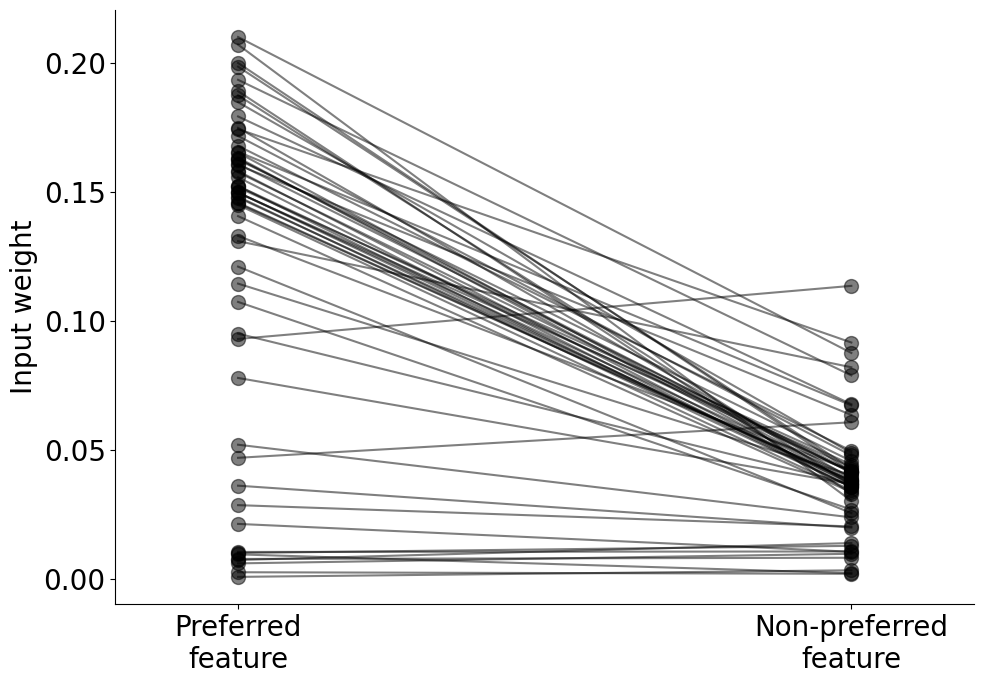

success_2023-05-10-14-28-42_wcst_121_sparsity0
t=6.9072349878454595, p-value=2.5306561550587615e-10


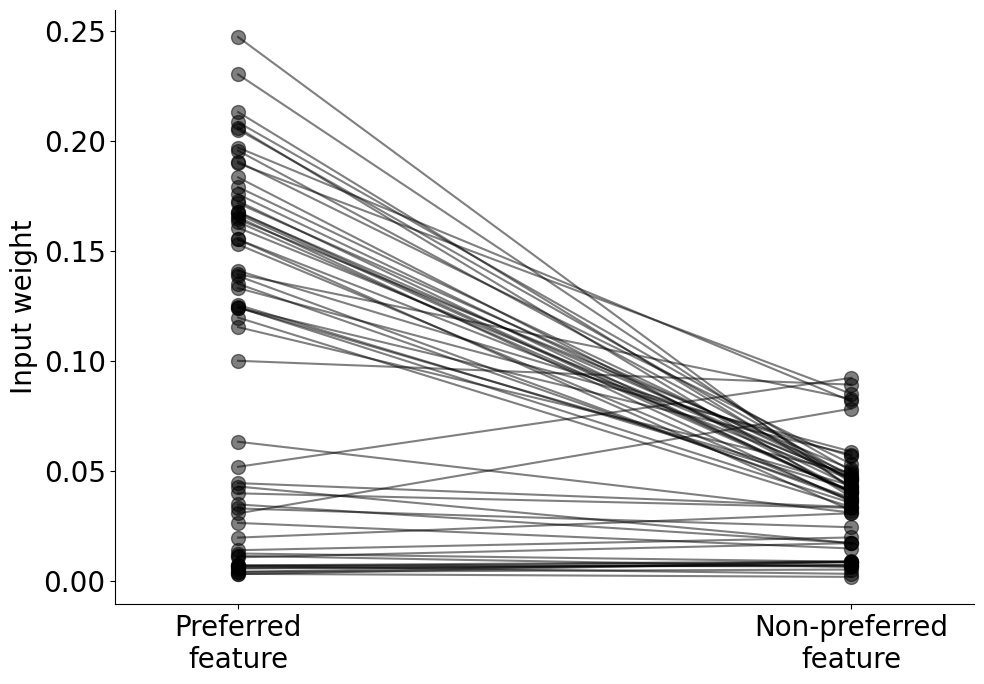

success_2023-05-10-14-28-42_wcst_122_sparsity0
t=8.246694548947001, p-value=2.86340412619778e-13


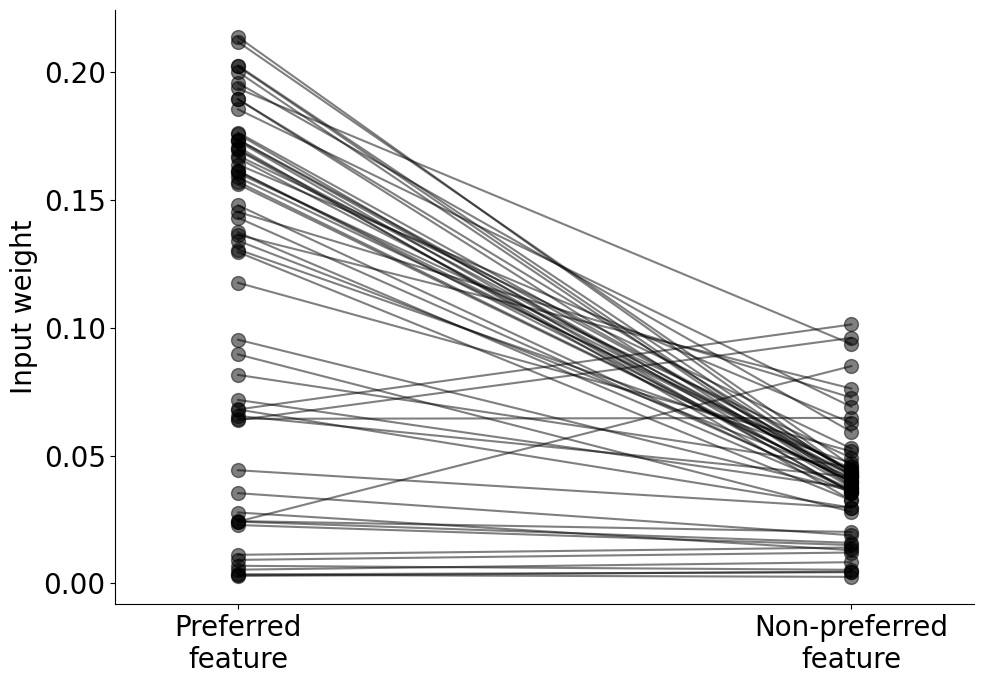

success_2023-05-10-14-28-42_wcst_124_sparsity0
t=7.364574071616345, p-value=2.7992807005936223e-11


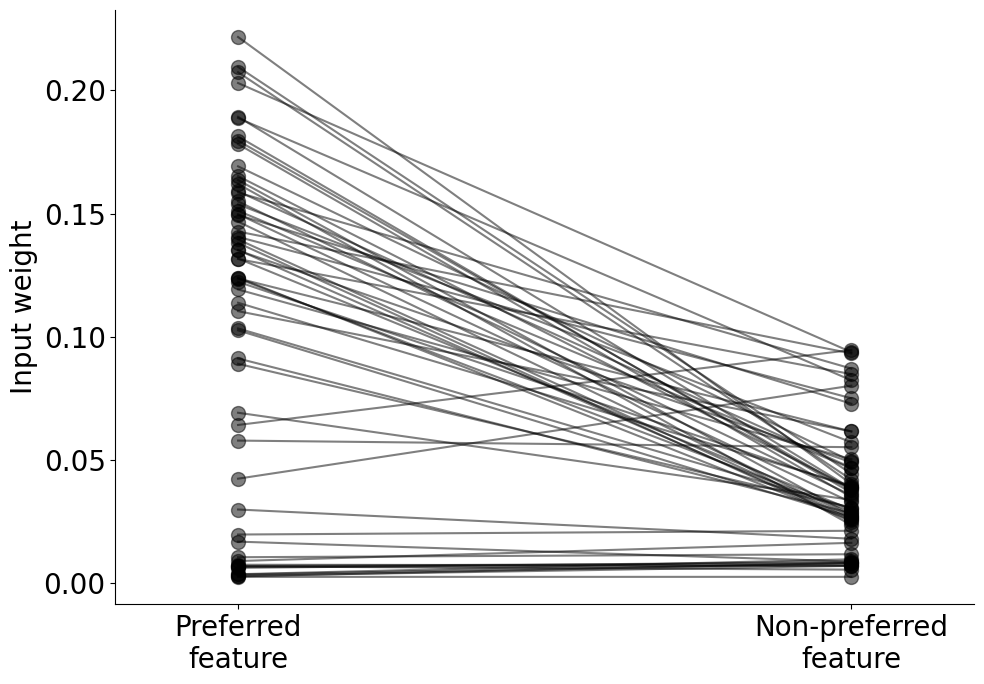

success_2023-05-10-14-28-42_wcst_126_sparsity0
t=4.9394495213277585, p-value=3.0732273413925172e-06


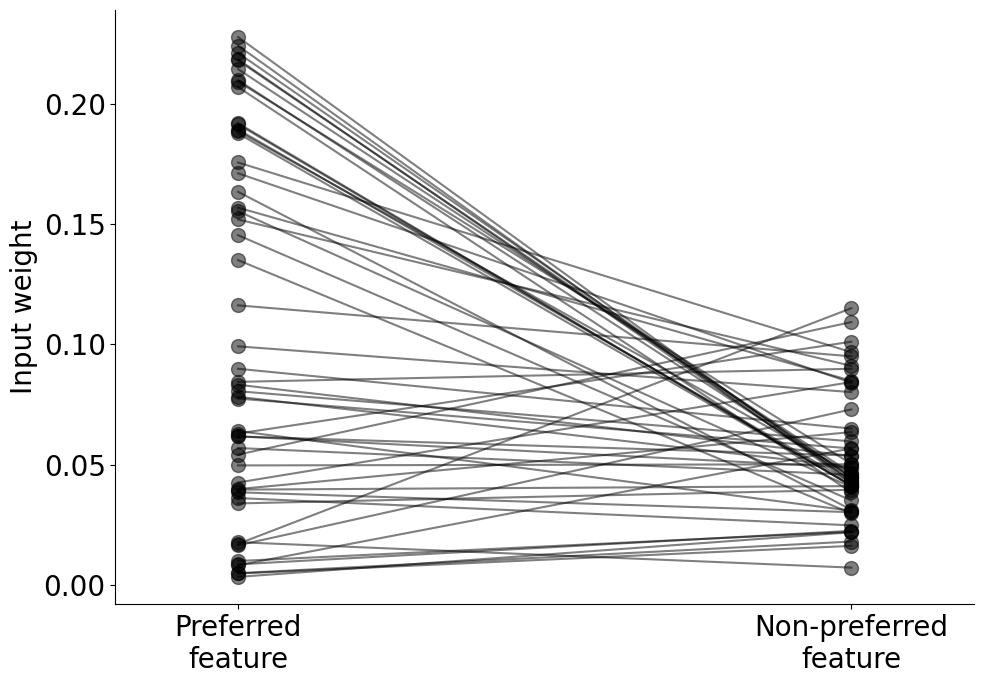

success_2023-05-10-14-28-42_wcst_131_sparsity0
t=8.125794511772668, p-value=8.928715454410643e-12


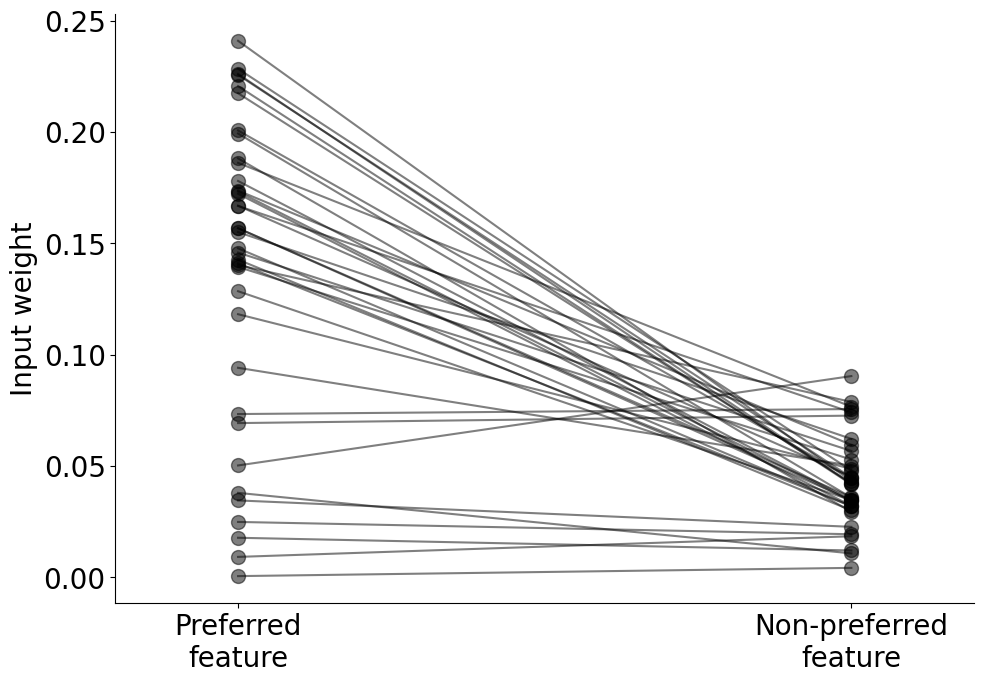

success_2023-05-10-14-28-42_wcst_134_sparsity0
t=7.62873562297979, p-value=1.5581273480444695e-11


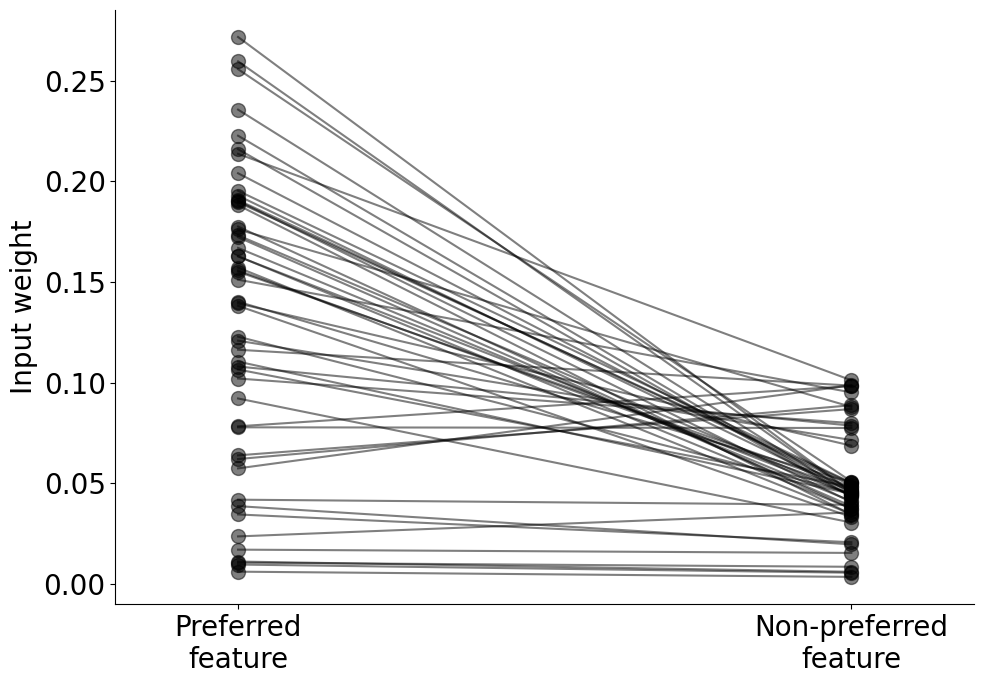

success_2023-05-10-14-28-42_wcst_136_sparsity0
t=12.746064085480084, p-value=1.6231187926861594e-21


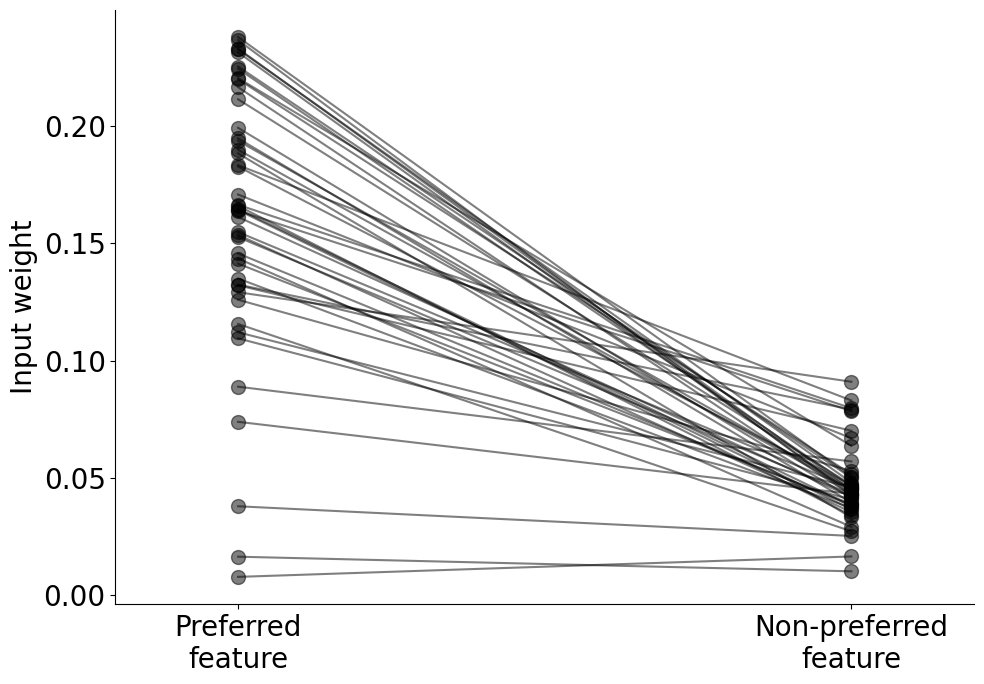

success_2023-05-10-14-28-42_wcst_139_sparsity0
t=9.490622362417838, p-value=2.8151889903473213e-16


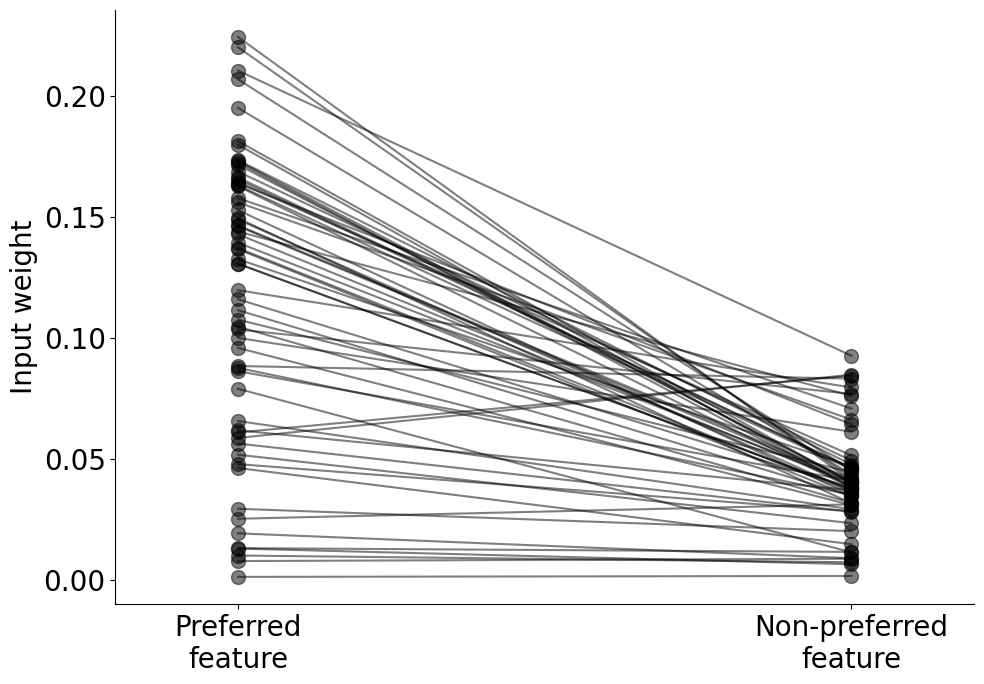

success_2023-05-10-14-28-42_wcst_142_sparsity0
t=9.641733590642845, p-value=3.820744773197085e-15


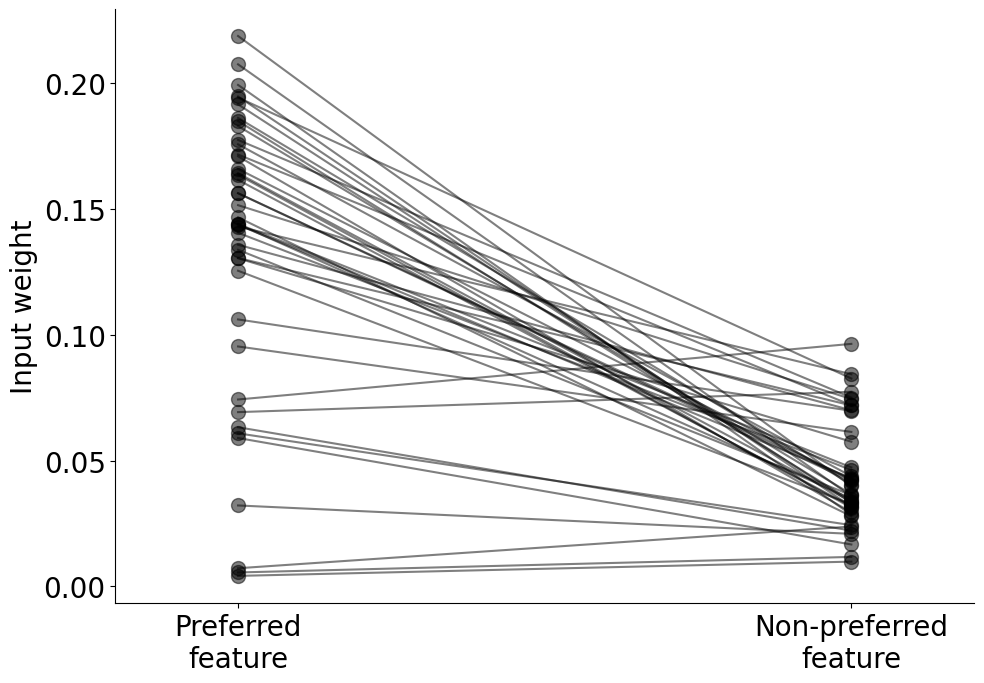

success_2023-05-10-14-28-42_wcst_143_sparsity0
t=11.21603569619493, p-value=5.0084088162356295e-20


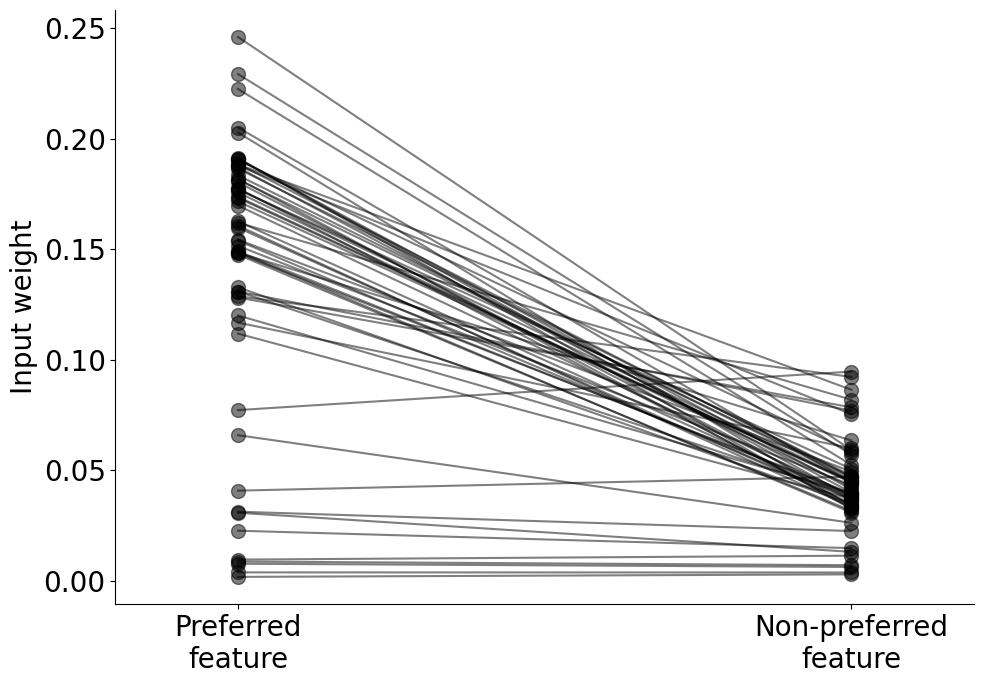

success_2023-05-10-14-28-42_wcst_144_sparsity0
t=7.511065738600155, p-value=1.1490010103047899e-11


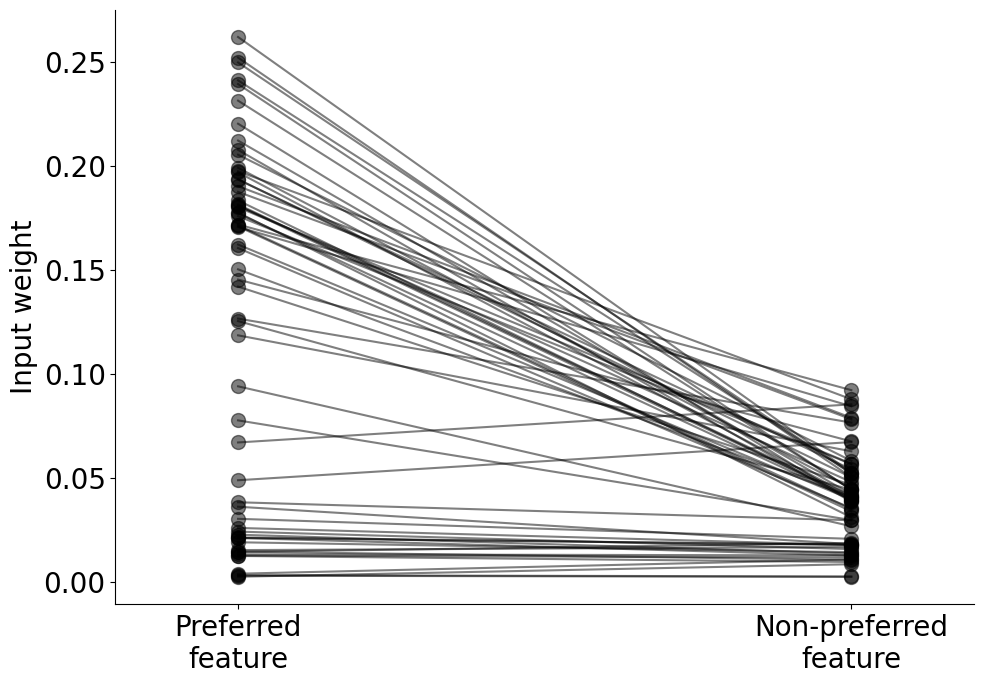

success_2023-05-10-14-28-42_wcst_149_sparsity0
t=6.71056939960462, p-value=5.904083839074943e-10


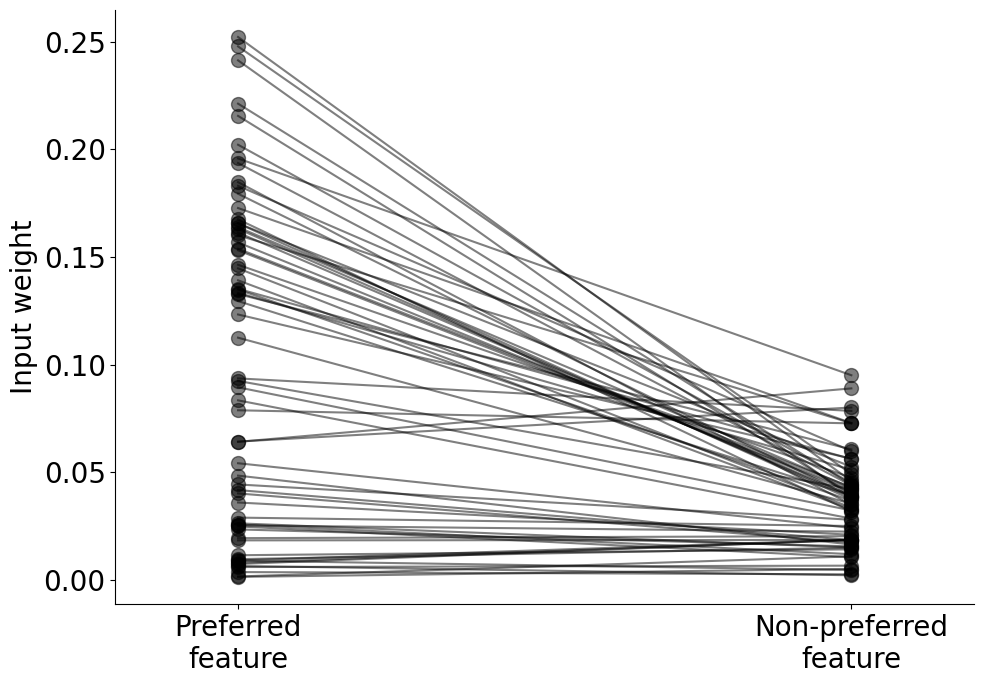

success_2023-05-10-14-28-42_wcst_151_sparsity0
t=7.864217463633469, p-value=2.7508350199611695e-12


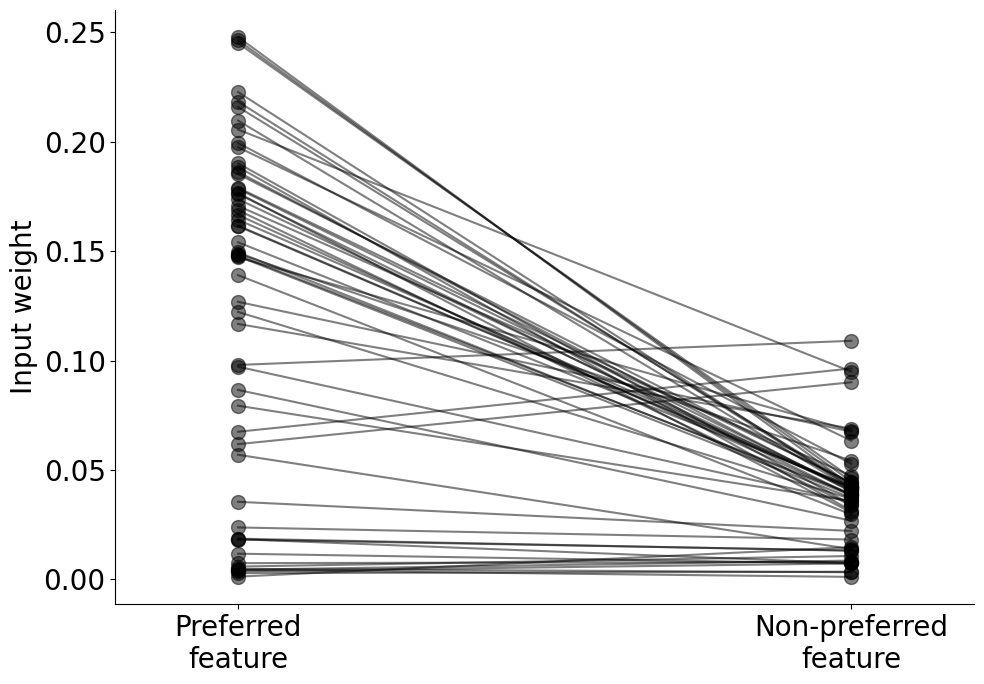

success_2023-05-10-14-28-42_wcst_156_sparsity0
t=7.168417698177495, p-value=1.1402782180986786e-10


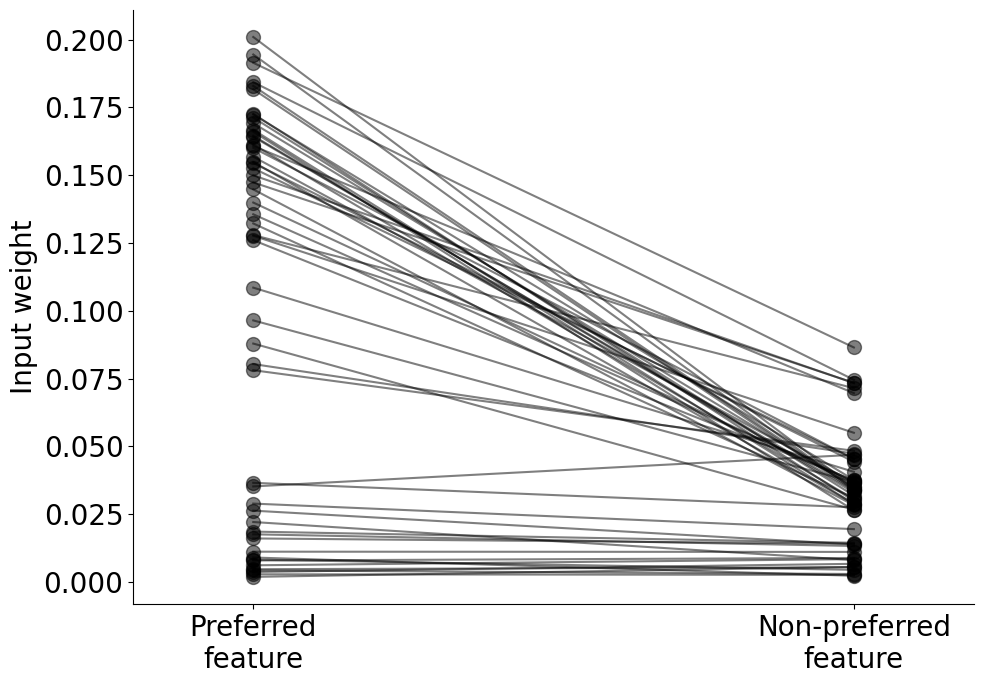

success_2023-05-10-14-28-42_wcst_165_sparsity0
t=8.060043503526005, p-value=1.5136430375724905e-12


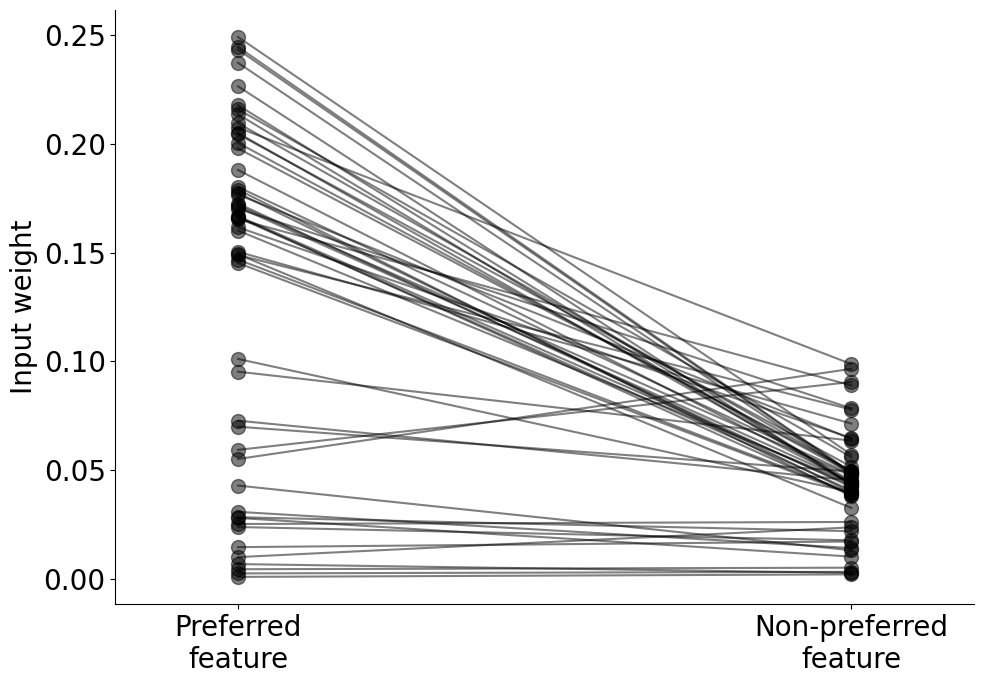

success_2023-05-10-14-28-42_wcst_16_sparsity0
t=6.4339582584345765, p-value=7.838265057512482e-09


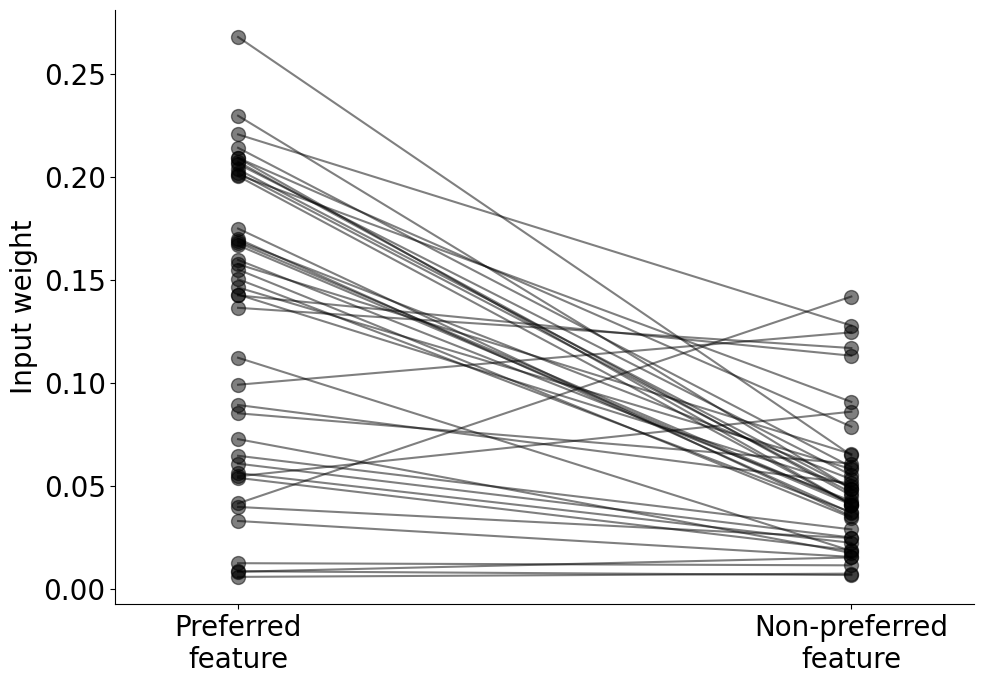

success_2023-05-10-14-28-42_wcst_170_sparsity0
t=6.776544680307508, p-value=4.228821183165478e-10


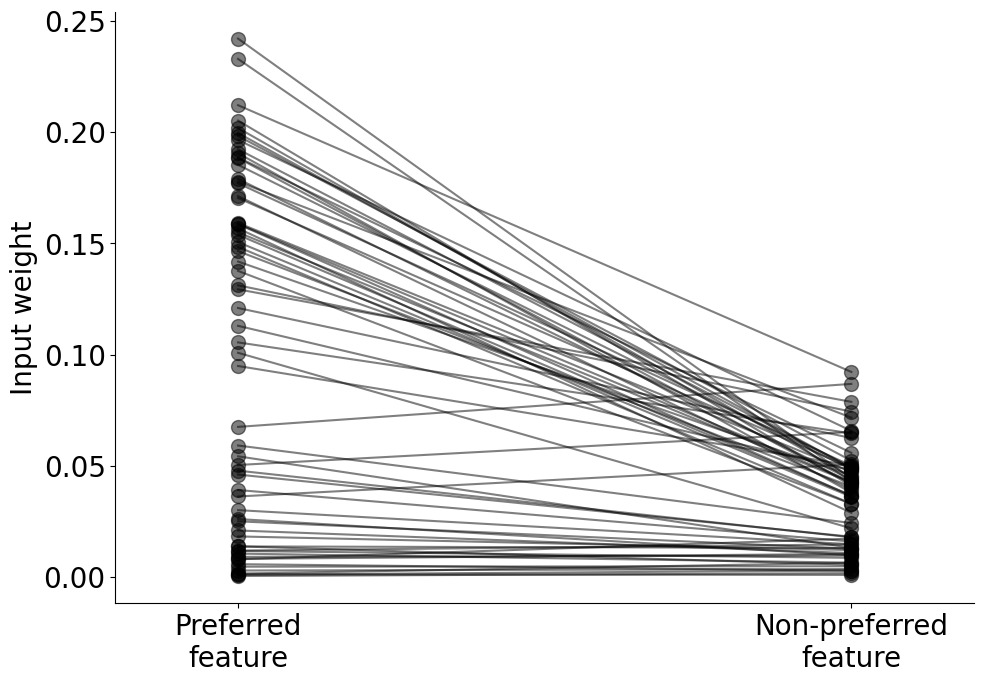

success_2023-05-10-14-28-42_wcst_176_sparsity0
t=8.06908747864749, p-value=4.437451104391618e-13


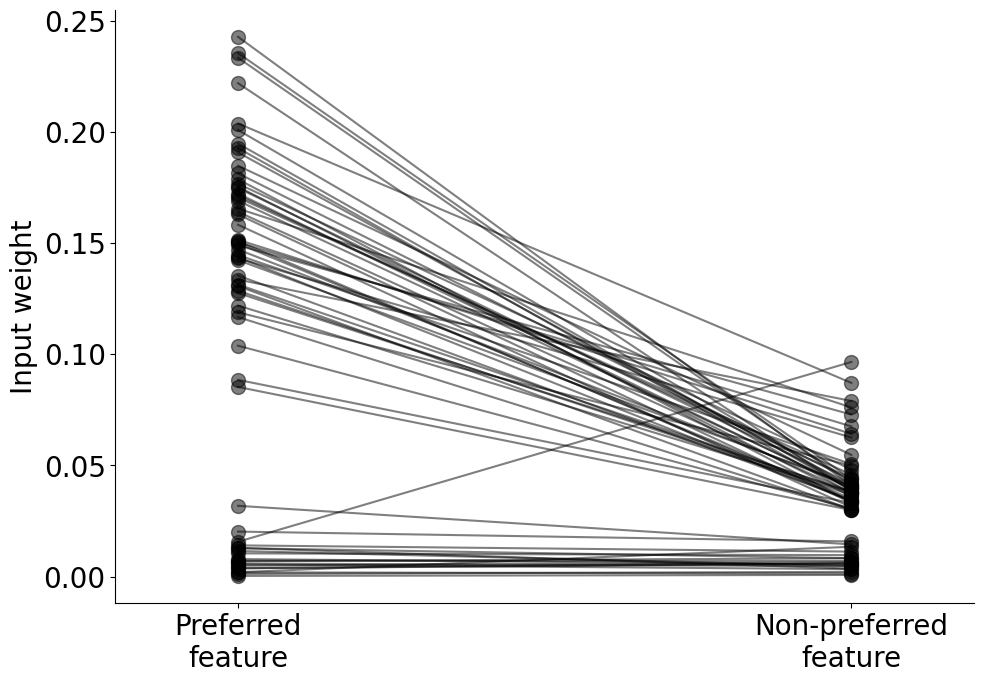

success_2023-05-10-14-28-42_wcst_177_sparsity0
t=7.428367098195084, p-value=3.4572438465289394e-11


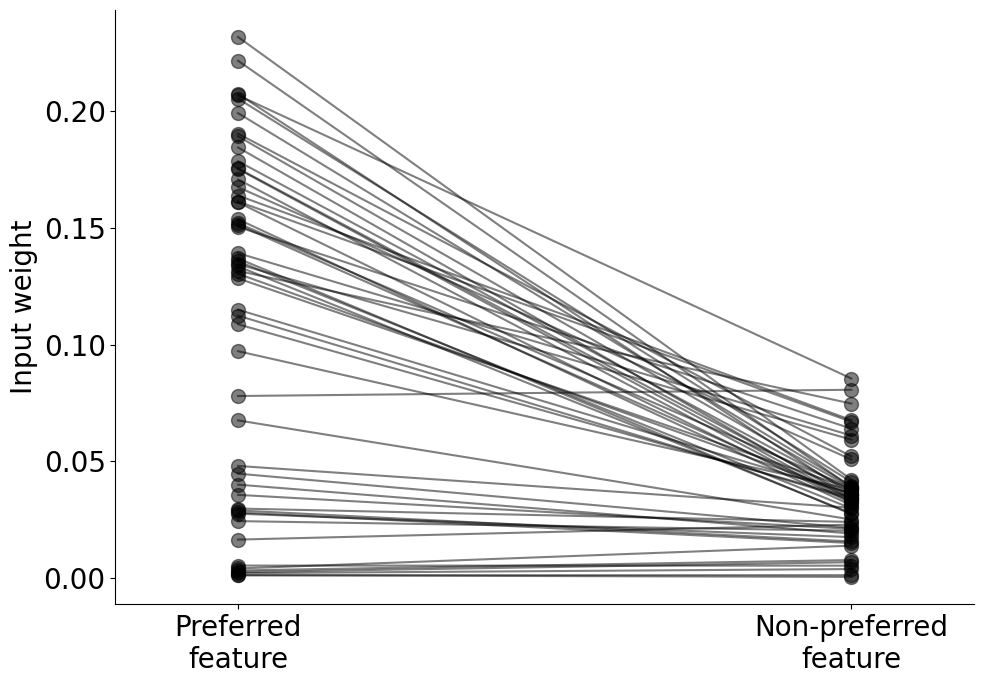

success_2023-05-10-14-28-42_wcst_179_sparsity0
t=3.619021583213808, p-value=0.000431542012808126


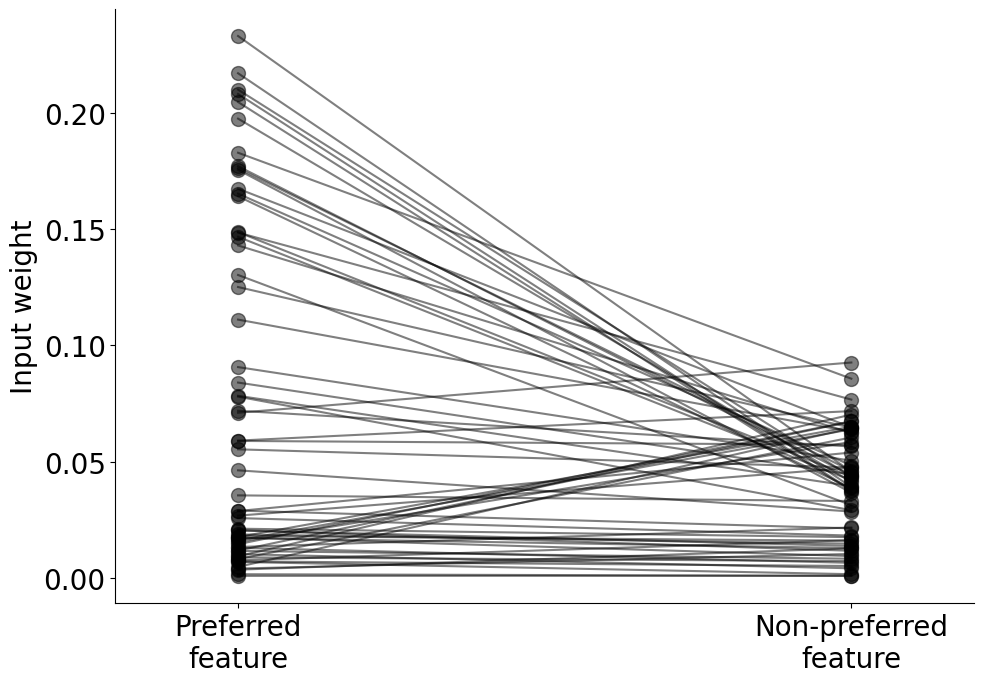

success_2023-05-10-14-28-42_wcst_17_sparsity0
t=7.464404127512887, p-value=2.0544608564683364e-10


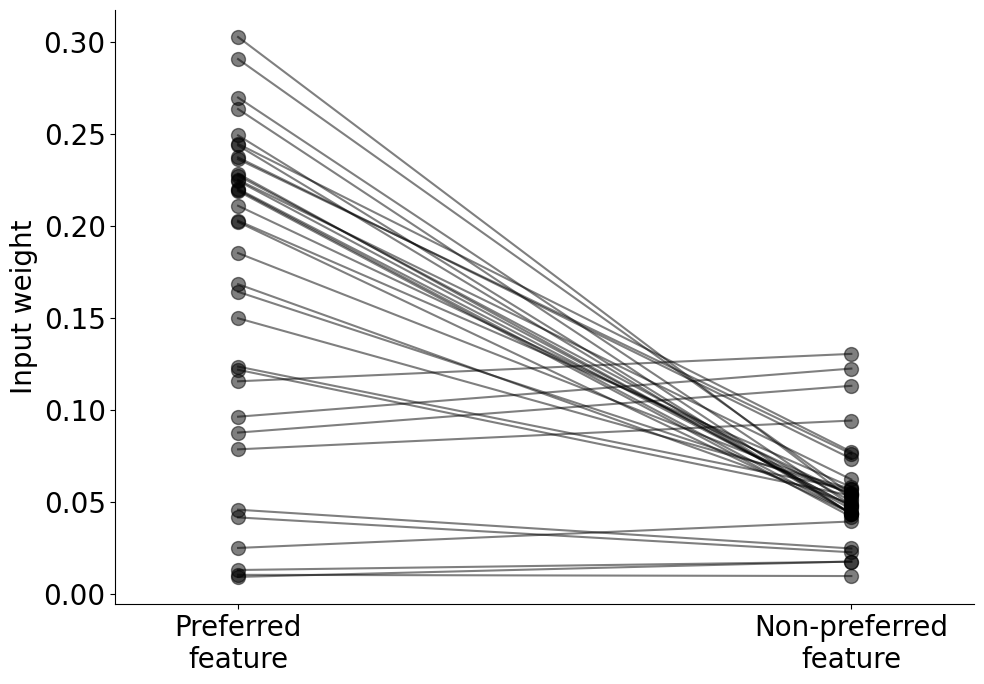

success_2023-05-10-14-28-42_wcst_180_sparsity0
t=6.335383293565012, p-value=4.665568924331933e-09


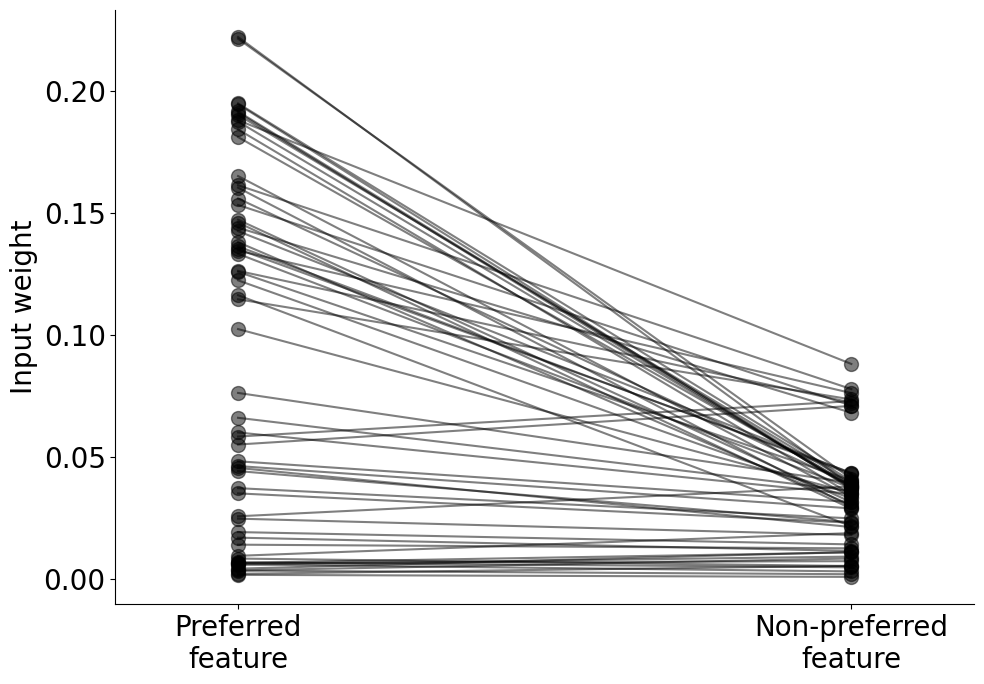

success_2023-05-10-14-28-42_wcst_189_sparsity0
t=8.669717401607045, p-value=4.2806882938199415e-14


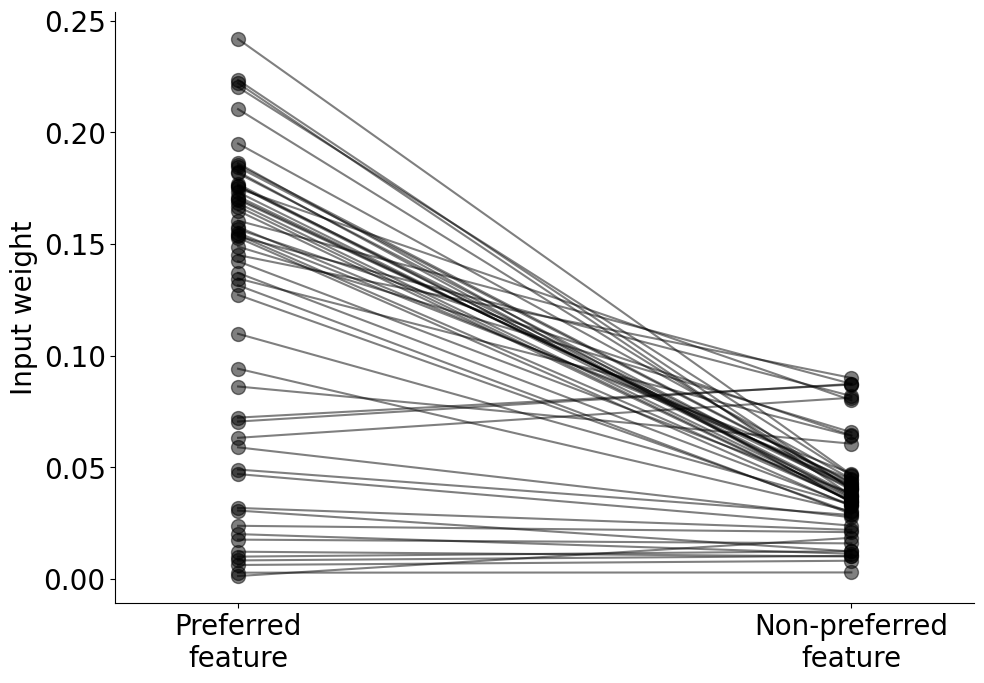

success_2023-05-10-14-28-42_wcst_18_sparsity0
t=9.045003145646383, p-value=1.9724323632663175e-14


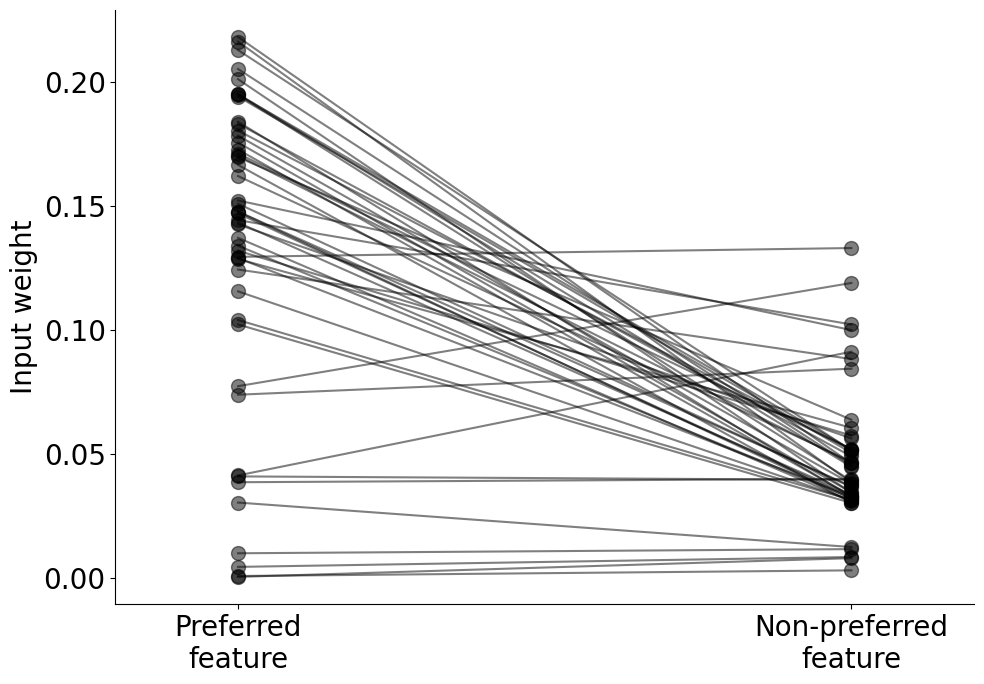

success_2023-05-10-14-28-42_wcst_197_sparsity0
t=7.741081477856087, p-value=7.400752129366604e-12


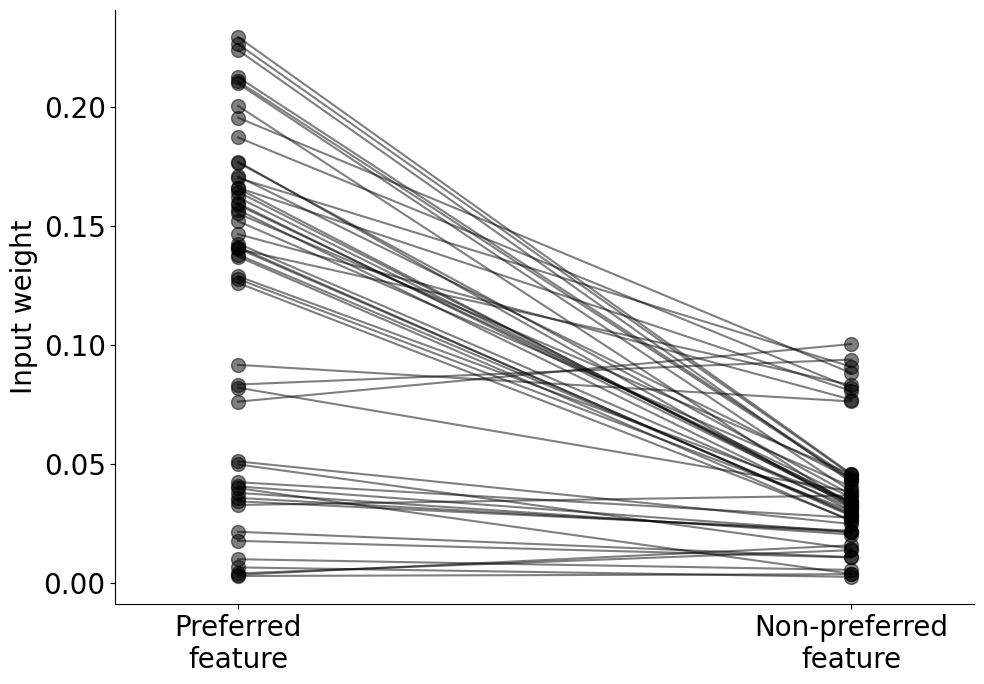

success_2023-05-10-14-28-42_wcst_19_sparsity0
t=3.702563494440378, p-value=0.0004378109682913278


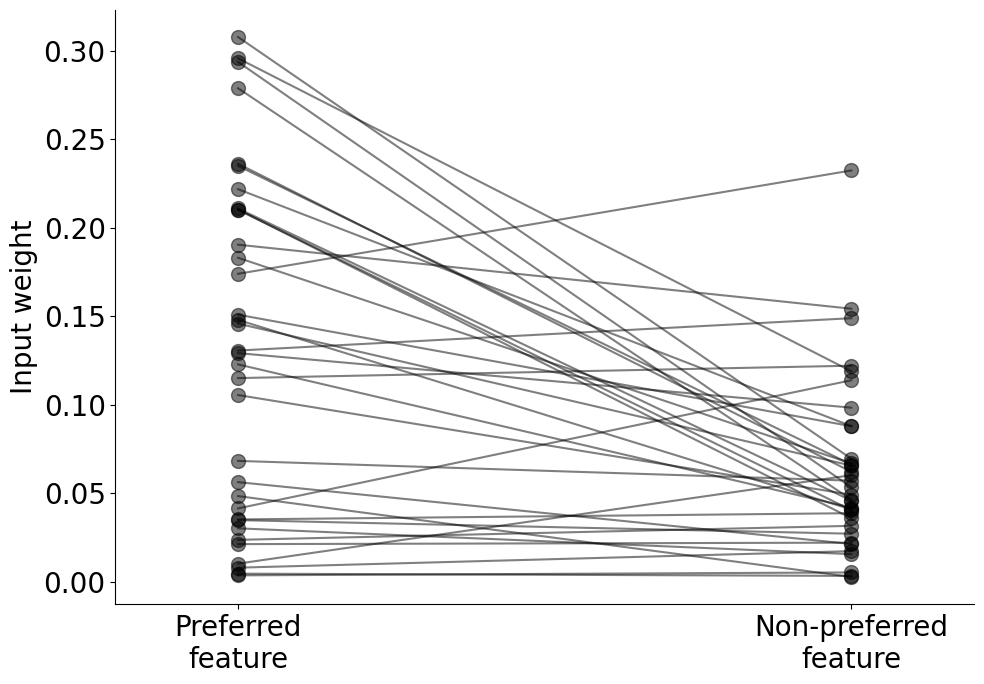

success_2023-05-10-14-28-42_wcst_200_sparsity0
t=7.987875367476833, p-value=4.9063700957298334e-12


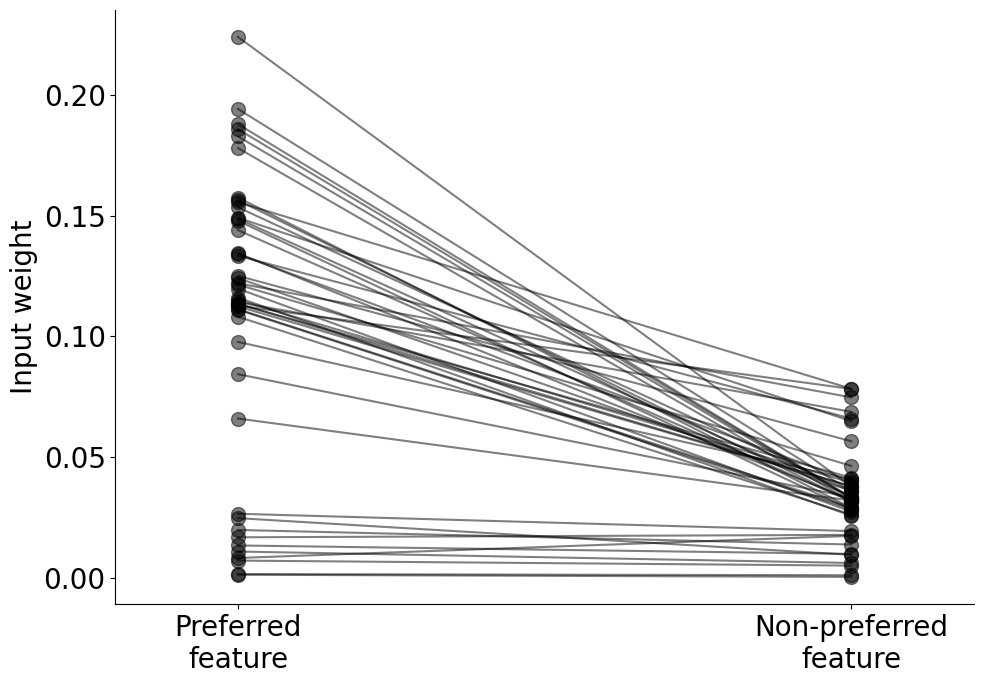

success_2023-05-10-14-28-42_wcst_20_sparsity0
t=9.011430011956174, p-value=3.2189738690743084e-13


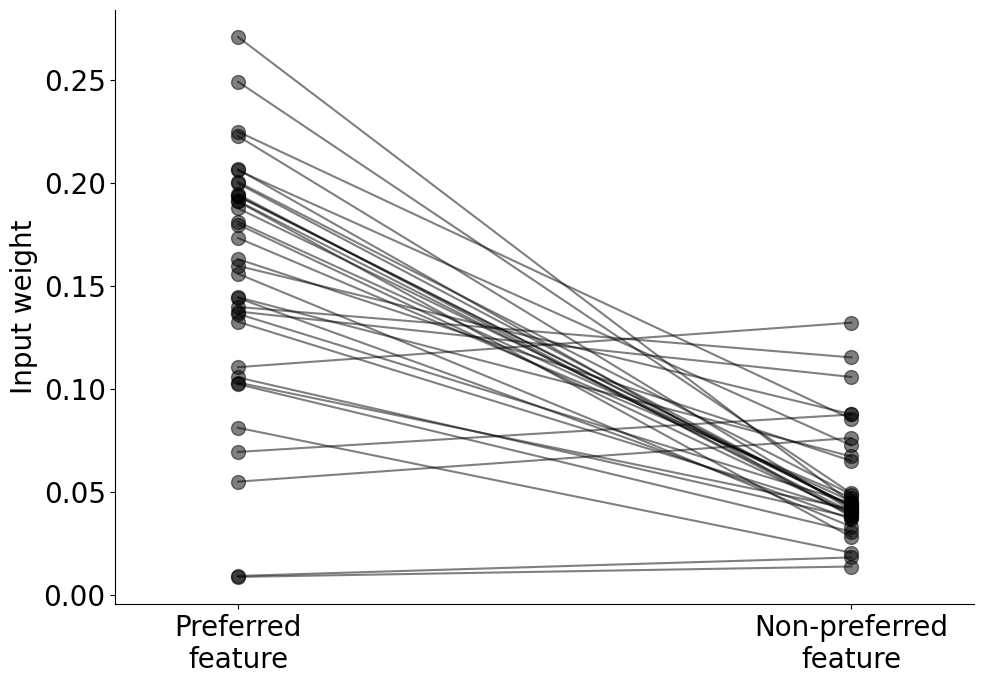

success_2023-05-10-14-28-42_wcst_21_sparsity0
t=4.783266457437929, p-value=1.0530623288916337e-05


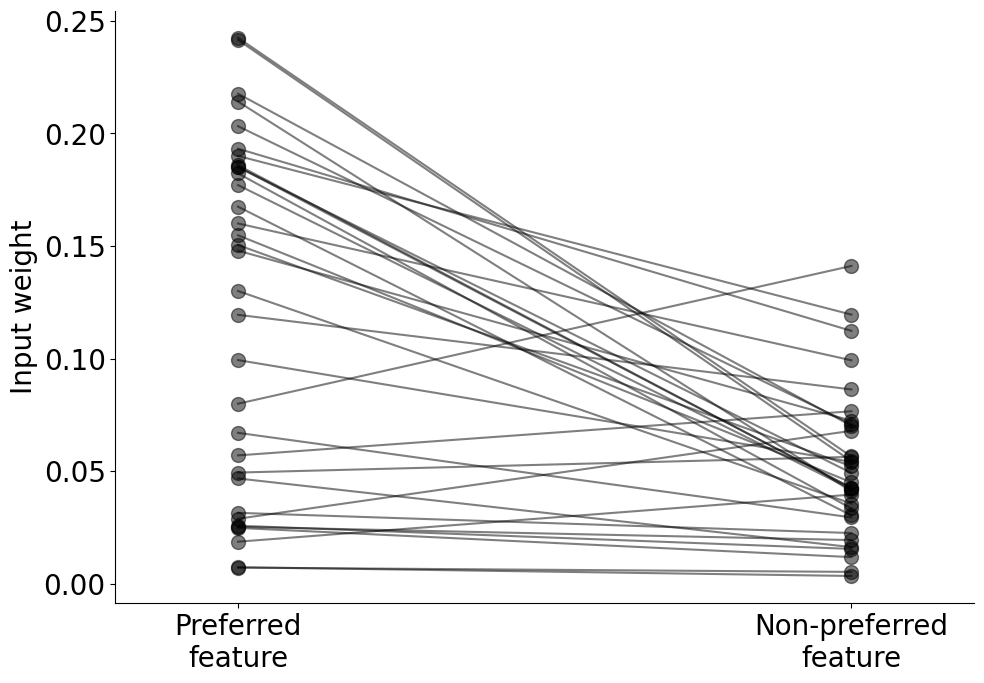

success_2023-05-10-14-28-42_wcst_23_sparsity0
t=6.5025615560659356, p-value=4.6283433052272765e-09


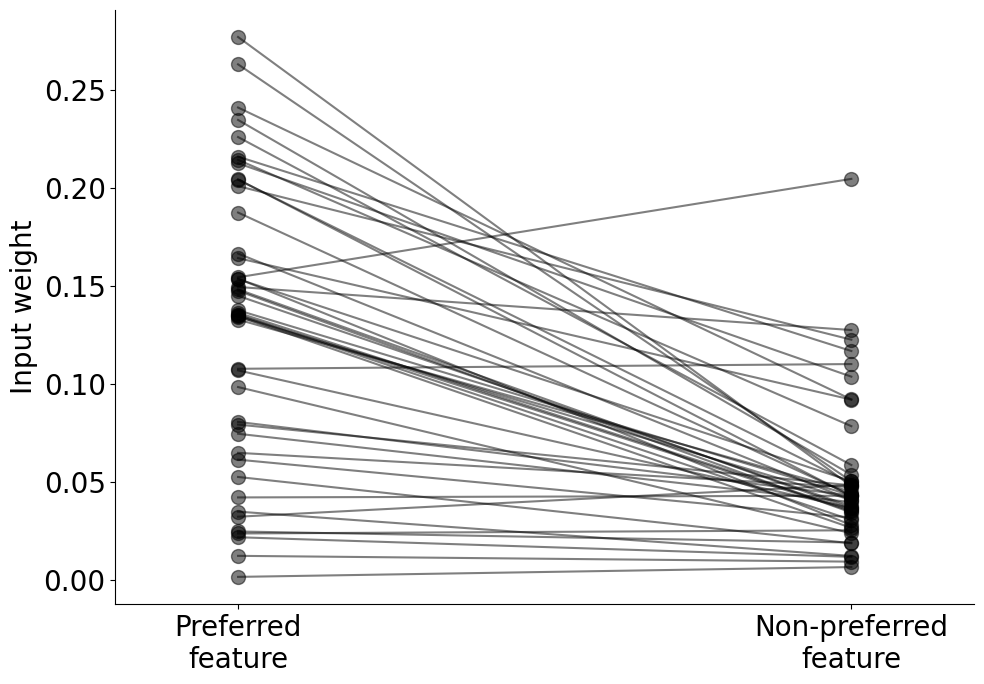

success_2023-05-10-14-28-42_wcst_26_sparsity0
t=5.125195163628488, p-value=2.4021943505683084e-06


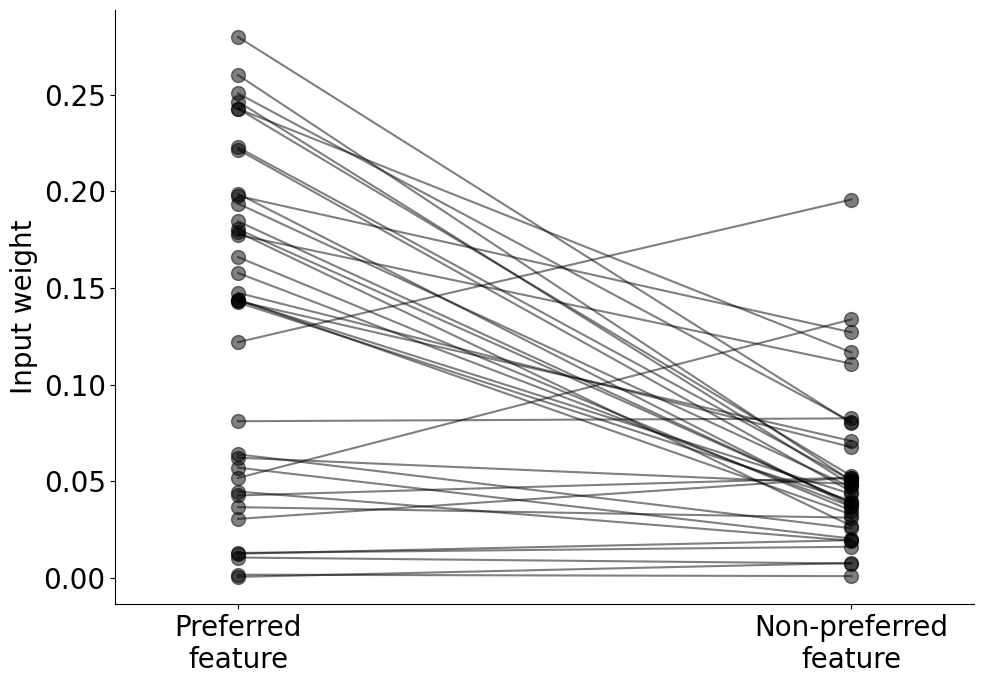

success_2023-05-10-14-28-42_wcst_42_sparsity0
t=8.281222114908681, p-value=8.178722845132191e-13


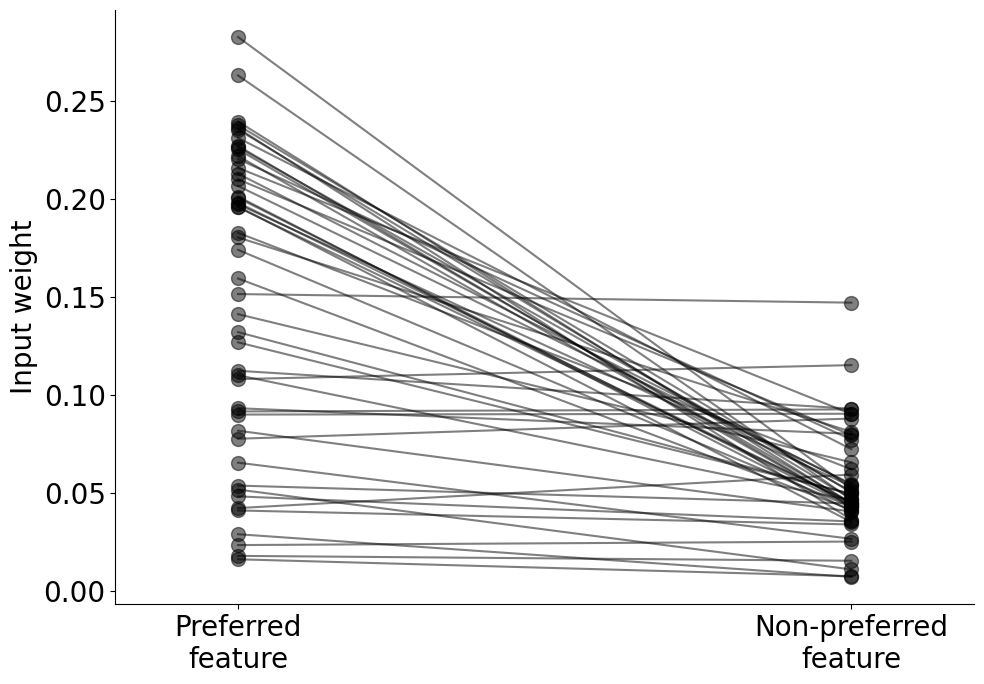

success_2023-05-10-14-28-42_wcst_43_sparsity0
t=6.761680342556724, p-value=1.8520743122606376e-09


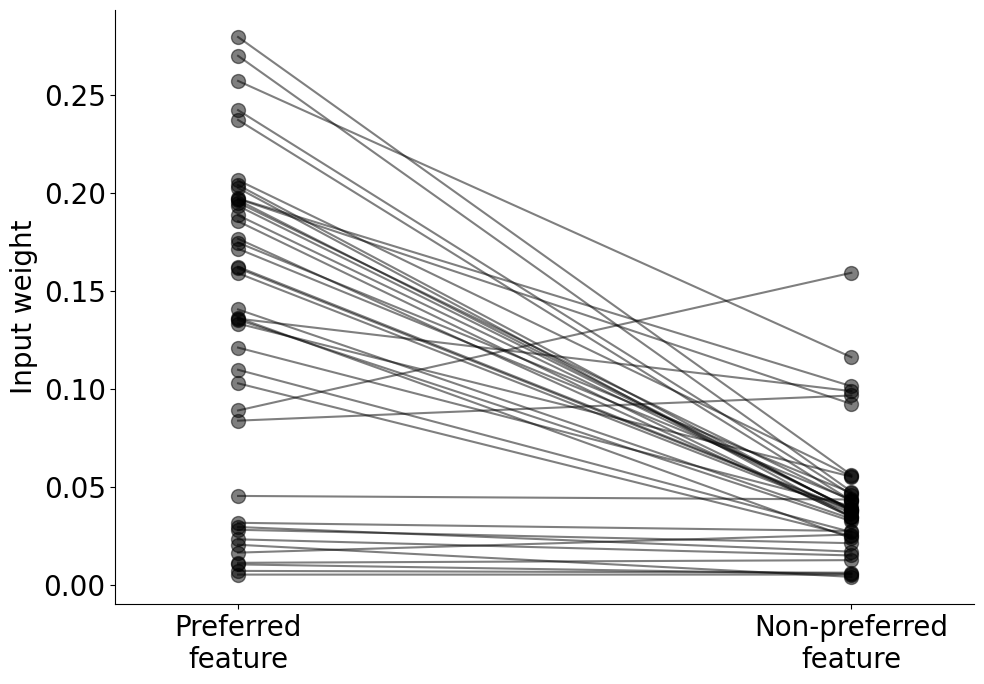

success_2023-05-10-14-28-42_wcst_44_sparsity0
t=6.489097606995763, p-value=4.9166507798236676e-09


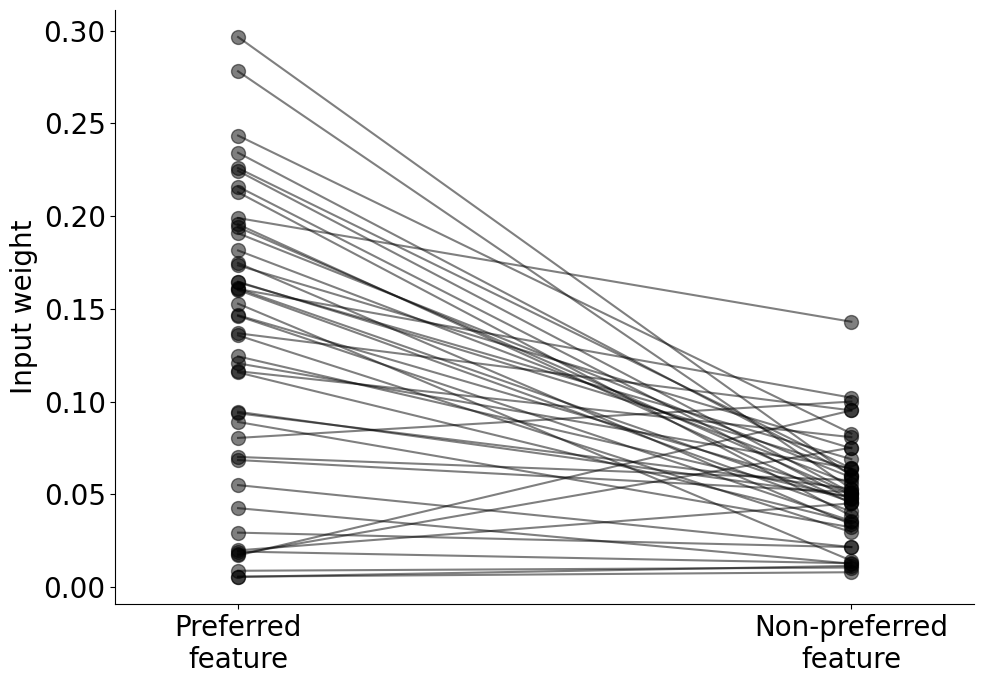

success_2023-05-10-14-28-42_wcst_50_sparsity0
t=11.269578204449806, p-value=4.877622903973908e-18


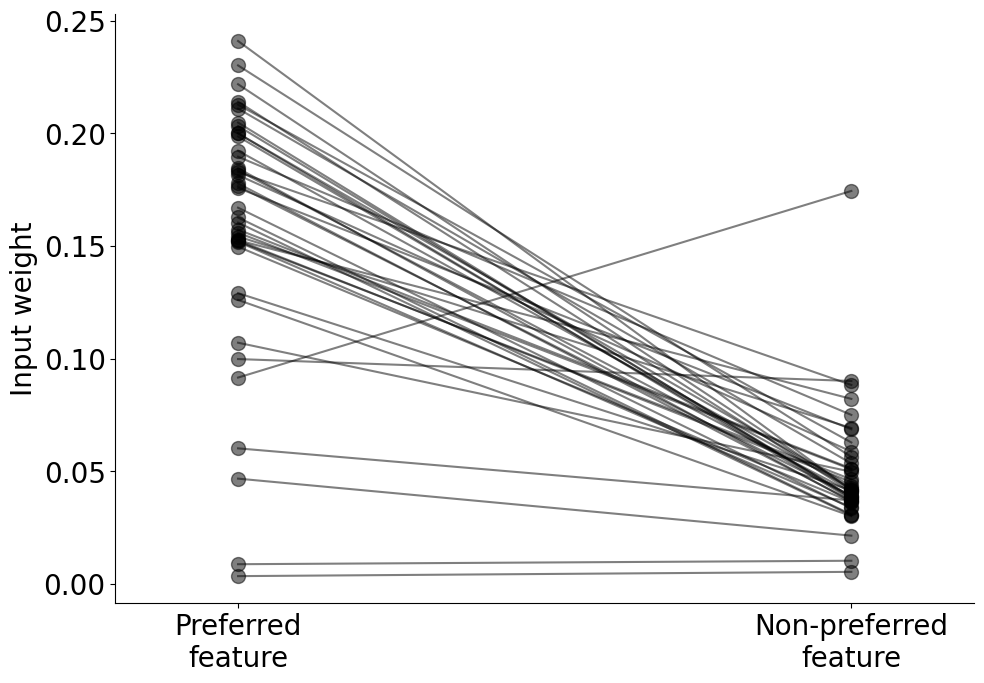

success_2023-05-10-14-28-42_wcst_57_sparsity0
t=8.39968112209503, p-value=3.53402046167674e-13


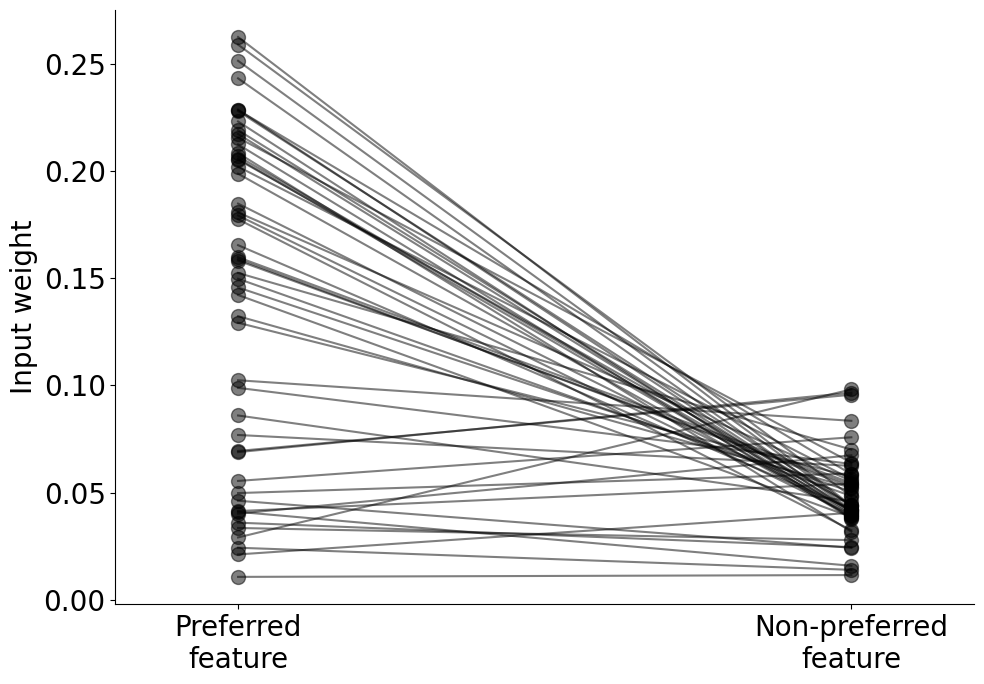

success_2023-05-10-14-28-42_wcst_58_sparsity0
t=5.76016412392543, p-value=1.27608741025288e-07


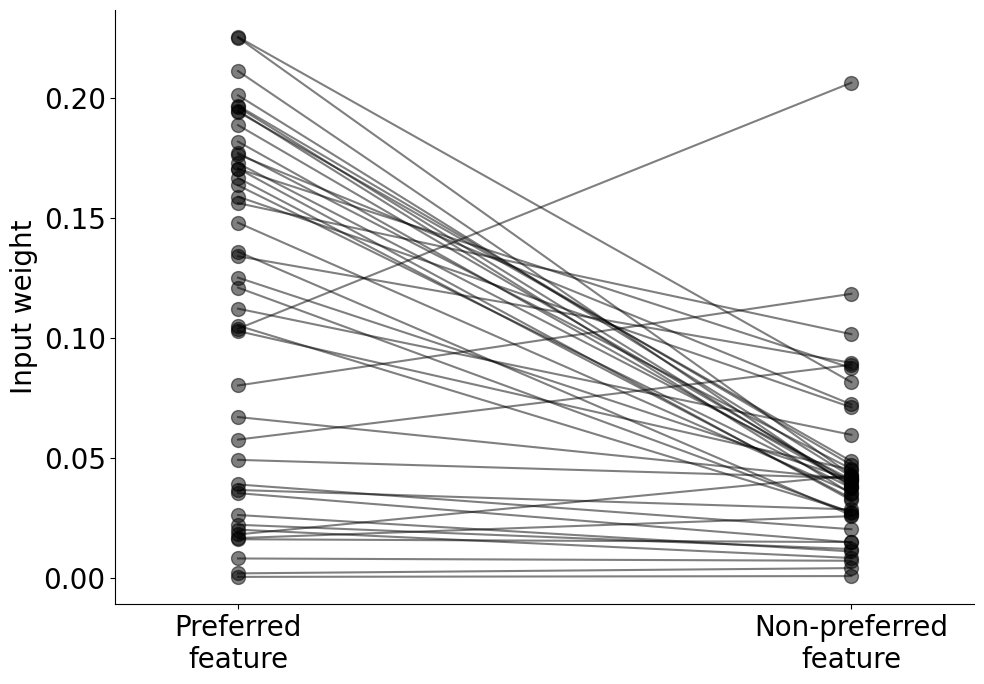

success_2023-05-10-14-28-42_wcst_5_sparsity0
t=7.2639108053168, p-value=1.763923091958985e-10


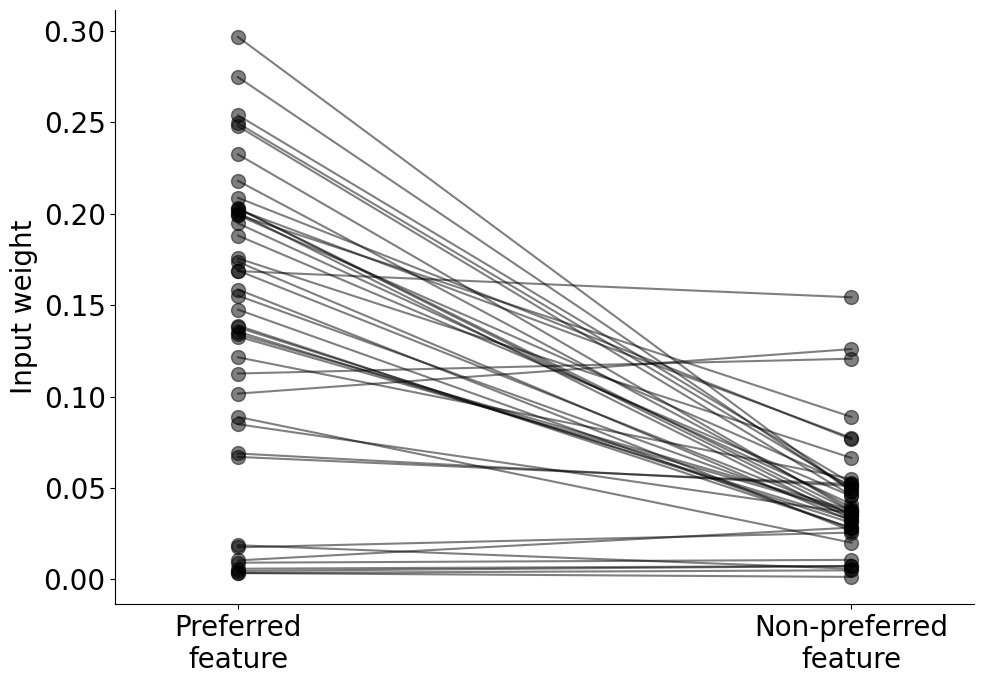

success_2023-05-10-14-28-42_wcst_60_sparsity0
t=7.212462270831782, p-value=4.4767243070839183e-10


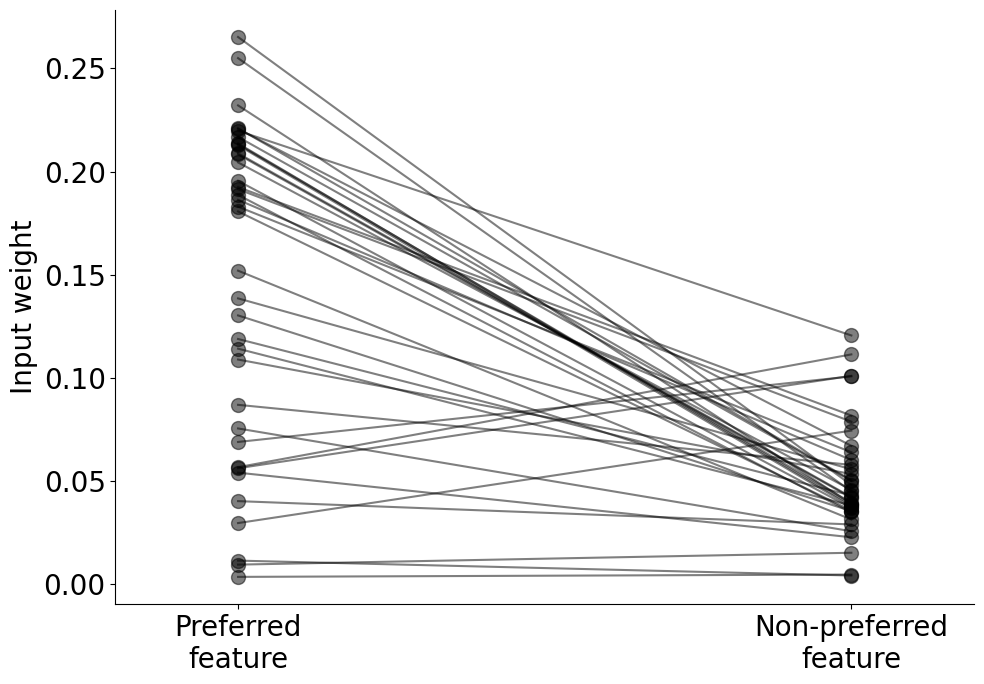

success_2023-05-10-14-28-42_wcst_63_sparsity0
t=5.486711046152939, p-value=5.785363340190425e-07


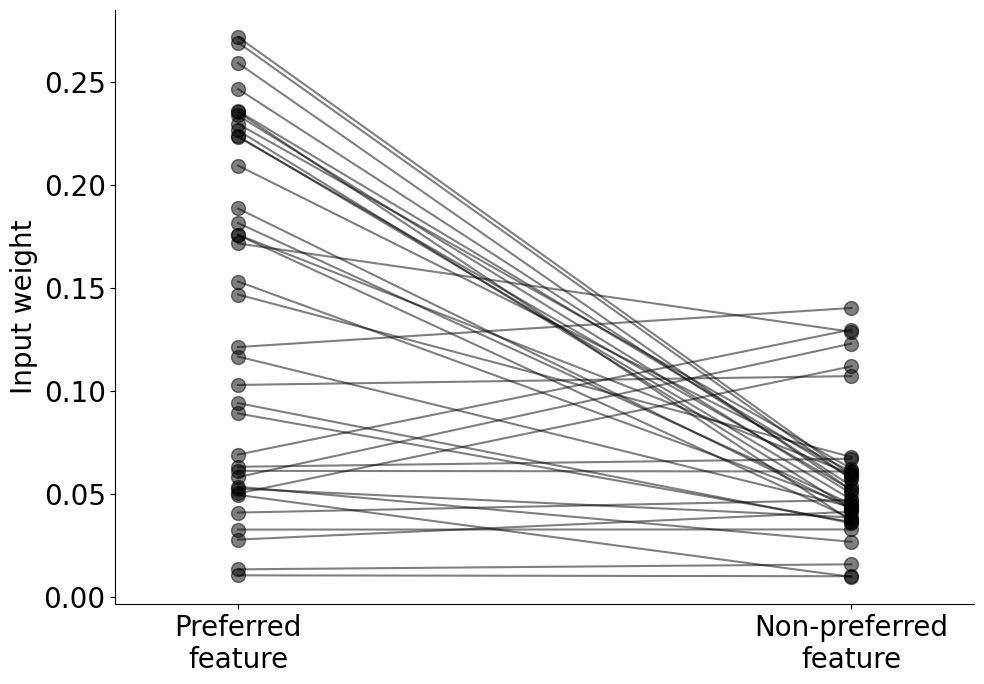

success_2023-05-10-14-28-42_wcst_6_sparsity0
t=6.565659235039597, p-value=5.710134522904174e-09


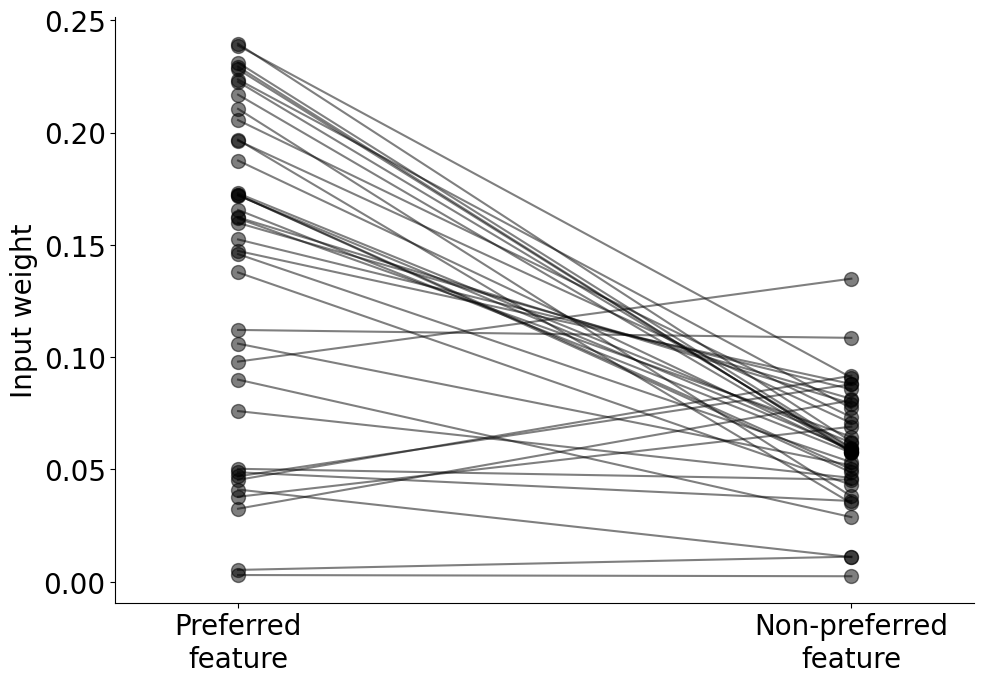

success_2023-05-10-14-28-42_wcst_7_sparsity0
t=6.373069607161742, p-value=3.7340627884157144e-08


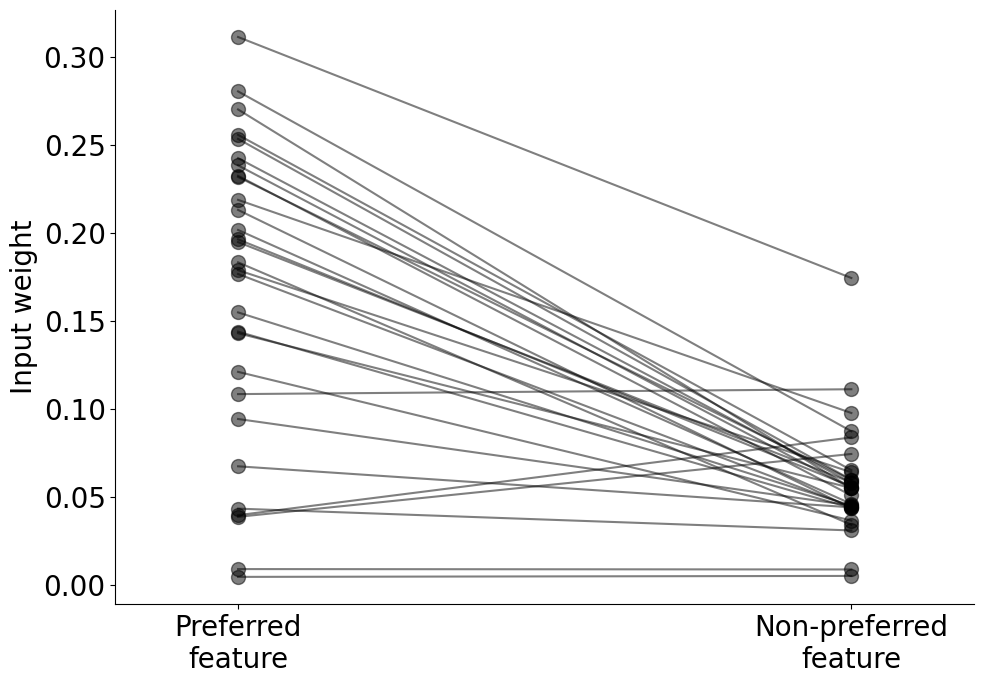

success_2023-05-10-14-28-42_wcst_82_sparsity0
t=4.552964820700868, p-value=2.4272841850817875e-05


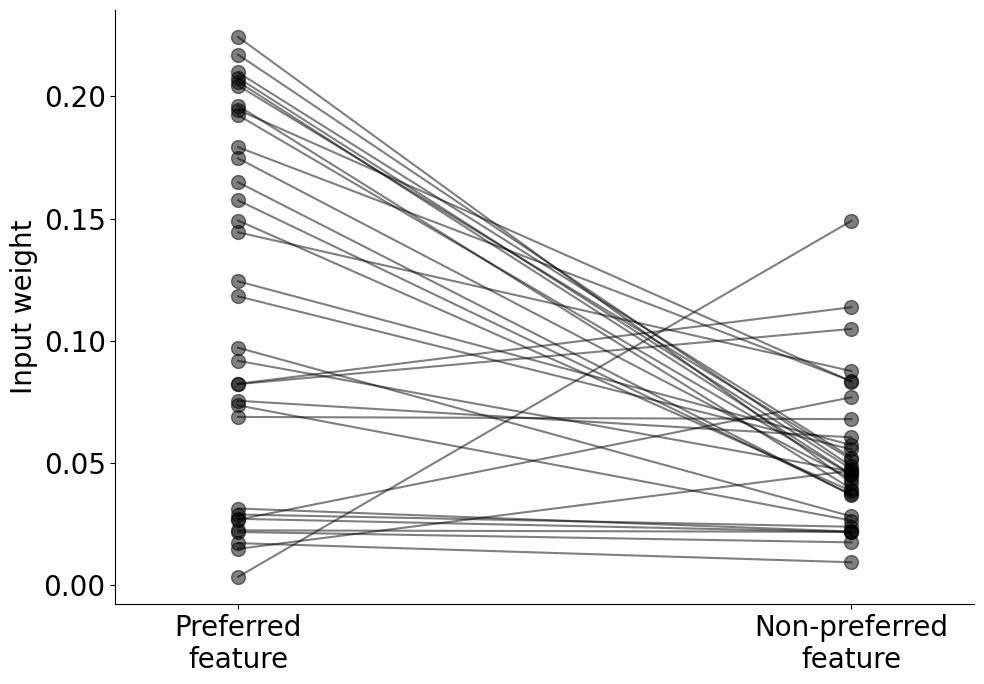

success_2023-05-10-14-28-42_wcst_86_sparsity0
t=4.8146844140905625, p-value=4.92220401023556e-06


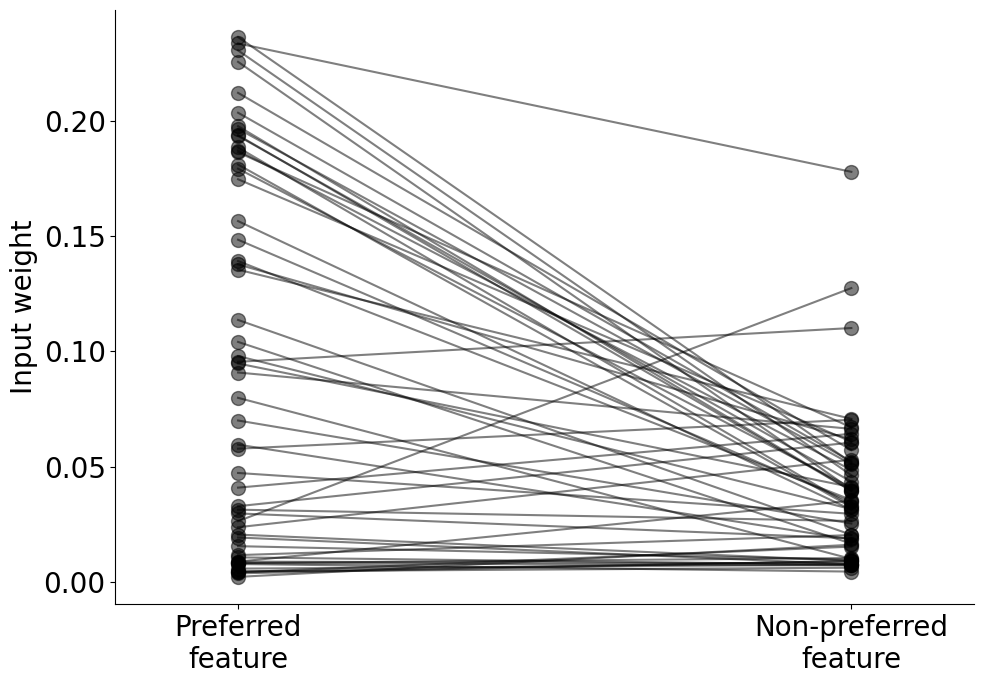

success_2023-05-10-14-28-42_wcst_87_sparsity0
t=4.892551013939862, p-value=5.651198507226074e-06


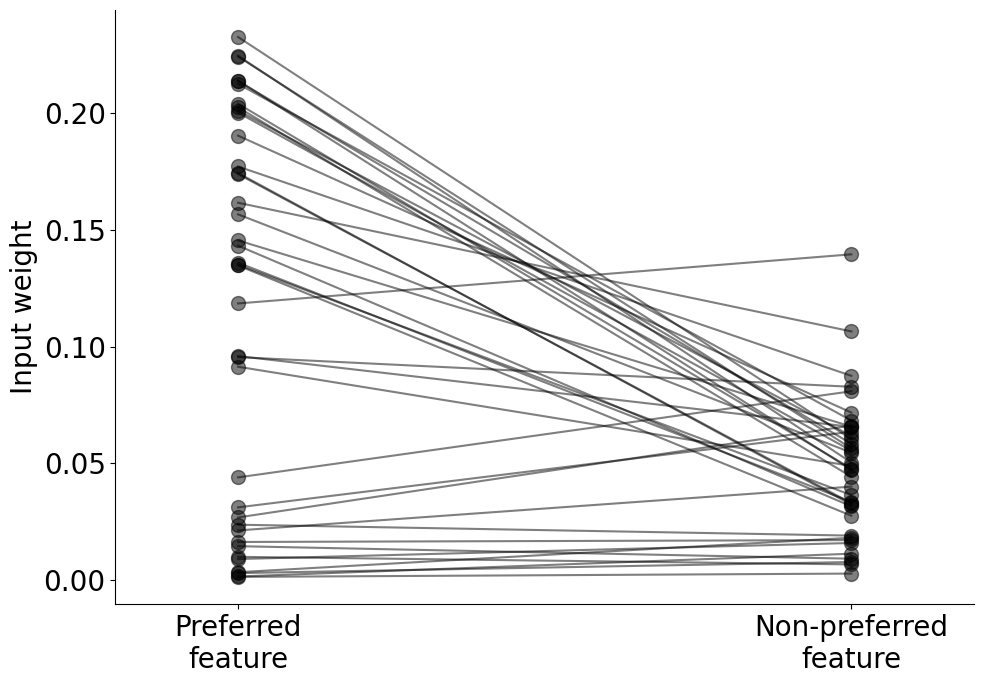

success_2023-05-10-14-28-42_wcst_93_sparsity0
t=6.082229433103142, p-value=3.176810251622704e-08


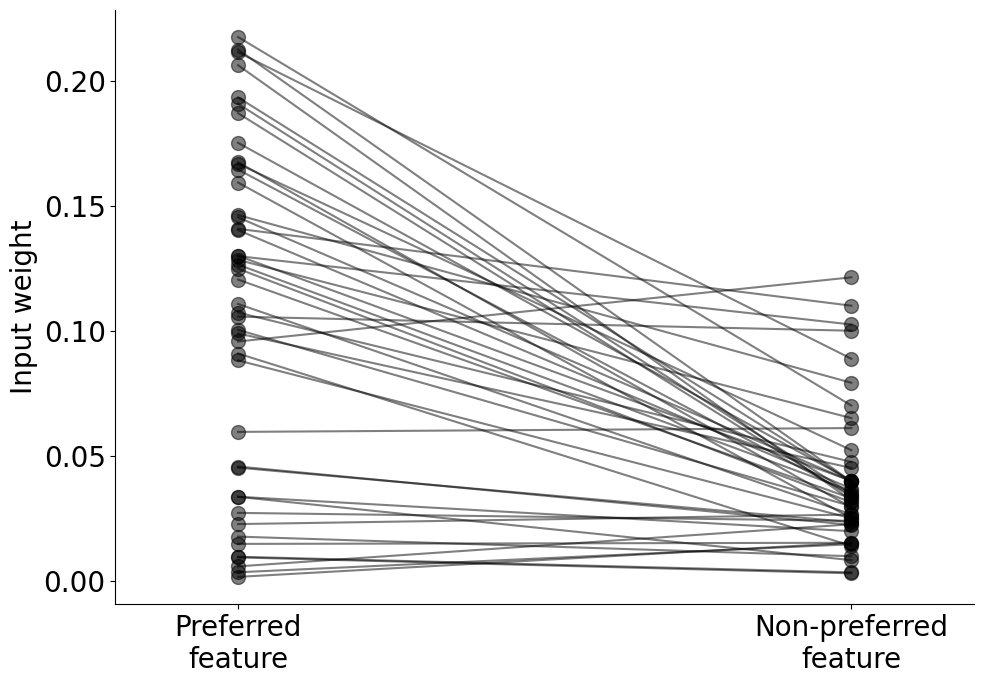

success_2023-05-10-14-28-42_wcst_98_sparsity0
t=5.864175447737932, p-value=1.0318629410207805e-07


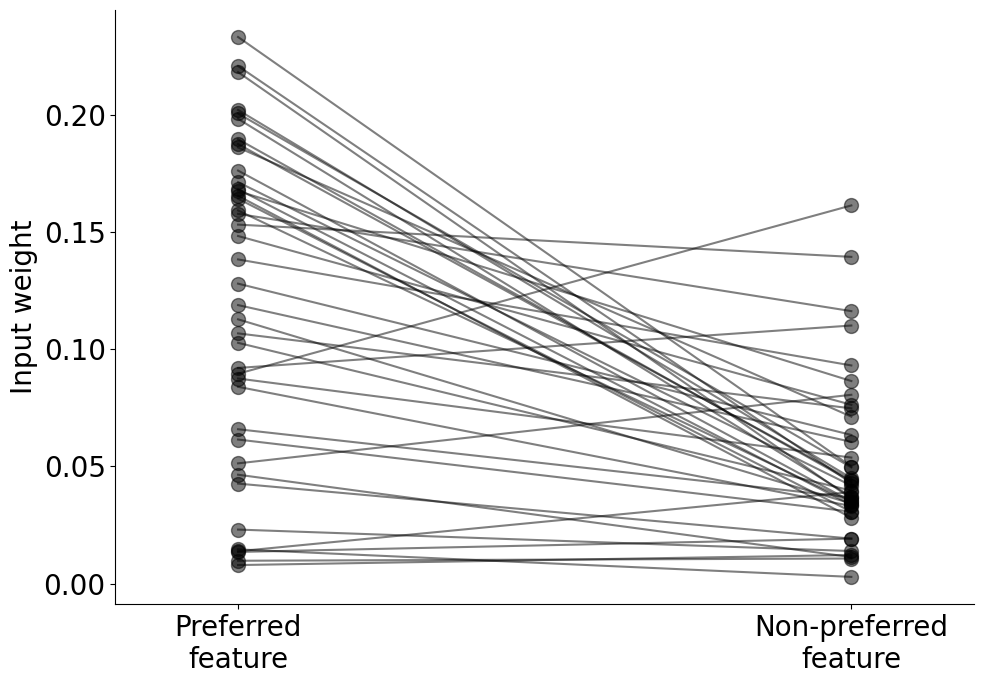

t=50.55693900267122, p-value=0.0


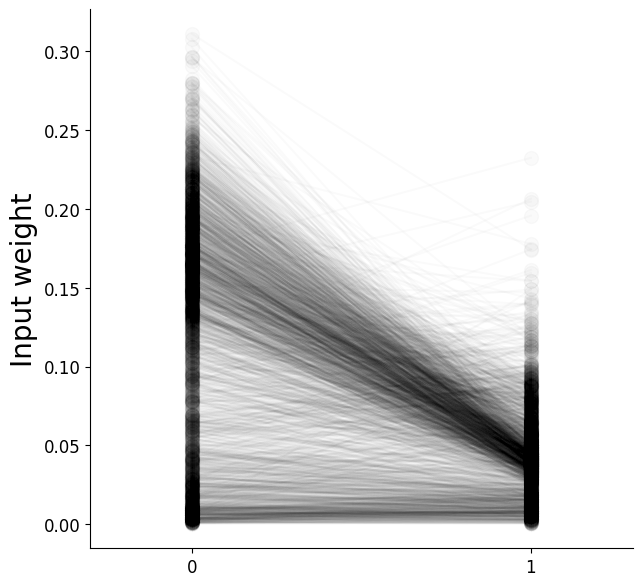

In [12]:

w_in_large_all_models = []
w_in_large_ref_all_models = []
w_in_large_test_all_models = []
w_in_small_all_models = []

data_fig5c = {'big': [], 'small': []}

for data in all_data:
    print(data['model_name'])
    # if data['hp']['dend_nonlinearity']!='divisive_2':
    #     continue
    w_in_larges = []
    w_in_large_refs = []
    w_in_large_tests = []
    w_in_smalls = []
    for r in [1, 2]:
        for choice in [1, 2, 3]:
            for card in ['(0, 0)', '(1, 0)', '(0, 1)', '(1, 1)']:
                neuron_id_rule = data['subcg_sr_idx']['rule{}_sr_esoma'.format(r)]
                neuron_id_choice = data['subcg_sr_idx']['respc{}_sr_esoma'.format(choice)]
                neuron_id_refcard = data['subcg_sr_idx']['ref_card{}_sr_esoma'.format(card)]
                neuron_id = [n for n in neuron_id_rule if (n in neuron_id_choice and n in neuron_id_refcard)]    # all neurons that prefer a given combination of rule, choice and reference card (and therefore feature)        
                if (r==1 and (card=='(0, 0)' or card=='(0, 1)')) or (r==2 and (card=='(0, 0)' or card=='(1, 0)')):
                    feature_id = 0    # this neuron prefers when the matching feature is blue or circle
                else:
                    feature_id = 1    # this neuron prefers when the matching feature is red or square 
#                 input_neuron_id_large = [2*(r-1) + feature_id, 4+4*(choice-1) + 2*(r-1) + feature_id]    # the indices of the input neurons that should have a strong projection to this neuron
                input_neuron_id_large_ref = 2*(r-1) + feature_id
                input_neuron_id_large_test = 4+4*(choice-1) + 2*(r-1) + feature_id
                input_neuron_id_large = [input_neuron_id_large_ref, input_neuron_id_large_test]    # the indices of the input neurons that should have a strong projection to this neuron
                input_neuron_id_small = [i for i in range(data['w_in_eff'].shape[0]) if i not in input_neuron_id_large]
                for n in neuron_id:
                    dend_id = [n + (b+1)*data['n_sr_esoma'] for b in range(data['n_branches'])]    # the dendritic indices
                    w_in_large = data['w_in_eff'][np.ix_(input_neuron_id_large, dend_id)]
                    w_in_small = data['w_in_eff'][np.ix_(input_neuron_id_small, dend_id)]
                    w_in_large_ref = data['w_in_eff'][input_neuron_id_large_ref, dend_id]
                    w_in_large_test = data['w_in_eff'][input_neuron_id_large_test, dend_id]
                    
                    w_in_larges.append(np.mean(w_in_large))
                    w_in_smalls.append(np.mean(w_in_small))
                    w_in_large_refs.append(np.mean(w_in_large_ref))
                    w_in_large_tests.append(np.mean(w_in_large_test))
#                     print(np.mean(w_in_large), np.mean(w_in_small))

    w_in_large_all_models.extend(w_in_larges)
    w_in_large_ref_all_models.extend(w_in_large_refs)
    w_in_large_test_all_models.extend(w_in_large_tests)
    w_in_small_all_models.extend(w_in_smalls)

    if data['model_name'] == 'success_2023-05-10-14-28-42_wcst_106_sparsity0':    # this is the example model shown in figure 5c
        data_fig5c['big'] = w_in_larges
        data_fig5c['small'] = w_in_smalls


#     fig, ax = plt.subplots(figsize=[10,7])
#     fig.patch.set_facecolor('white')
#     for i in range(len(w_in_larges)):
#         ax.plot([w_in_large_refs[i], w_in_large_tests[i], w_in_smalls[i]], marker='o', markersize=10, alpha=0.5, color='k')
#     y = [w_in_large_refs, w_in_large_tests, w_in_smalls]
#     ax.bar([0, 1, 2],
#                height=[np.mean(yi) for yi in y],
#     #            yerr=[np.std(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=['red', 'blue', 'orange'])
#     ax.set_xlim([-0.6, 2.6])
#     ax.set_ylabel(r'Input weight', fontsize=20)
#     ax.set_xticks([0, 1, 2])
#     ax.set_xticklabels(['Preferred feature of\n the reference card', 'Preferred feature of\n the preferred test card', 'Non-preferred feature'], rotation=0, fontsize=12)
#     make_pretty_axes(ax)
#     fig.tight_layout()


    fig, ax = plt.subplots(figsize=[10,7])
    fig.patch.set_facecolor('white')
    for i in range(len(w_in_larges)):
        ax.plot([w_in_larges[i], w_in_smalls[i]], marker='o', markersize=10, alpha=0.5, color='k')
    y = [w_in_larges, w_in_smalls]
    t, p = scipy.stats.ttest_ind(y[0], y[1])
    print('t={}, p-value={}'.format(t, p))
#     ax.bar([0, 1],
#                height=[np.mean(yi) for yi in y],
#     #            yerr=[np.std(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=['blue', 'red'],
#                alpha = 0.5,
#                edgecolor=['white', 'white'])
    ax.set_xlim([-0.2, 1.2])
    ax.set_ylabel(r'Input weight', fontsize=20)
    ax.set_xticks([0, 1])
    ax.set_xticklabels(['Preferred\nfeature', 'Non-preferred\nfeature'], rotation=0, fontsize=20)
    make_pretty_axes(ax)
    fig.tight_layout()
    plt.show()
    
fig, ax = plt.subplots(figsize=[7,7])
fig.patch.set_facecolor('white')
for i in range(len(w_in_large_all_models)):
    ax.plot([w_in_large_all_models[i], w_in_small_all_models[i]], marker='o', markersize=10, alpha=0.02, color='k')
y = [w_in_large_all_models, w_in_small_all_models]
t, p = scipy.stats.ttest_ind(y[0], y[1])
print('t={}, p-value={}'.format(t, p))
# ax.bar([0, 1],
#            height=[np.mean(yi) for yi in y],
# #            yerr=[np.std(yi) for yi in y],    # error bars
#            capsize=12, # error bar cap width in points
#            width=0.5,    # bar width
#            color=(0,0,0,0),
#            edgecolor=['red', 'blue', 'orange'])
ax.set_xlim([-0.3, 1.3])
ax.set_ylabel(r'Input weight', fontsize=20)
ax.set_xticks([0, 1])
make_pretty_axes(ax, labelsize=12)

In [14]:
# save to csv
pd.DataFrame.from_dict(data=data_fig5c, orient='index').to_csv('/home/yl4317/Documents/two_module_rnn/source_data/fig5c.csv', header=False)

# Fig 5d: Output weights

In [16]:
start = time.time()
plt.rc('font', size=12)

all_data_wout = []

for model_name in sorted(os.listdir('/scratch/yl4317/two_module_rnn/saved_models/')):
    if ('2023-05-10' in model_name) and 'wcst' in model_name and 'success' in model_name:
        print(model_name+'\n')
        
#         # load model
        path_to_file = '/scratch/yl4317/two_module_rnn/saved_models/'+model_name
        with HiddenPrints():
            model, hp_test, hp_task_test, optim, saved_data = load_model_v2(path_to_file=path_to_file,model_name=model_name, simple=False, plot=False, toprint=False)
#         if hp_test['dt']!=10:
#             print('pass\n')
#             continue
#         if len(hp_test['cell_group_list'])==2:
#             print('pass\n')
#             continue
#         if hp_test['dend_nonlinearity'] not in ['v2', 'subtract_v2', 'old_v2', 'subtract_v3', 'v3', 'v2_std']:
#             continue
#         if hp_test['no_pfcesoma_to_srsst']==True:
#             continue
#         if hp_test['sparse_srsst_to_sredend']!=0:
#             continue
        
        for key in ['dend_nonlinearity', 'sparse_srsst_to_sredend', 'initialization_weights', 'activation']:
            print(key, hp_test[key])
            
        # make noiseless
#         model.rnn.network_noise = 0
#         hp_test['input_noise_perceptual'] = 0
#         hp_test['input_noise_rule'] = 0
        
        # generate some neural data
#         neural_data = generate_neural_data_test(model=model, n_trials_test=100, switch_every_test=10, to_plot=False, hp_test=hp_test, hp_task_test=hp_task_test, compute_current=False)
        with open('/scratch/yl4317/two_module_rnn/saved_testdata/'+model_name+'_testdata_noiseless_no_current_matrix', 'rb') as f:
            neural_data = pickle.load(f)
        test_data = neural_data['test_data']
        mean_test_perf = np.mean([_[0] for _ in test_data['perfs']])
        if mean_test_perf<=0.8:
            print('perf too low ({}), pass\n'.format(mean_test_perf))
            continue
        rnn_activity = neural_data['rnn_activity'].detach().cpu().numpy()
#         current_matrix = neural_data['current_matrix']
        
        # generate trial labels
        trial_labels = label_trials_wcst(test_data=test_data)
        rule1_trs_stable = trial_labels['rule1_trs_stable']
        rule2_trs_stable = trial_labels['rule2_trs_stable']
        rule1_trs_after_error = trial_labels['rule1_trs_after_error']
        rule2_trs_after_error = trial_labels['rule2_trs_after_error']
        c1_trs_stable = trial_labels['c1_trs_stable']
        c2_trs_stable = trial_labels['c2_trs_stable']
        c3_trs_stable = trial_labels['c3_trs_stable']
        resp_trs_stable = {'c1': c1_trs_stable, 'c2': c2_trs_stable, 'c3': c3_trs_stable}    # to be used as an argument in the "compute_sel_wcst" function
        error_trials = trial_labels['error_trials']
        
        # compute cell selectivity
        all_sels = compute_sel_wcst(rnn_activity=rnn_activity, hp=hp_test, hp_task=hp_task_test, rules=test_data['rules'],
                                         rule1_trs_stable=trial_labels['rule1_trs_stable'], rule2_trs_stable=trial_labels['rule2_trs_stable'],
                                         rule1_trs_after_error = trial_labels['rule1_trs_after_error'], rule2_trs_after_error=trial_labels['rule2_trs_after_error'],
                                         resp_trs_stable = resp_trs_stable, trs_by_center_card=trial_labels['trs_by_center_card_stable'],
                                         stims=test_data['stims'], error_trials=trial_labels['error_trials'], trial_labels=trial_labels)

        # define neuron pools
        subcg_sr_idx = define_subpop_sr_wcst(model=model, hp_task=hp_task_test, hp=hp_test, rnn_activity=rnn_activity, 
                                          rule_sel=all_sels['rule_normalized_activity'], resp_sel=all_sels['resp_normalized'], ref_card_sel=all_sels['ref_card_normalized'],
                                          rule1_trs_stable=rule1_trs_stable, 
                                          rule2_trs_stable=rule2_trs_stable, 
                                          rule_threshold=0, resp_threshold=0)
        for subcg in subcg_sr_idx.keys():
            model.rnn.cg_idx['subcg_sr_'+subcg] = subcg_sr_idx[subcg]
            
        w_out_eff = model.rnn.effective_weight(w=model.rnn.w_out, mask=model.mask_out).detach().cpu().numpy()

        all_data_wout.append({
                              'model': model, 
                              'model_name': model_name, 
                              'hp': hp_test, 
                              'w_out_eff': w_out_eff,
                              'subcg_sr_idx': subcg_sr_idx
                             })
                
print('Elapsed time: {}s'.format(time.time()-start))     

success_2023-05-10-14-28-42_wcst_105_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_106_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_10_sparsity0

dend_nonlinearity subtractive
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_112_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
perf too low (0.0), pass

success_2023-05-10-14-28-42_wcst_115_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
perf too low (0.125), pass

success_2023-05-10-14-28-42_wcst_116_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
succ

success_2023-05-10-14-28-42_wcst_136_sparsity0


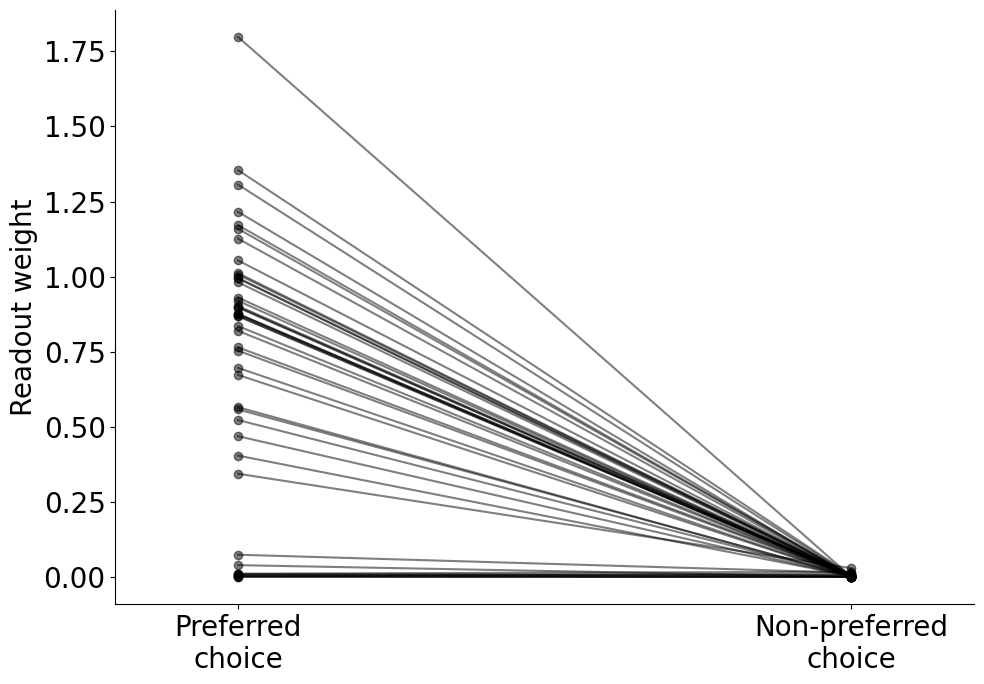

all models


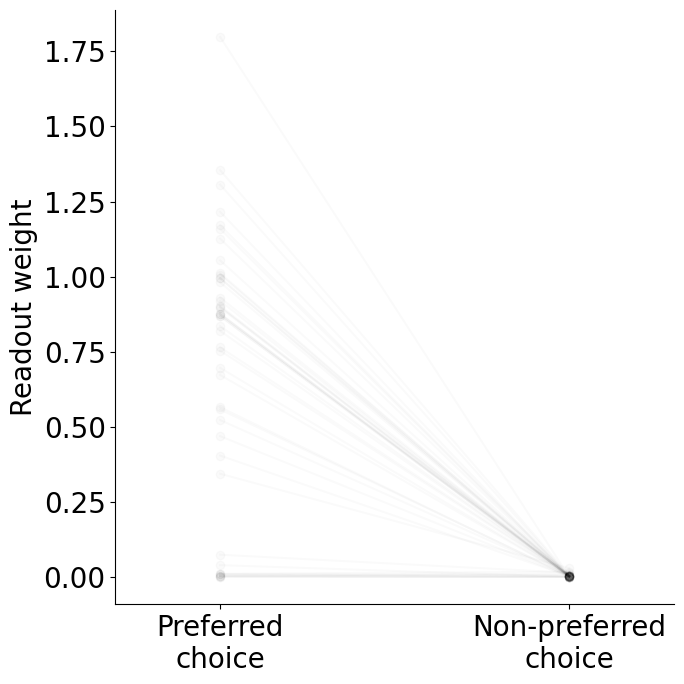

In [21]:
wout_pref_all = []
wout_nonpref_all = []

data_fig5d = {'big': [], 'small': []}

for data in all_data_wout:
    # if data['hp']['dend_nonlinearity']!='divisive_2':
    #     continue
    if data['model_name'] != 'success_2023-05-10-14-28-42_wcst_136_sparsity0':
        continue
    print(data['model_name'])
    wout_pref = []
    wout_nonpref = []
    wout = data['w_out_eff']
    for resp in ['c1', 'c2', 'c3']:
        neuron_idx = data['subcg_sr_idx']['resp{}_sr_esoma'.format(resp)]
        if resp=='c1':
            wout_idx_pref, wout_idx_nonpref = 0, [1, 2]
        elif resp=='c2':
            wout_idx_pref, wout_idx_nonpref = 1, [0, 2]
        elif resp=='c3':
            wout_idx_pref, wout_idx_nonpref = 2, [0, 1]
        wout_pref.extend(wout[neuron_idx, wout_idx_pref])
        wout_nonpref.extend(np.mean(wout[np.ix_(neuron_idx, wout_idx_nonpref)], axis=1))
        wout_pref_all.extend(wout[neuron_idx, wout_idx_pref])
        wout_nonpref_all.extend(np.mean(wout[np.ix_(neuron_idx, wout_idx_nonpref)], axis=1))


    
    if data['model_name'] == 'success_2023-05-10-14-28-42_wcst_136_sparsity0':   # this is the model used in Figure 5d
        data_fig5d['big'].extend(wout_pref)
        data_fig5d['small'].extend(wout_nonpref)

    
        
    fig, ax = plt.subplots(figsize=[10,7])
    fig.patch.set_facecolor('white')
    ax.plot([0, 1], [wout_pref, wout_nonpref], color='k', marker='o', alpha=0.5)
    ax.set_xlim([-0.2, 1.2])
    ax.set_xticks([0, 1])
    ax.set_xticklabels(['Preferred\nchoice', 'Non-preferred\nchoice'], rotation=0)
    ax.set_ylabel('Readout weight', fontsize=20)
    make_pretty_axes(ax)
    fig.tight_layout()
    plt.show()
    
print('all models')
fig, ax = plt.subplots(figsize=[7,7])
fig.patch.set_facecolor('white')
ax.plot([0, 1], [wout_pref_all, wout_nonpref_all], color='k', marker='o', alpha=0.02)
ax.set_xlim([-0.3, 1.3])
ax.set_xticks([0, 1])
ax.set_xticklabels(['Preferred\nchoice', 'Non-preferred\nchoice'], rotation=0)
ax.set_ylabel('Readout weight', fontsize=20)
make_pretty_axes(ax)
fig.tight_layout()
plt.show()

In [23]:
# save to csv
pd.DataFrame.from_dict(data=data_fig5d, orient='index').to_csv('/home/yl4317/Documents/two_module_rnn/source_data/fig5d.csv', header=False)

# Fig 6e-g Compute the connectivity bias between the sensorimotor populations

In [35]:
# whether SR E soma are selective for both rule and response
start = time.time()
plot = False

conn_bias_sr_all_models = []

for model_name in sorted(os.listdir('/scratch/yl4317/two_module_rnn/saved_models/')):
    if ('2023-05-10' in model_name) and 'wcst' in model_name and 'success' in model_name:
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' in model_name:
#     if ('2022-10-24' in model_name) and 'success' in model_name:
        print(model_name)
        
        # load model
        path_to_file = '/scratch/yl4317/two_module_rnn/saved_models/'+model_name
        with HiddenPrints():
            model, hp_test, hp_task_test, optim, saved_data = load_model_v2(path_to_file=path_to_file, model_name=model_name, simple=False, plot=False, toprint=False)
#         print(hp_test['dend_nonlinearity'])
        # add filters here
        if hp_test['dt']!=10:
            continue
        if hp_test['dend_nonlinearity'] not in ['subtractive', 'divisive_2']:
            continue
#         if hp_test['sparse_srsst_to_sredend']!=0:
#             continue
#         if hp_test['no_pfcesoma_to_srsst']==True:
#             continue
        
        for key in ['dend_nonlinearity', 'sparse_srsst_to_sredend', 'initialization_weights', 'activation']:
            print(key, hp_test[key])
            
        # make noiseless
#         model.rnn.network_noise = 0
#         hp_test['input_noise_perceptual'] = 0
#         hp_test['input_noise_rule'] = 0
        
        # generate some neural data
#         neural_data = generate_neural_data_test(model=model, n_trials_test=100, switch_every_test=10, n_switches=5, to_plot=False, hp_test=hp_test, hp_task_test=hp_task_test)
        with open('/scratch/yl4317/two_module_rnn/saved_testdata/{}'.format(model_name+'_testdata_noiseless_no_current_matrix'), 'rb') as f:
            neural_data = pickle.load(f)
        test_data = neural_data['test_data']
        mean_perf = np.mean([_[0] for _ in test_data['perfs']])
        mean_perf_rule = np.mean([_[0] for _ in test_data['perf_rules']])
        if mean_perf<0.8 or mean_perf_rule<0.8:
            print('low performing model ({}/{})'.format(mean_perf, mean_perf_rule))
            continue
        rnn_activity = neural_data['rnn_activity'].detach().cpu().numpy()

        # generate trial labels
        trial_labels = label_trials_wcst(test_data=test_data)
        resp_trs_stable = {'c1': trial_labels['c1_trs_stable'], 'c2': trial_labels['c2_trs_stable'], 'c3': trial_labels['c3_trs_stable']}
        
        # compute cell selectivity
        all_sels = compute_sel_wcst(rnn_activity=rnn_activity, hp=hp_test, hp_task=hp_task_test, rules=test_data['rules'],
                                     rule1_trs_stable=trial_labels['rule1_trs_stable'], rule2_trs_stable=trial_labels['rule2_trs_stable'],
                                     rule1_trs_after_error = trial_labels['rule1_trs_after_error'], rule2_trs_after_error = trial_labels['rule2_trs_after_error'],
                                     resp_trs_stable=resp_trs_stable, trs_by_center_card=trial_labels['trs_by_center_card_stable'],
                                     stims=test_data['stims'], error_trials=trial_labels['error_trials'], trial_labels=trial_labels)
        rule_sel_used= all_sels['rule_normalized_activity']    
        
        
        resp_sel_normalized = all_sels['resp_normalized']
        rule_sel_normalized = all_sels['rule_normalized_activity']

        # subregions
        subcg_sr_idx = define_subpop_sr_wcst(model=model, hp_task=hp_task_test, hp=hp_test, rnn_activity=rnn_activity, 
                                          rule_sel=all_sels['rule_normalized_activity'], resp_sel=all_sels['resp_normalized'], 
                                          ref_card_sel=all_sels['ref_card_normalized'],
                                          rule1_trs_stable=trial_labels['rule1_trs_stable'], 
                                          rule2_trs_stable=trial_labels['rule2_trs_stable'], 
                                          rule_threshold=0.0, resp_threshold=0.0)
    
        # plot connectivity between subpopulations
        w_rec_eff = model.rnn.effective_weight(w=model.rnn.w_rec, mask=model.rnn.mask, w_fix=model.rnn.w_fix).detach().cpu().numpy()
        if plot==True:
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=['rule1_sr_esoma', 'rule2_sr_esoma', 'rule1_sr_pv', 'rule2_sr_pv'], subcg_to_plot_receiver=['rule1_sr_esoma', 'rule2_sr_esoma', 'rule1_sr_pv', 'rule2_sr_pv'])
#             _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=['rule1_sr_pv', 'rule2_sr_pv'], subcg_to_plot_receiver=['rule1_sr_pv', 'rule2_sr_pv'])
#             resp_pops = ['{}_{}'.format(resp, cell) for (resp, cell) in itertools.product(*[['respc1', 'respc2', 'respc3'], ['sr_esoma', 'sr_pv']])]
            resp_pops = ['respc1_sr_esoma', 'respc2_sr_esoma', 'respc3_sr_esoma', 'respc1_sr_pv', 'respc2_sr_pv', 'respc3_sr_pv']
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=resp_pops, subcg_to_plot_receiver=resp_pops)
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=['respc1_sr_pv', 'respc2_sr_pv', 'respc3_sr_pv'], subcg_to_plot_receiver=['respc1_sr_pv', 'respc2_sr_pv', 'respc3_sr_pv'])
#             ref_card_pops = ['ref_card(0, 0)_sr_esoma', 'ref_card(0, 1)_sr_esoma', 'ref_card(1, 0)_sr_esoma', 'ref_card(1, 1)_sr_esoma', 
#                              'ref_card(0, 0)_sr_pv', 'ref_card(0, 1)_sr_pv', 'ref_card(1, 0)_sr_pv', 'ref_card(1, 1)_sr_pv', ]
#             _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=ref_card_pops, subcg_to_plot_receiver=ref_card_pops)
            shared_feature_pops_color = ['blue_sr_esoma', 'red_sr_esoma', 'blue_sr_pv', 'red_sr_pv']
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=shared_feature_pops_color, subcg_to_plot_receiver=shared_feature_pops_color)
            shared_feature_pops_shape = ['circle_sr_esoma', 'triangle_sr_esoma', 'circle_sr_pv', 'triangle_sr_pv']
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=shared_feature_pops_shape, subcg_to_plot_receiver=shared_feature_pops_shape)
            
        
        
        
        
        # compute connectivity bias for rule
        conn_bias_rulee_rulee = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule1_sr_esoma'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule2_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule2_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule1_sr_esoma'])])
        conn_bias_rulee_rulepv = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule1_sr_pv'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule2_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule2_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule1_sr_pv'])])
        conn_bias_rulepv_rulee = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule2_sr_esoma'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule1_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule1_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule2_sr_esoma'])])
        conn_bias_rulepv_rulee = -conn_bias_rulepv_rulee
        conn_bias_rulepv_rulepv = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule2_sr_pv'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule1_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule1_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule2_sr_pv'])])
        conn_bias_rulepv_rulepv = -conn_bias_rulepv_rulepv
        
                     
            
            
        # connectivity bias based on neurons preferring different responses              
        conn = {}
        conn[('resp_sr_esoma', 'resp_sr_esoma')] = {}
        conn[('resp_sr_esoma', 'resp_sr_pv')] = {}
        conn[('resp_sr_pv', 'resp_sr_esoma')] = {}
        conn[('resp_sr_pv', 'resp_sr_pv')] = {}
        for key in conn.keys():
            for x in ['same', 'cross']:
                conn[key][x] = []
        
        for resp1 in ['c1', 'c2', 'c3']:
            for resp2 in ['c1', 'c2', 'c3']:
                if resp1==resp2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('resp_{}'.format(sender), 'resp_{}'.format(receiver))]['same'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['resp{}_{}'.format(resp1, sender)], subcg_sr_idx['resp{}_{}'.format(resp2, receiver)])]))
                elif resp1!=resp2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('resp_{}'.format(sender), 'resp_{}'.format(receiver))]['cross'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['resp{}_{}'.format(resp1, sender)], subcg_sr_idx['resp{}_{}'.format(resp2, receiver)])]))     
                        
        conn_bias_respe_respe = np.mean(conn[('resp_sr_esoma', 'resp_sr_esoma')]['same']) - np.mean(conn[('resp_sr_esoma', 'resp_sr_esoma')]['cross'])
        conn_bias_respe_resppv = np.mean(conn[('resp_sr_esoma', 'resp_sr_pv')]['same']) - np.mean(conn[('resp_sr_esoma', 'resp_sr_pv')]['cross'])
        conn_bias_resppv_respe = - (np.mean(conn[('resp_sr_pv', 'resp_sr_esoma')]['cross']) - np.mean(conn[('resp_sr_pv', 'resp_sr_esoma')]['same']))
        conn_bias_resppv_resppv = - (np.mean(conn[('resp_sr_pv', 'resp_sr_pv')]['cross']) - np.mean(conn[('resp_sr_pv', 'resp_sr_pv')]['same']))
        
        
        
        
        # connectivity bias based on neurons preferring different reference cards
        conn = {}
        conn[('ref_card_sr_esoma', 'ref_card_sr_esoma')] = {}
        conn[('ref_card_sr_esoma', 'ref_card_sr_pv')] = {}
        conn[('ref_card_sr_pv', 'ref_card_sr_esoma')] = {}
        conn[('ref_card_sr_pv', 'ref_card_sr_pv')] = {}
        for key in conn.keys():
            for x in ['same', 'cross']:
                conn[key][x] = []
            
        for ref_card1 in [(0, 0), (0, 1), (1, 0), (1, 1)]:
            for ref_card2 in [(0, 0), (0, 1), (1, 0), (1, 1)]:
                if ref_card1==ref_card2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('ref_card_{}'.format(sender), 'ref_card_{}'.format(receiver))]['same'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['ref_card{}_{}'.format(ref_card1, sender)], subcg_sr_idx['ref_card{}_{}'.format(ref_card2, receiver)])]))
                elif ref_card1!=ref_card2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('ref_card_{}'.format(sender), 'ref_card_{}'.format(receiver))]['cross'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['ref_card{}_{}'.format(ref_card1, sender)], subcg_sr_idx['ref_card{}_{}'.format(ref_card2, receiver)])]))     
                        
        conn_bias_ref_card_e_ref_card_e = np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_esoma')]['same']) - np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_esoma')]['cross'])
        conn_bias_ref_card_e_ref_card_pv = np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_pv')]['same']) - np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_pv')]['cross'])
        conn_bias_ref_card_pv_ref_card_e = - (np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_esoma')]['cross']) - np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_esoma')]['same']))
        conn_bias_ref_card_pv_ref_card_pv = - (np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_pv')]['cross']) - np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_pv')]['same']))
        
        
        # connectivity bias based on neurons preferring different reference cards
        conn = {}
        conn[('shared_feature_sr_esoma', 'shared_feature_sr_esoma')] = {}
        conn[('shared_feature_sr_esoma', 'shared_feature_sr_pv')] = {}
        conn[('shared_feature_sr_pv', 'shared_feature_sr_esoma')] = {}
        conn[('shared_feature_sr_pv', 'shared_feature_sr_pv')] = {}
        for key in conn.keys():
            for x in ['same', 'cross']:
                conn[key][x] = []
        
        shared_features = ['blue', 'red', 'circle', 'triangle']
        for f1 in shared_features:
            for f2 in shared_features:
                for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                    mean_weight = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['{}_{}'.format(f1, sender)], subcg_sr_idx['{}_{}'.format(f2, receiver)])])
                    if f1==f2:
                        conn[('shared_feature_{}'.format(sender), 'shared_feature_{}'.format(receiver))]['same'].append(mean_weight)
                    elif f1!=f2 and shared_features.index(f1)//2 == shared_features.index(f2)//2:    # do not include for example f1=blue and f2=square
                        conn[('shared_feature_{}'.format(sender), 'shared_feature_{}'.format(receiver))]['cross'].append(mean_weight)     
                        
        conn_bias_shared_feature_e_e = np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_esoma')]['same']) - np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_esoma')]['cross'])
        conn_bias_shared_feature_e_pv = np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_pv')]['same']) - np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_pv')]['cross'])
        conn_bias_shared_feature_pv_e = - (np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_esoma')]['cross']) - np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_esoma')]['same']))
        conn_bias_shared_feature_pv_pv = - (np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_pv')]['cross']) - np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_pv')]['same']))
        
        
        
        
        
        conn_bias_sr_all_models.append({'model': model_name, 
                                        'hp': hp_test,
                                        'bias_ruleesoma_ruleesoma': conn_bias_rulee_rulee, 
                                        'bias_ruleesoma_rulepv': conn_bias_rulee_rulepv, 
                                        'bias_rulepv_ruleesoma': conn_bias_rulepv_rulee, 
                                        'bias_rulepv_rulepv': conn_bias_rulepv_rulepv,
                                        'bias_respesoma_respesoma': conn_bias_respe_respe, 
                                        'bias_respesoma_resppv': conn_bias_respe_resppv, 
                                        'bias_resppv_respesoma': conn_bias_resppv_respe, 
                                        'bias_resppv_resppv': conn_bias_resppv_resppv,
                                        'bias_ref_card_esoma_ref_card_esoma': conn_bias_ref_card_e_ref_card_e, 
                                        'bias_ref_card_esoma_ref_card_pv': conn_bias_ref_card_e_ref_card_pv, 
                                        'bias_ref_card_pv_ref_card_esoma': conn_bias_ref_card_pv_ref_card_e, 
                                        'bias_ref_card_pv_ref_card_pv': conn_bias_ref_card_pv_ref_card_pv,
                                        'bias_shared_feature_esoma_esoma': conn_bias_shared_feature_e_e, 
                                        'bias_shared_feature_esoma_pv': conn_bias_shared_feature_e_pv, 
                                        'bias_shared_feature_pv_esoma': conn_bias_shared_feature_pv_e, 
                                        'bias_shared_feature_pv_pv': conn_bias_shared_feature_pv_pv,
                                       })
        # print('biases: {}'.format(conn_bias_sr_all_models[-1][2:]))

print(time.time()-start)

success_2023-05-10-14-28-42_wcst_105_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu


/home/yl4317/Documents/two_module_rnn/code/functions.py:2582: RuntimeWarning: invalid value encountered in divide
  rule_sel_across_time[n] = (act_rule1_time - act_rule2_time)/(np.abs(act_rule1_time) + np.abs(act_rule2_time))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2592: RuntimeWarning: invalid value encountered in scalar divide
  rule_sel_fdbk = (act_rule1_fdbk - act_rule2_fdbk)/(np.abs(act_rule1_fdbk) + np.abs(act_rule2_fdbk))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2596: RuntimeWarning: invalid value encountered in scalar divide
  rule_sel_iti = (act_rule1_iti - act_rule2_iti)/(np.abs(act_rule1_iti) + np.abs(act_rule2_iti))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2600: RuntimeWarning: invalid value encountered in scalar divide
  rule_sel_ref_card = (act_rule1_ref_card - act_rule2_ref_card)/(np.abs(act_rule1_ref_card) + np.abs(act_rule2_ref_card))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2604: RuntimeWarning: invalid valu

success_2023-05-10-14-28-42_wcst_106_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu


/ext3/miniconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/ext3/miniconda3/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


success_2023-05-10-14-28-42_wcst_10_sparsity0
dend_nonlinearity subtractive
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_112_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
low performing model (0.0/0.0)
success_2023-05-10-14-28-42_wcst_115_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
low performing model (0.125/0.02500000037252903)
success_2023-05-10-14-28-42_wcst_116_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_118_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_121_sparsity0
dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal


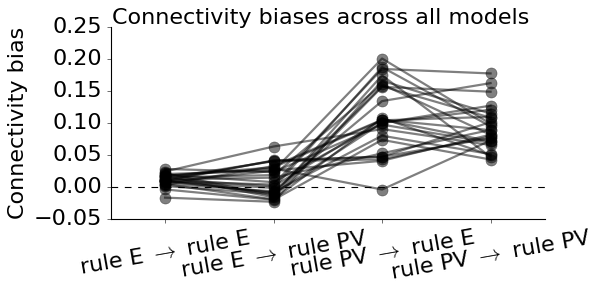

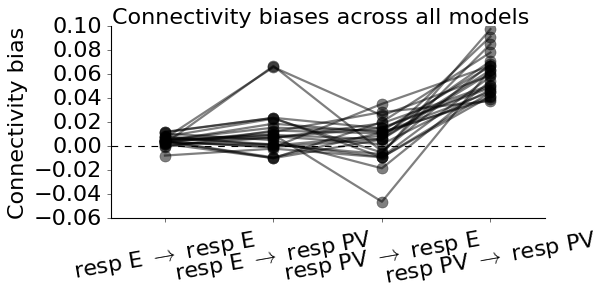

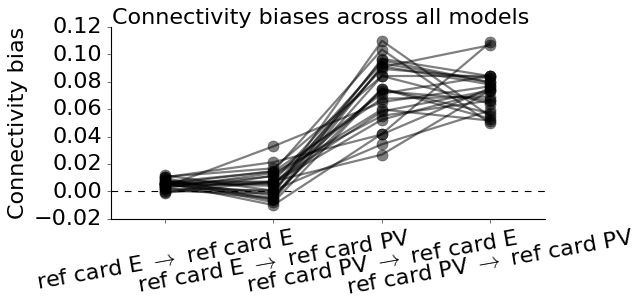

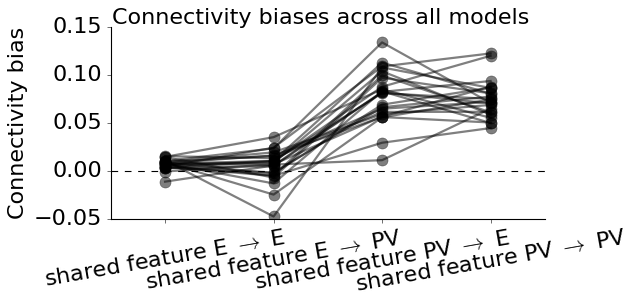

In [37]:
data_fig7e = {'exc_exc': [], 'exc_pv': [], 'pv_exc': [], 'pv_pv': []}    # connectivity biases between rule-selective populations
data_fig7f = {'exc_exc': [], 'exc_pv': [], 'pv_exc': [], 'pv_pv': []}    # connectivity biases between response location-selective populations
data_fig7g = {'exc_exc': [], 'exc_pv': [], 'pv_exc': [], 'pv_pv': []}    # connectivity biases between shared feature-selective populations

fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['subtractive']:
        continue
    data = list(x.values())[2:6]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue

    data_fig7e['exc_exc'].append(data[0])
    data_fig7e['exc_pv'].append(data[1])
    data_fig7e['pv_exc'].append(data[2])
    data_fig7e['pv_pv'].append(data[3])

    
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'rule E $\rightarrow$ rule E', r'rule E $\rightarrow$ rule PV', r'rule PV $\rightarrow$ rule E', r'rule PV $\rightarrow$ rule PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()



fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['subtractive']:
        continue
    data = list(x.values())[6:10]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue


    data_fig7f['exc_exc'].append(data[0])
    data_fig7f['exc_pv'].append(data[1])
    data_fig7f['pv_exc'].append(data[2])
    data_fig7f['pv_pv'].append(data[3])

    
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'resp E $\rightarrow$ resp E', r'resp E $\rightarrow$ resp PV', r'resp PV $\rightarrow$ resp E', r'resp PV $\rightarrow$ resp PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()


fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['subtractive']:
        continue
    data = list(x.values())[10:14]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue
    
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'ref card E $\rightarrow$ ref card E', r'ref card E $\rightarrow$ ref card PV', r'ref card PV $\rightarrow$ ref card E', r'ref card PV $\rightarrow$ ref card PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()


fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['subtractive']:
        continue
    data = list(x.values())[14:18]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue


    data_fig7g['exc_exc'].append(data[0])
    data_fig7g['exc_pv'].append(data[1])
    data_fig7g['pv_exc'].append(data[2])
    data_fig7g['pv_pv'].append(data[3])



    
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'shared feature E $\rightarrow$ E', r'shared feature E $\rightarrow$ PV', r'shared feature PV $\rightarrow$ E', r'shared feature PV $\rightarrow$ PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()
    

In [39]:
# save to csv
pd.DataFrame.from_dict(data=data_fig7e, orient='index').to_csv('/home/yl4317/Documents/two_module_rnn/source_data/fig7e.csv', header=False)
pd.DataFrame.from_dict(data=data_fig7f, orient='index').to_csv('/home/yl4317/Documents/two_module_rnn/source_data/fig7f.csv', header=False)
pd.DataFrame.from_dict(data=data_fig7g, orient='index').to_csv('/home/yl4317/Documents/two_module_rnn/source_data/fig7g.csv', header=False)

# Below is not used in paper

# If a neuron is selected for card C, then it should receive more input about card C features (or should it?)

/state/partition1/job-39703347/ipykernel_487645/1663377493.py:42: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[0].set_yticklabels(np.round(ax[0].get_yticks(), 2), fontsize=15)
/state/partition1/job-39703347/ipykernel_487645/1663377493.py:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[1].set_yticklabels(np.round(ax[1].get_yticks(), 2), fontsize=15)


wilconxon test, p=WilcoxonResult(statistic=2564.0, pvalue=0.9888086957712957)


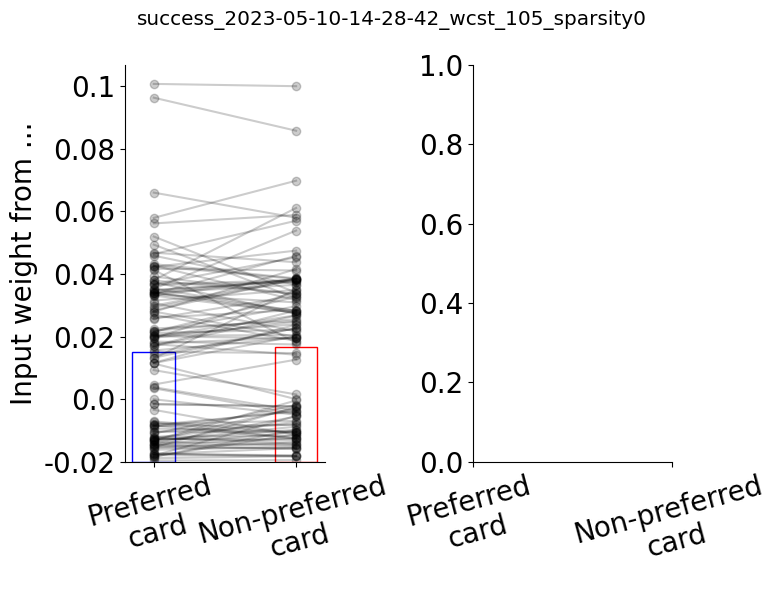

wilconxon test, p=WilcoxonResult(statistic=1898.0, pvalue=0.8964135810504813)


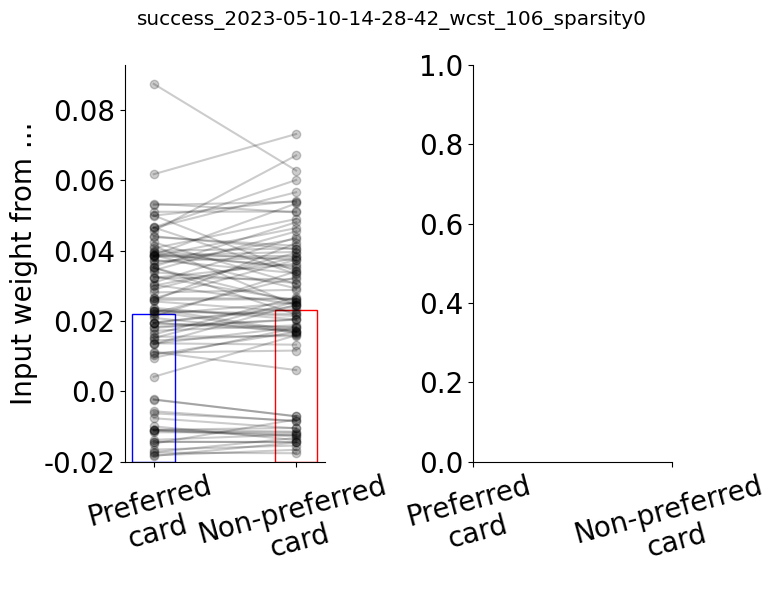

wilconxon test, p=WilcoxonResult(statistic=3585.0, pvalue=0.009079958462591372)


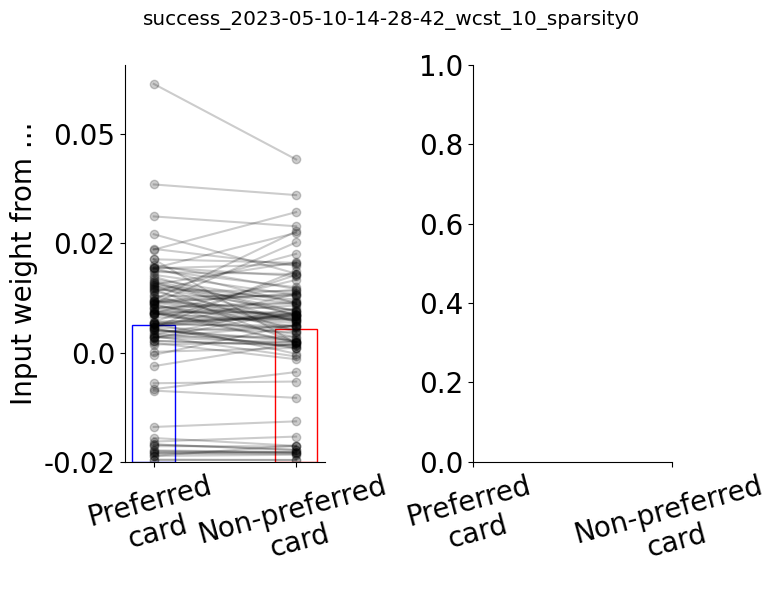

wilconxon test, p=WilcoxonResult(statistic=1729.0, pvalue=0.9856991149761627)


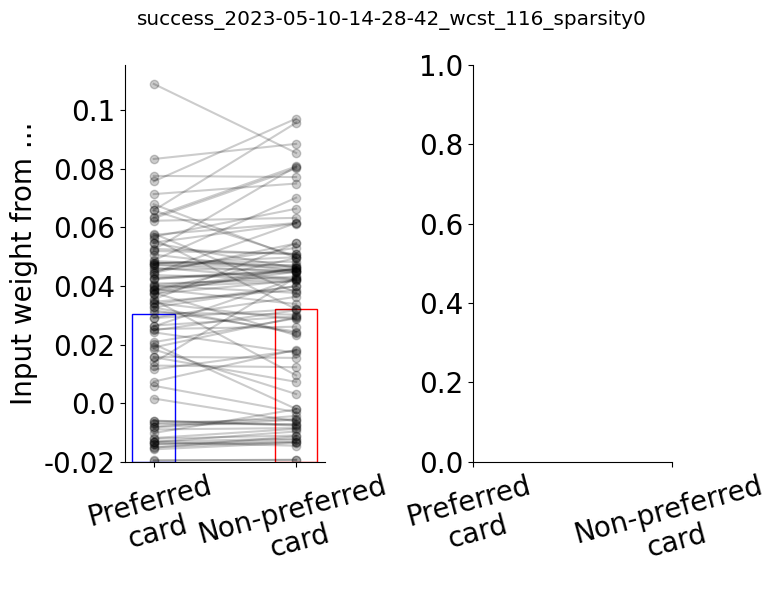

wilconxon test, p=WilcoxonResult(statistic=2536.0, pvalue=0.995564298029365)


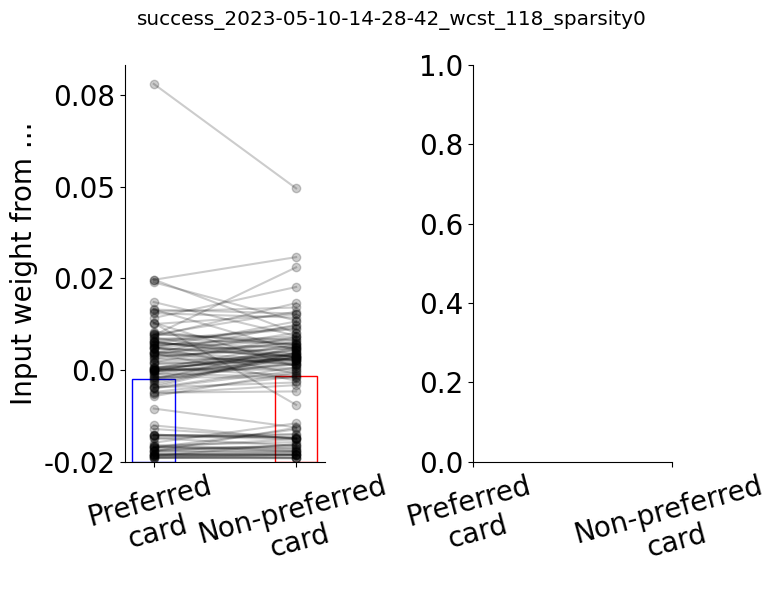

wilconxon test, p=WilcoxonResult(statistic=3639.0, pvalue=0.6131111225051179)


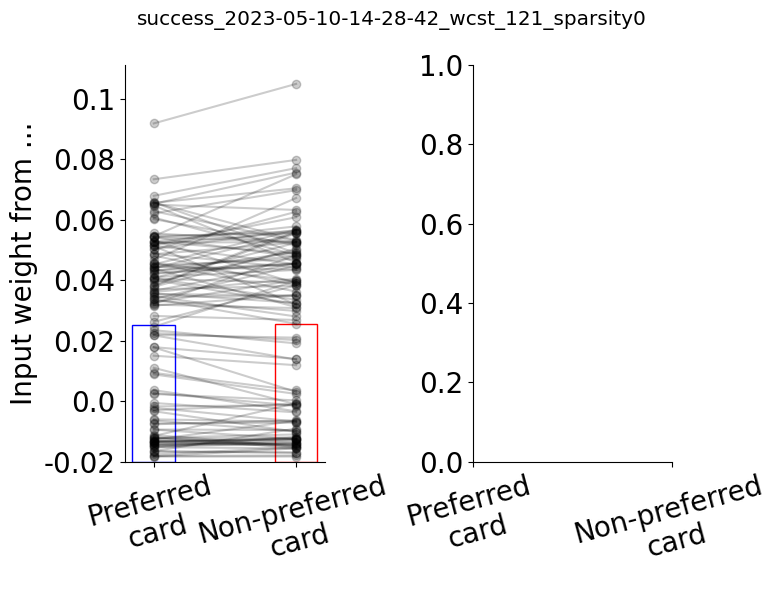

wilconxon test, p=WilcoxonResult(statistic=2486.0, pvalue=0.9986322061567985)


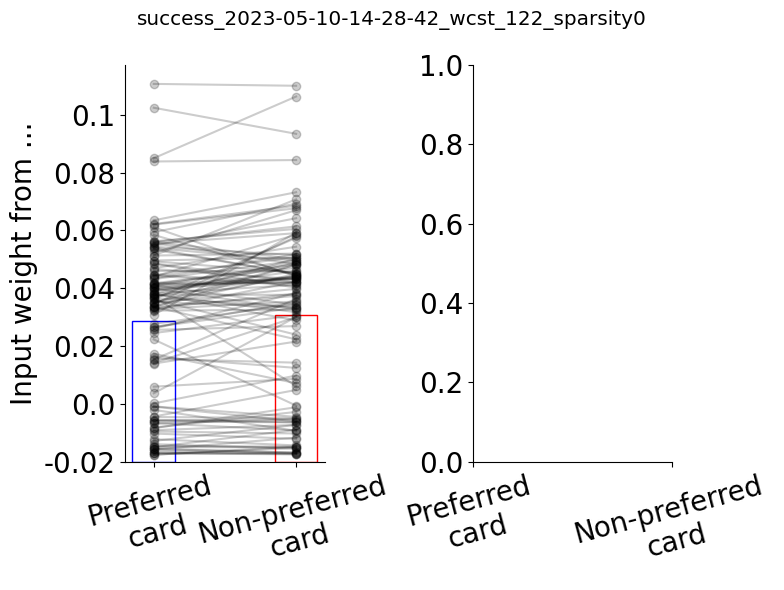

wilconxon test, p=WilcoxonResult(statistic=2038.0, pvalue=0.9999616243514973)


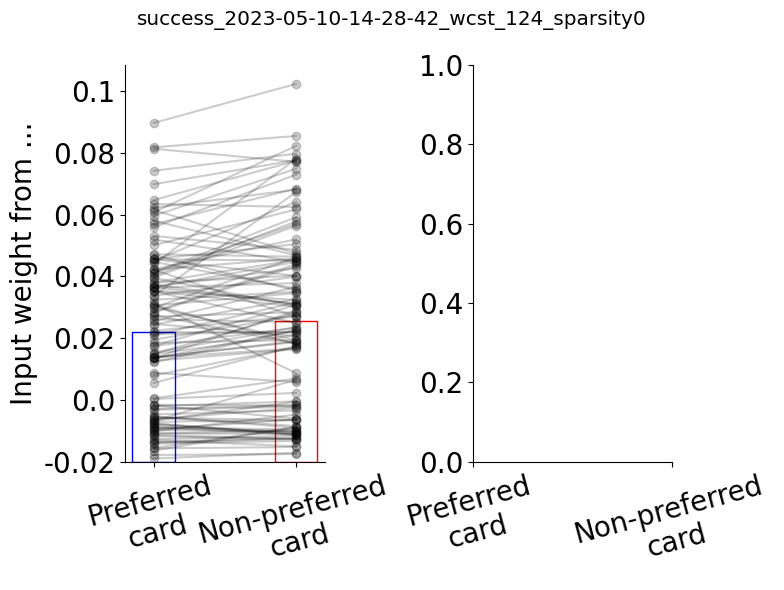

wilconxon test, p=WilcoxonResult(statistic=1390.0, pvalue=0.9999990328302256)


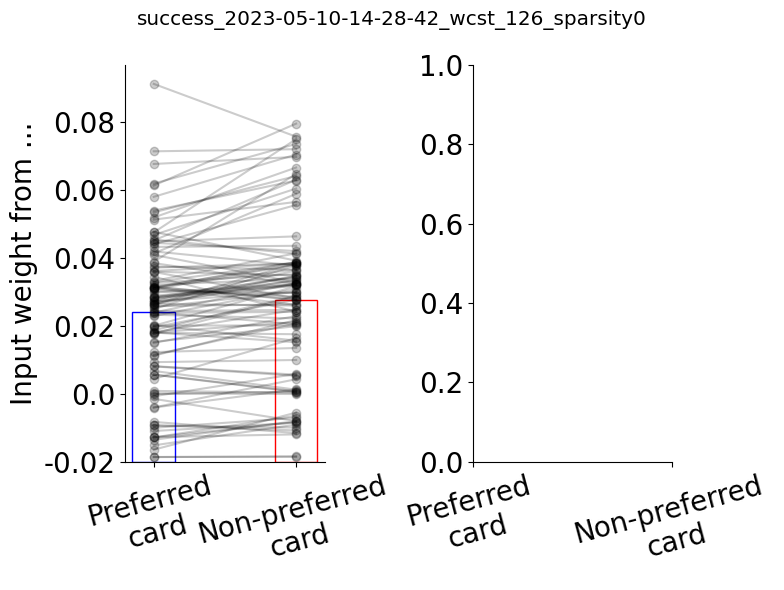

wilconxon test, p=WilcoxonResult(statistic=1012.0, pvalue=0.978458636253692)


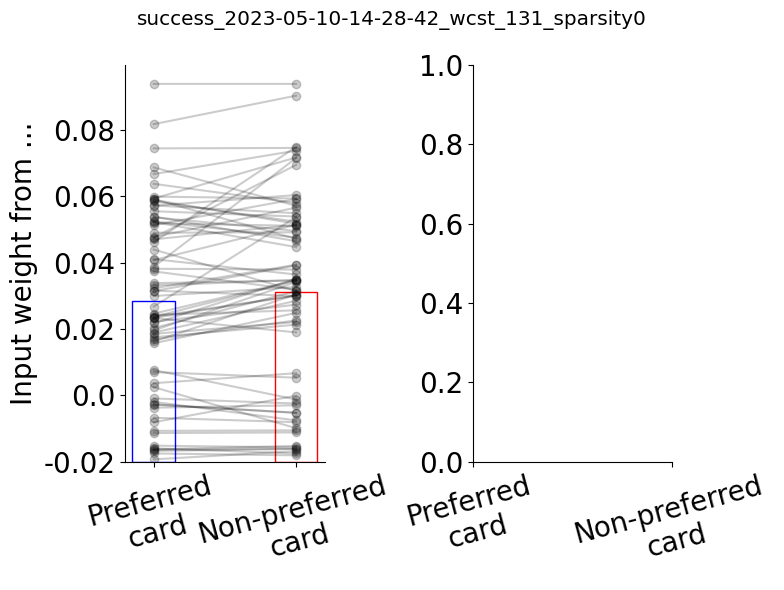

wilconxon test, p=WilcoxonResult(statistic=1505.0, pvalue=0.9997734831934122)


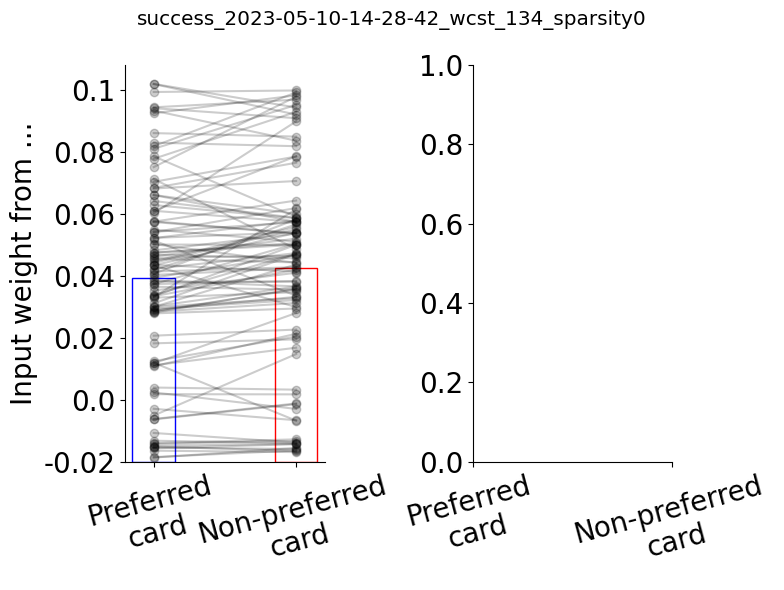

wilconxon test, p=WilcoxonResult(statistic=1047.0, pvalue=0.9999715970386994)


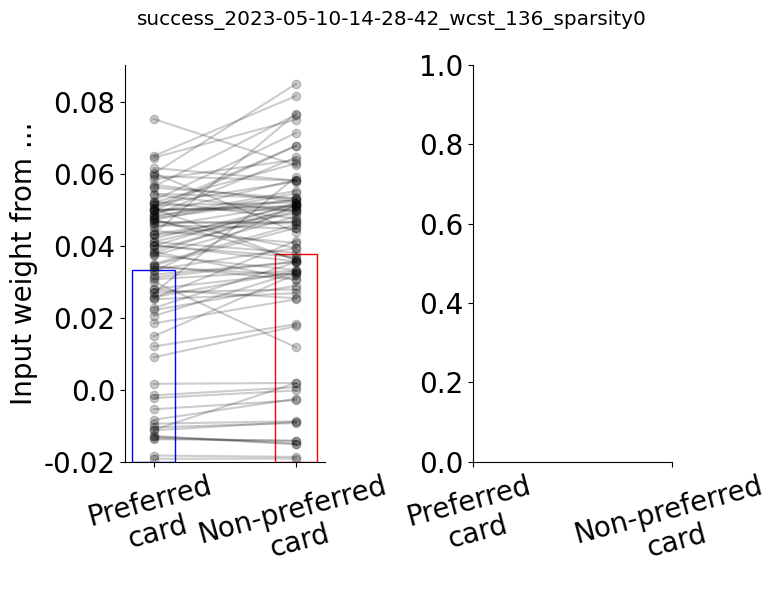

wilconxon test, p=WilcoxonResult(statistic=2584.0, pvalue=0.9993575614022954)


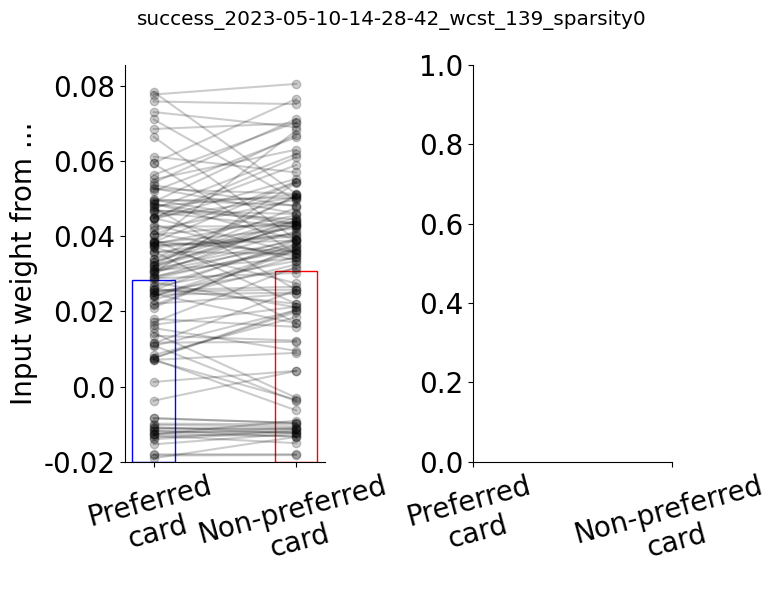

wilconxon test, p=WilcoxonResult(statistic=1336.0, pvalue=0.9773812828983175)


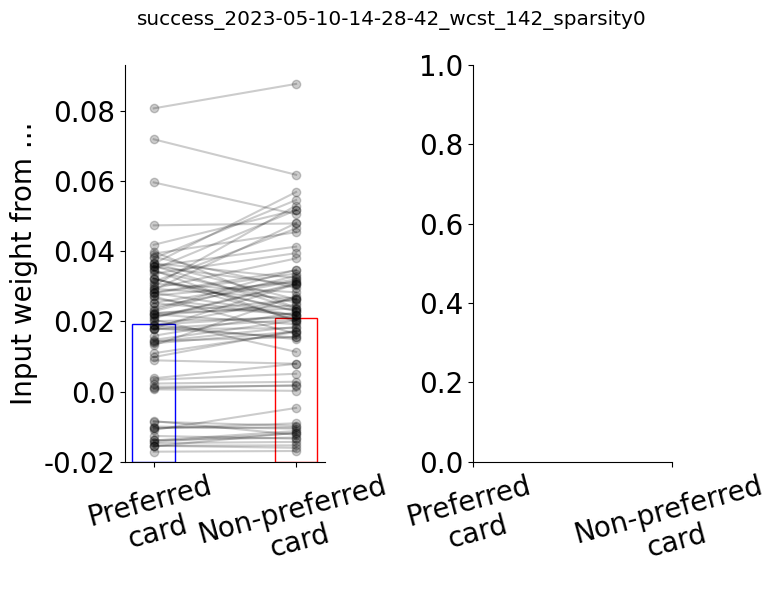

wilconxon test, p=WilcoxonResult(statistic=2165.0, pvalue=0.9996415282306572)


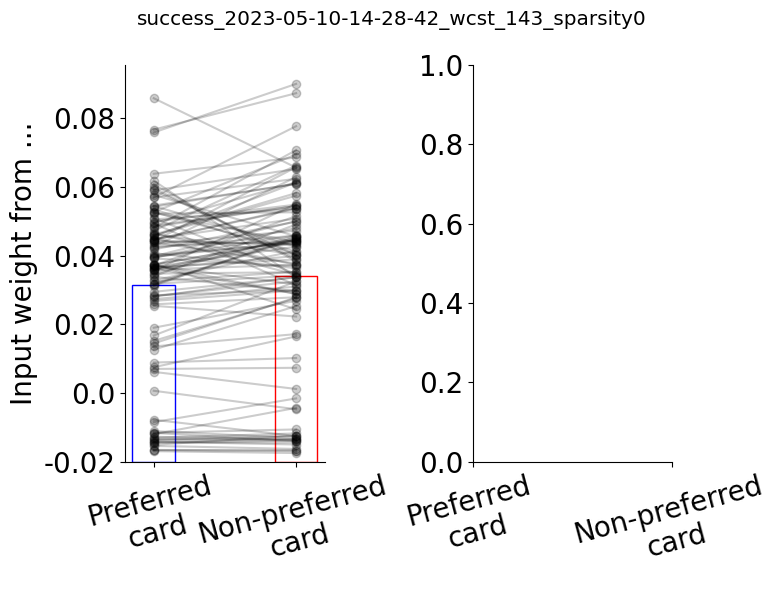

KeyboardInterrupt: 

<Figure size 800x600 with 0 Axes>

In [12]:
# plot each model separately

from scipy import stats

plt.rc('font', size=12)

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

   

for data in all_data:
#     print(data['hp']['dend_nonlinearity'])
#     if data['hp']['dend_nonlinearity']!='subtractive':
#         continue

    inp_prefer_card_soma = []    # input weight from features of the preferred test card
    inp_nonprefer_card_soma = [] 
    
    for c in range(n_test_cards):
        test_prefer_card_idx = np.arange((c+1)*n_total_f, (c+2)*n_total_f)
        test_nonprefer_card_idx = [x for x in np.arange(n_total_f, (n_test_cards+1)*n_total_f)]
        
        for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(c+1)]:
            for b in range(data['n_branches']):
                dend_idx = n + (b+1)*data['n_sr_esoma']
                inp_prefer_card_soma.append(np.mean(data['w_in_eff'][test_prefer_card_idx, dend_idx]))
                inp_nonprefer_card_soma.append(np.mean(data['w_in_eff'][test_nonprefer_card_idx, dend_idx]))
    
    fig, ax = plt.subplots(1, 2, figsize=[8, 6])
    fig.patch.set_facecolor('white')
    fig.suptitle(data['model_name'])
    
    for x in range(len(inp_prefer_card_soma)):
        ax[0].plot([inp_prefer_card_soma[x], inp_nonprefer_card_soma[x]], marker='o', alpha=0.2, color='k')
    ax[0].set_ylabel('Input weight from ...', fontsize=20)
    ax[0].set_xticks([0, 1])
    ax[0].set_xticklabels(['Preferred\ncard', 'Non-preferred\ncard'], rotation=15, fontsize=15)
    ax[0].set_xlim([-0.2, 1.2])
    ax[0].set_yticklabels(np.round(ax[0].get_yticks(), 2), fontsize=15)
    make_pretty_axes(ax[0])
    
    print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_card_soma, y=inp_nonprefer_card_soma, alternative='greater')))
    
    y = [inp_prefer_card_soma, inp_nonprefer_card_soma]
    ax[0].bar([0, 1],
               height=[np.mean(yi) for yi in y],
#                yerr=[stats.sem(yi) for yi in y],    # error bars
               capsize=12, # error bar cap width in points
               width=0.3,    # bar width
               color=(0,0,0,0),
               edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
              )
    ax[1].set_ylabel('')
    ax[1].set_xticks([0, 1])
    ax[1].set_xticklabels(['Preferred\ncard', 'Non-preferred\ncard'], rotation=15, fontsize=15)
    ax[1].set_yticklabels(np.round(ax[1].get_yticks(), 2), fontsize=15)
    make_pretty_axes(ax[1])

#     for x in range(len(inp_prefer_rule_soma_test)):
#         ax[0, 2].plot([inp_prefer_rule_soma_test[x], inp_nonprefer_rule_soma_test[x]], marker='o', alpha=0.2, color='k')
#     ax[0, 2].set_ylabel('Input weight for test card features')
#     ax[0, 2].set_xticks([0, 1])
#     ax[0, 2].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=45)
#     ax[0, 2].set_xlim([-0.2, 1.2])
#     print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_soma_test, y=inp_nonprefer_rule_soma_test, alternative='greater')))
    
#     y = [inp_prefer_rule_dend_test, inp_nonprefer_rule_dend_test]
#     ax[0, 3].bar([0, 1],
#                height=[np.mean(yi) for yi in y],
#                yerr=[stats.sem(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#               )
#     ax[0, 3].set_ylabel('')
#     ax[0, 3].set_xticks([0, 1])
#     ax[0, 3].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=45)
#     fig.tight_layout()
#     plt.show()
    
#     for x in range(len(inp_prefer_rule_dend_center)):
#         ax[1, 0].plot([inp_prefer_rule_dend_center[x], inp_nonprefer_rule_dend_center[x]], marker='o', alpha=0.2, color='k')
#     ax[1, 0].set_ylabel('Input weight for center card features')
#     ax[1, 0].set_xticks([0, 1])
#     ax[1, 0].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=45)
#     ax[1, 0].set_xlim([-0.2, 1.2])
#     print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_dend_center, y=inp_nonprefer_rule_dend_center, alternative='greater')))
    
#     y = [inp_prefer_rule_dend_center, inp_nonprefer_rule_dend_center]
#     ax[1, 1].bar([0, 1],
#                height=[np.mean(yi) for yi in y],
#                yerr=[stats.sem(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#               )
#     ax[1, 1].set_ylabel('')
#     ax[1, 1].set_xticks([0, 1])
#     ax[1, 1].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=45)

#     for x in range(len(inp_prefer_rule_dend_test)):
#         ax[1, 2].plot([inp_prefer_rule_dend_test[x], inp_nonprefer_rule_dend_test[x]], marker='o', alpha=0.2, color='k')
#     ax[1, 2].set_ylabel('Input weight for test card features')
#     ax[1, 2].set_xticks([0, 1])
#     ax[1, 2].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=45)
#     ax[1, 2].set_xlim([-0.2, 1.2])
#     print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_dend_test, y=inp_nonprefer_rule_dend_test, alternative='greater')))
    
#     y = [inp_prefer_rule_dend_test, inp_nonprefer_rule_dend_test]
#     ax[1, 3].bar([0, 1],
#                height=[np.mean(yi) for yi in y],
#                yerr=[stats.sem(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#               )
#     ax[1, 3].set_ylabel('')
#     ax[1, 3].set_xticks([0, 1])
#     ax[1, 3].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=45)
    fig.tight_layout()
    plt.show()

In [ ]:
# plot all models

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

inp_prefer_card_soma = []    # input weight from features of the preferred test card
inp_nonprefer_card_soma = [] 

for data in all_data:
#     print(data['hp']['dend_nonlinearity'])
#     if data['hp']['dend_nonlinearity']!=dend_nonlinear:
#         continue
#     if data['hp']['sparse_srsst_to_sredend']!= sparsity_sst_edend:
#         continue
    
    for c in range(n_test_cards):
        test_prefer_card_idx = np.arange((c+1)*n_total_f, (c+2)*n_total_f)
        test_nonprefer_card_idx = [x for x in np.arange(n_total_f, (n_test_cards+1)*n_total_f)]
        
        for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(c+1)]:
            for b in range(data['n_branches']):
                dend_idx = n + (b+1)*data['n_sr_esoma']
                inp_prefer_card_soma.append(np.mean(data['w_in_eff'][test_prefer_card_idx, dend_idx]))
                inp_nonprefer_card_soma.append(np.mean(data['w_in_eff'][test_nonprefer_card_idx, dend_idx]))
    
fig, ax = plt.subplots(1, 2, figsize=[8, 7])
fig.patch.set_facecolor('white')
fig.suptitle('All models')

for x in range(len(inp_prefer_card_soma)):
    ax[0].plot([inp_prefer_card_soma[x], inp_nonprefer_card_soma[x]], marker='o', alpha=0.2, color='k')
print('p={}'.format(wilcoxon(x=inp_prefer_card_soma, y=inp_nonprefer_card_soma, alternative='greater')))
ax[0].set_ylabel('Input weight from ...', fontsize=20)
ax[0].set_xticks([0, 1])
ax[0].set_xticklabels(['Preferred\ncard', 'Non-preferred\ncard'], rotation=15, fontsize=15)
ax[0].set_xlim([-0.2, 1.2])
ax[0].set_yticklabels(np.round(ax[0].get_yticks(), 2), fontsize=15)

y = [inp_prefer_card_soma, inp_nonprefer_card_soma]
ax[1].bar([0, 1],
           height=[np.mean(yi) for yi in y],
#            yerr=[np.std(yi) for yi in y],    # error bars
           capsize=12, # error bar cap width in points
           width=0.5,    # bar width
           color=(0,0,0,0),
           edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
          )
ax[1].set_ylabel('')
ax[1].set_xticks([0, 1])
ax[1].set_xticklabels(['Preferred\ncard', 'Non-preferred\ncard'], rotation=15, fontsize=15)
ax[1].set_yticklabels(np.round(ax[1].get_yticks(), 2), fontsize=15)

for i in [0, 1]:
    make_pretty_axes(ax[i])
    
fig.tight_layout()
plt.show()

# If a neuron is selective for card X, then the input weight pattern from card X should be more correlated with that from the center card

In [ ]:
start = time.time()

plt.rc('font', size=12)
from scipy import stats

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

corr_rel = []    # correlation of the input patterns between the center card and the preferred card
corr_irrel = []    # correlation of the input patterns between the center card and the non-preferred card

for data in all_data:
    print(data['hp']['dend_nonlinearity'])
#     if data['hp']['dend_nonlinearity'] not in ['subtractive']:
#         continue
        
    corr_rel_this_model = []    # correlation of the input patterns between the center card and the preferred card
    corr_irrel_this_model = []    # correlation of the input patterns between the center card and the non-preferred card
    for x in range(n_test_cards):
        center_idx = np.arange(0, n_total_f)
        rel_idx = np.arange((x+1)*n_total_f, (x+2)*n_total_f)
#         corr_rel_this_model = []    # correlation of the input patterns between the center card and the preferred card
#         corr_irrel_this_model = []    # correlation of the input patterns between the center card and the non-preferred card
        for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(x+1)]:
            for b in range(data['n_branches']):
                dend_idx = n + (b+1)*data['n_sr_esoma']
                _corr_rel = cosine_similarity(X=data['w_in_eff'][rel_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
#                 _corr_rel = stats.pearsonr(x=data['w_in_eff'][rel_idx, dend_idx], y=data['w_in_eff'][center_idx, dend_idx])[0]
                corr_rel.append(_corr_rel)
                corr_rel_this_model.append(_corr_rel)
                
                _corr_irrel = []
                for xx in [c for c in range(n_test_cards) if c!=x]:    # loop over all other cards
                    irrel_idx = np.arange((xx+1)*n_total_f, (xx+2)*n_total_f)
                    _corr_irrel.append(cosine_similarity(X=data['w_in_eff'][irrel_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0])
#                     _corr_irrel.append(stats.pearsonr(x=data['w_in_eff'][irrel_idx, dend_idx], y=data['w_in_eff'][center_idx, dend_idx])[0])
                corr_irrel.append(np.mean(_corr_irrel))
                corr_irrel_this_model.append(np.mean(_corr_irrel))
                
    fig, ax = plt.subplots(1, 2, figsize=[10,7])
    fig.patch.set_facecolor('white')
    fig.suptitle(data['model_name'])
    for x in range(len(corr_rel_this_model)):
        ax[0].plot([corr_rel_this_model[x], corr_irrel_this_model[x]], marker='o', alpha=0.2, color='k')
#     ax[0].set_ylabel('Correlation between input weights', fontsize=20)
    ax[0].set_xticks([0, 1])
    ax[0].set_xticklabels([r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{preferred})$', r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-preferred})$'], rotation=15, fontsize=20)
    ax[0].set_xlim([-0.2, 1.2])
    ax[0].set_xlim([-0.2, 1.2])
    y = [corr_rel_this_model, corr_irrel_this_model]
    ax[1].bar([0, 1],
               height=[np.mean(yi) for yi in y],
#                yerr=[np.std(yi) for yi in y],    # error bars
               capsize=12, # error bar cap width in points
               width=0.5,    # bar width
               color=(0,0,0,0),
               edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
              )
    ax[1].set_ylabel('')
    ax[1].set_xticks([0, 1])
#     ax[1].set_xticklabels(['Ref\nvs\npreferred', 'Ref\nvs\nnon-preferred'], rotation=0, fontsize=20)
    ax[1].set_xticklabels([r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{preferred})$', r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-preferred})$'], rotation=15, fontsize=20)
    for i in [0, 1]:
        make_pretty_axes(ax[i])
    fig.tight_layout()
    plt.show()
    
    

    
    
# plot across all models
fig, ax = plt.subplots(1, 2, figsize=[10, 7])
fig.patch.set_facecolor('white')
for x in range(len(corr_rel)):
    ax[0].plot([corr_rel[x], corr_irrel[x]], marker='o', alpha=0.02, color='k')
# ax[0].set_ylabel('Cosine similaei between input weights', fontsize=20)
ax[0].set_xticks([0, 1])
# ax[0].set_xticklabels(['Ref\nvs\npreferred', 'Ref\nvs\nnon-preferred'], rotation=0, fontsize=20)
ax[0].set_xticklabels([r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{preferred})$', r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-preferred})$'], rotation=15, fontsize=20)
ax[0].set_xlim([-0.2, 1.2])
y = [corr_rel, corr_irrel]
ax[1].bar([0, 1],
           height=[np.mean(yi) for yi in y],
#            yerr=[np.std(yi) for yi in y],    # error bars
           capsize=12, # error bar cap width in points
           width=0.5,    # bar width
           color=(0,0,0,0),
           edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
          )
ax[1].set_ylabel('')
ax[1].set_xticks([0, 1])
# ax[1].set_xticklabels(['Ref\nvs\npreferred', 'Ref\nvs\nnon-preferred'], rotation=0, fontsize=20)
ax[1].set_xticklabels([r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{preferred})$', r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-preferred})$'], rotation=15, fontsize=20)
for i in [0, 1]:
    make_pretty_axes(ax[i])
fig.tight_layout()
plt.show()

print('wilconxon test, p={}'.format(wilcoxon(x=corr_rel, y=corr_irrel, alternative='greater')))

print(time.time()-start)

# Another way: plot the joint distribution of the cosine similarity between the input weights for the reference card and the three test cards

In [ ]:
# plot each model separately
start = time.time()

plt.rc('font', size=12)

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

# corr_1 = []    # correlation between the input weight for the center card and the card at location 1
# corr_2 = []    
# corr_3 = []

# fig2 = plt.figure()
# fig2.patch.set_facecolor('white')
# fig2.suptitle('All models')

for data in all_data:
    print(data['hp']['dend_nonlinearity'])
    if data['hp']['dend_nonlinearity'] not in ['subtractive', 'divisive_2']:
        continue

    fig = plt.figure()
    fig.patch.set_facecolor('white')
    fig.suptitle(data['model_name'])
    ax = fig.add_subplot(projection='ternary')
    ax.set_tlabel(r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{1})$', fontsize=20)
    ax.set_llabel(r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{2})$', fontsize=20)
    ax.set_rlabel(r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{3})$', fontsize=20)
    ax.taxis.set_label_position('tick1')
    ax.laxis.set_label_position('tick1')
    ax.raxis.set_label_position('tick1')
    ax.tick_params(axis='both', which='major', labelsize=20)
#     ax.tick_params(axis='both', which='minor', labelsize=8)

    
    for x in range(n_test_cards):
        corr_1_this_model = []    
        corr_2_this_model = []
        corr_3_this_model = []
        center_idx = np.arange(0, n_total_f)
        card1_idx = np.arange(n_total_f, 2*n_total_f)
        card2_idx = np.arange(2*n_total_f, 3*n_total_f)
        card3_idx = np.arange(3*n_total_f, 4*n_total_f)

        for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(x+1)]:
            for b in range(data['n_branches']):
                dend_idx = n + (b+1)*data['n_sr_esoma']
                _corr_1 = cosine_similarity(X=data['w_in_eff'][card1_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
                _corr_2 = cosine_similarity(X=data['w_in_eff'][card2_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
                _corr_3 = cosine_similarity(X=data['w_in_eff'][card3_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
                corr_1_this_model.append(_corr_1)
                corr_2_this_model.append(_corr_2)
                corr_3_this_model.append(_corr_3)
#                 corr_1.append(_corr_1)
#                 corr_2.append(_corr_2)
#                 corr_3.append(_corr_3)
        if x==0:
            color = 'blue'
        elif x==1:
            color = 'red'
        elif x==2:
            color = 'green'

        ax.scatter(corr_1_this_model, corr_2_this_model, corr_3_this_model, alpha=0.25, s=25, color=color)
        
    fig.tight_layout()
    plt.show()
    

print(time.time()-start)

In [ ]:
# plot all models

start = time.time()

plt.rc('font', size=12)

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

corr_1 = []    # correlation between the input weight for the center card and the card at location 1
corr_2 = []    
corr_3 = []

fig = plt.figure()
fig.patch.set_facecolor('white')
fig.suptitle('All models')
ax = fig.add_subplot(projection='ternary')
ax.set_tlabel(r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{1})$', fontsize=20)
ax.set_llabel(r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{2})$', fontsize=20)
ax.set_rlabel(r'$cos(\mathbf{w}_{ref}, \mathbf{w}_{3})$', fontsize=20)
ax.taxis.set_label_position('tick1')
ax.laxis.set_label_position('tick1')
ax.raxis.set_label_position('tick1')
for data in all_data:
    
    if data['hp']['dend_nonlinearity'] not in ['divisive_2']:
        continue
    
    print(data['hp']['dend_nonlinearity'])
    
    for x in range(n_test_cards):
        corr_1_this_model = []    
        corr_2_this_model = []
        corr_3_this_model = []
        center_idx = np.arange(0, n_total_f)
        card1_idx = np.arange(n_total_f, 2*n_total_f)
        card2_idx = np.arange(2*n_total_f, 3*n_total_f)
        card3_idx = np.arange(3*n_total_f, 4*n_total_f)

        for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(x+1)]:
            for b in range(data['n_branches']):
                dend_idx = n + (b+1)*data['n_sr_esoma']
                _corr_1 = cosine_similarity(X=data['w_in_eff'][card1_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
                _corr_2 = cosine_similarity(X=data['w_in_eff'][card2_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
                _corr_3 = cosine_similarity(X=data['w_in_eff'][card3_idx, dend_idx].reshape(1, -1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1, -1))[0, 0]
                corr_1_this_model.append(_corr_1)
                corr_2_this_model.append(_corr_2)
                corr_3_this_model.append(_corr_3)
#                 corr_1.append(_corr_1)
#                 corr_2.append(_corr_2)
#                 corr_3.append(_corr_3)
        if x==0:
            color = 'blue'
        elif x==1:
            color = 'red'
        elif x==2:
            color = 'green'

        ax.scatter(corr_1_this_model, corr_2_this_model, corr_3_this_model, alpha=0.1, color=color)
        ax.tick_params(axis='both', which='major', labelsize=20)

fig.tight_layout()
plt.show()
    

print(time.time()-start)

# If a neuron is selective for ref card (a, b) and card X, the input weight pattern from card X and ref card should be correlated with ref card (a, b) than other ref cards

In [ ]:
# plot each model separately
n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules
ref_cards = {'(0, 0)': np.array([1, 0, 1, 0]), '(0, 1)': np.array([1, 0, 0, 1]), '(1, 0)': np.array([0, 1, 1, 0]), '(1, 1)': np.array([0, 1, 0, 1])}

corr_large = []    # correlation of the input patterns between the center card and the preferred card
corr_small = []    # correlation of the input patterns between the center card and the non-preferred card

for data in all_data:
    for key in ['dend_nonlinearity', 'initialization_weights', 'no_pfcesoma_to_srsst', 'no_pfcesoma_to_srpv', 'activation', 'sparse_srsst_to_sredend']:
        print(key, data['hp'][key])
    corr_large_this_model = []    # correlation of the input patterns between the center card and the preferred card
    corr_small_this_model = []    # correlation of the input patterns between the center card and the non-preferred card
    for x in range(n_test_cards):
        center_idx = np.arange(0, n_total_f)
        rel_idx = np.arange((x+1)*n_total_f, (x+2)*n_total_f)
        for ref_card in ref_cards.keys():
            for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(x+1)]:
                if n not in data['subcg_sr_idx']['ref_card{}_sr_esoma'.format(ref_card)]:
                    continue
                for b in range(data['n_branches']):
                    dend_idx = n + (b+1)*data['n_sr_esoma']
                    w_in_pref_card = data['w_in_eff'][rel_idx, dend_idx]    # the input weight from the preferred card
                    w_in_ref_card = data['w_in_eff'][center_idx, dend_idx]    # the input weight from the reference card
                    x_ref_card_pref = ref_cards[ref_card]    # the input for the preferred reference card
                    x_ref_card_nonpref = 0    # the input for the nonpreferred reference card
                    for _ in ref_cards:
                        if _==ref_card:
                            continue
                        else:
                            x_ref_card_nonpref += ref_cards[_]
                    _corr_large = cosine_similarity((w_in_pref_card+w_in_ref_card).reshape(1, -1), x_ref_card_pref.reshape(1, -1))
                    _corr_large = _corr_large[0, 0]
                    corr_large.append(_corr_large)
                    corr_large_this_model.append(_corr_large)

                    _corr_small = cosine_similarity((w_in_pref_card+w_in_ref_card).reshape(1, -1), x_ref_card_nonpref.reshape(1, -1))
                    corr_small.append(np.mean(_corr_small))
                    corr_small_this_model.append(np.mean(_corr_small))
                
    fig, ax = plt.subplots(1, 2, figsize=[10, 7])
    fig.patch.set_facecolor('white')
    fig.suptitle(data['model_name'])
    for x in range(len(corr_large_this_model)):
        ax[0].plot([corr_large_this_model[x], corr_small_this_model[x]], marker='o', alpha=0.2, color='k')
    ax[0].set_ylabel(r'Cosine similarity with $\mathbf{w}_{ref}+\mathbf{w}_{preferred}$', fontsize=20)
    ax[0].set_xticks([0, 1])
    ax[0].set_xticklabels(['Preferred\nstimulus', 'Non-preferred\nstimuli'], rotation=0, fontsize=20)
    ax[0].set_xlim([-0.2, 1.2])
    
    y = [corr_large_this_model, corr_small_this_model]
    ax[1].bar([0, 1],
               height=[np.mean(yi) for yi in y],
#                yerr=[stats.sem(yi) for yi in y],    # error bars
               capsize=12, # error bar cap width in points
               width=0.5,    # bar width
               color=(0,0,0,0),
               edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
              )
    ax[1].set_ylabel('')
    ax[1].set_xticks([0, 1])
    ax[1].set_xticklabels(['Preferred\nstimulus', 'Non-preferred\nstimuli'], rotation=0, fontsize=20)
    for i in [0, 1]:
        make_pretty_axes(ax[i])
    fig.tight_layout()
    plt.show()
    
    
# plot all models
fig, ax = plt.subplots(1, 2, figsize=[10, 7])
fig.patch.set_facecolor('white')
for x in range(len(corr_large)):
    ax[0].plot([corr_large[x], corr_small[x]], marker='o', alpha=0.02, color='k')
ax[0].set_ylabel(r'Cosine similarity with $\mathbf{w}_{ref}+\mathbf{w}_{preferred}$', fontsize=20)
ax[0].set_xticks([0, 1])
ax[0].set_xticklabels(['Preferred\nstimulus', 'Non-preferred\nstimuli'], rotation=0, fontsize=20)
ax[0].set_xlim([-0.2, 1.2])
y = [corr_large, corr_small]
ax[1].bar([0, 1],
           height=[np.mean(yi) for yi in y],
#            yerr=[stats.sem(yi) for yi in y],    # error bars
           capsize=12, # error bar cap width in points
           width=0.5,    # bar width
           color=(0,0,0,0),
           edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
          )
ax[1].set_ylabel('')
ax[1].set_xticks([0, 1])
ax[1].set_xticklabels(['Preferred\nstimulus', 'Non-preferred\nstimuli'], rotation=0, fontsize=20)
for i in [0, 1]:
    make_pretty_axes(ax[i])
fig.tight_layout()

In [ ]:
print('wilconxon test, p={}'.format(wilcoxon(x=corr_large, y=corr_small, alternative='greater')))

# If a neuron is selected for rule R, then it should receive more input about rule R features

In [ ]:
# # plot each model separately

# n_test_cards = 3
# n_f_per_r = 2    # number of features per rule
# n_rules = 2
# n_total_f = n_f_per_r * n_rules

# inp_prefer_rule_soma_center_all = []    # input weight from the features under the preferred rule of the center card (defined based on the rule selectivity of soma)
# inp_nonprefer_rule_soma_center_all = []    
# inp_prefer_rule_soma_test_all = []    # input weight from the features under the preferred rule of the center card
# inp_nonprefer_rule_soma_test_all = [] 

# inp_prefer_rule_dend_center_all = []    # input weight from the features under the preferred rule of the center card (defined based on the rule selectivity of dend)
# inp_nonprefer_rule_dend_center_all = []    
# inp_prefer_rule_dend_test_all = []    # input weight from the features under the preferred rule of the center card
# inp_nonprefer_rule_dend_test_all = []    

# for data in all_data:
# #     print(data['hp']['dend_nonlinearity'])
#     if data['hp']['dend_nonlinearity']!='divisive_2':
#         continue
    
#     inp_prefer_rule_soma_center = []    # input weight from the features under the preferred rule of the center card (defined based on the rule selectivity of soma)
#     inp_nonprefer_rule_soma_center = []    
#     inp_prefer_rule_soma_test = []    # input weight from the features under the preferred rule of the center card
#     inp_nonprefer_rule_soma_test = [] 
    
#     inp_prefer_rule_dend_center = []    # input weight from the features under the preferred rule of the center card (defined based on the rule selectivity of dend)
#     inp_nonprefer_rule_dend_center = []    
#     inp_prefer_rule_dend_test = []    # input weight from the features under the preferred rule of the center card
#     inp_nonprefer_rule_dend_test = [] 
    
#     for r in range(n_rules):
#         center_prefer_rule_idx = np.arange(r*n_f_per_r, r*n_f_per_r+n_f_per_r)    # input index for the rule feature of the center card
#         center_nonprefer_rule_idx = [i for i in range(n_total_f) if i not in center_prefer_rule_idx]
#         test_prefer_rule_idx = []
#         test_nonprefer_rule_idx = []
#         for i in np.arange(n_total_f, n_total_f*(n_test_cards+1)):
#             if ((i-n_total_f)%n_total_f)//n_f_per_r==r:
#                 test_prefer_rule_idx.append(i)
#             else:
#                 test_nonprefer_rule_idx.append(i)
#         for n in data['subcg_sr_idx']['rule{}_sr_esoma'.format(r+1)]:
#             for b in range(data['n_branches']):
#                 dend_idx = n + (b+1)*data['n_sr_esoma']
#                 inp_prefer_rule_soma_center.append(np.mean(data['w_in_eff'][center_prefer_rule_idx, dend_idx]))
#                 inp_nonprefer_rule_soma_center.append(np.mean(data['w_in_eff'][center_nonprefer_rule_idx, dend_idx]))
#                 inp_prefer_rule_soma_test.append(np.mean(data['w_in_eff'][test_prefer_rule_idx, dend_idx]))
#                 inp_nonprefer_rule_soma_test.append(np.mean(data['w_in_eff'][test_nonprefer_rule_idx, dend_idx]))
                
#                 inp_prefer_rule_soma_center_all.append(np.mean(data['w_in_eff'][center_prefer_rule_idx, dend_idx]))
#                 inp_nonprefer_rule_soma_center_all.append(np.mean(data['w_in_eff'][center_nonprefer_rule_idx, dend_idx]))
#                 inp_prefer_rule_soma_test_all.append(np.mean(data['w_in_eff'][test_prefer_rule_idx, dend_idx]))
#                 inp_nonprefer_rule_soma_test_all.append(np.mean(data['w_in_eff'][test_nonprefer_rule_idx, dend_idx]))
#         for n in data['subcg_sr_idx']['rule{}_sr_edend'.format(r+1)]:
#             inp_prefer_rule_dend_center.append(np.mean(data['w_in_eff'][center_prefer_rule_idx, n]))
#             inp_nonprefer_rule_dend_center.append(np.mean(data['w_in_eff'][center_nonprefer_rule_idx, n]))
#             inp_prefer_rule_dend_test.append(np.mean(data['w_in_eff'][test_prefer_rule_idx, n]))
#             inp_nonprefer_rule_dend_test.append(np.mean(data['w_in_eff'][test_nonprefer_rule_idx, n]))
            
#             inp_prefer_rule_dend_center_all.append(np.mean(data['w_in_eff'][center_prefer_rule_idx, n]))
#             inp_nonprefer_rule_dend_center_all.append(np.mean(data['w_in_eff'][center_nonprefer_rule_idx, n]))
#             inp_prefer_rule_dend_test_all.append(np.mean(data['w_in_eff'][test_prefer_rule_idx, n]))
#             inp_nonprefer_rule_dend_test_all.append(np.mean(data['w_in_eff'][test_nonprefer_rule_idx, n]))
    
    
#     # plotting
#     fig, ax = plt.subplots(2, 4, figsize=[20,15])
#     fig.patch.set_facecolor('white')
#     fig.suptitle(data['model_name'], fontsize=20)
    
#     for x in range(len(inp_prefer_rule_soma_center)):
#         ax[0, 0].plot([inp_prefer_rule_soma_center[x], inp_nonprefer_rule_soma_center[x]], marker='o', alpha=0.2, color='k')
#     ax[0, 0].set_ylabel('Input weight from reference card features', fontsize=20)
#     ax[0, 0].set_xticks([0, 1])
#     ax[0, 0].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)
#     ax[0, 0].set_xlim([-0.2, 1.2])
#     print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_soma_center, y=inp_nonprefer_rule_soma_center, alternative='greater')))
    
#     y = [inp_prefer_rule_soma_center, inp_nonprefer_rule_soma_center]
#     ax[0, 1].bar([0, 1],
#                height=[np.mean(yi) for yi in y],
# #                yerr=[np.std(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#               )
#     ax[0, 1].set_ylabel('')
#     ax[0, 1].set_xticks([0, 1])
#     ax[0, 1].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)

#     for x in range(len(inp_prefer_rule_soma_test)):
#         ax[0, 2].plot([inp_prefer_rule_soma_test[x], inp_nonprefer_rule_soma_test[x]], marker='o', alpha=0.2, color='k')
#     ax[0, 2].set_ylabel('Input weight from test card features', fontsize=20)
#     ax[0, 2].set_xticks([0, 1])
#     ax[0, 2].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)
#     ax[0, 2].set_xlim([-0.2, 1.2])
#     print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_soma_test, y=inp_nonprefer_rule_soma_test, alternative='greater')))
    
#     y = [inp_prefer_rule_soma_test, inp_nonprefer_rule_soma_test]
#     ax[0, 3].bar([0, 1],
#                height=[np.mean(yi) for yi in y],
# #                yerr=[stats.sem(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#               )
#     ax[0, 3].set_ylabel('')
#     ax[0, 3].set_xticks([0, 1])
#     ax[0, 3].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)
    
#     for i in range(2):
#         for j in range(4):
#             make_pretty_axes(ax[i, j])
    
    
# #     for x in range(len(inp_prefer_rule_dend_center)):
# #         ax[1, 0].plot([inp_prefer_rule_dend_center[x], inp_nonprefer_rule_dend_center[x]], marker='o', alpha=0.2, color='k')
# #     ax[1, 0].set_ylabel('Input weight for center card features')
# #     ax[1, 0].set_xticks([0, 1])
# #     ax[1, 0].set_xticklabels(['Preferred\nrule(d)', 'Non-preferred\nrule(d)'], rotation=45, fontsize=15)
# #     ax[1, 0].set_xlim([-0.2, 1.2])
# #     if len(inp_prefer_rule_dend_center)!=0 and len(inp_nonprefer_rule_dend_center)!=0:
# #         print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_dend_center, y=inp_nonprefer_rule_dend_center, alternative='greater')))
    
# #     y = [inp_prefer_rule_dend_center, inp_nonprefer_rule_dend_center]
# #     ax[1, 1].bar([0, 1],
# #                height=[np.mean(yi) for yi in y],
# #                yerr=[np.std(yi) for yi in y],    # error bars
# #                capsize=12, # error bar cap width in points
# #                width=0.5,    # bar width
# #                color=(0,0,0,0),
# #                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
# #               )
# #     ax[1, 1].set_ylabel('')
# #     ax[1, 1].set_xticks([0, 1])
# #     ax[1, 1].set_xticklabels(['Preferred\nrule(d)', 'Non-preferred\nrule(d)'], rotation=45, fontsize=15)

# #     for x in range(len(inp_prefer_rule_dend_test)):
# #         ax[1, 2].plot([inp_prefer_rule_dend_test[x], inp_nonprefer_rule_dend_test[x]], marker='o', alpha=0.2, color='k')
# #     ax[1, 2].set_ylabel('Input weight for test card features')
# #     ax[1, 2].set_xticks([0, 1])
# #     ax[1, 2].set_xticklabels(['Preferred\nrule(d)', 'Non-preferred\nrule(d)'], rotation=45, fontsize=15)
# #     ax[1, 2].set_xlim([-0.2, 1.2])
# #     if len(inp_prefer_rule_dend_test)!=0 and len(inp_nonprefer_rule_dend_test)!=0:
# #         print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_dend_test, y=inp_nonprefer_rule_dend_test, alternative='greater')))
    
# #     y = [inp_prefer_rule_dend_test, inp_nonprefer_rule_dend_test]
# #     ax[1, 3].bar([0, 1],
# #                height=[np.mean(yi) for yi in y],
# #                yerr=[np.std(yi) for yi in y],    # error bars
# #                capsize=12, # error bar cap width in points
# #                width=0.5,    # bar width
# #                color=(0,0,0,0),
# #                edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
# #               )
# #     ax[1, 3].set_ylabel('')
# #     ax[1, 3].set_xticks([0, 1])
# #     ax[1, 3].set_xticklabels(['Preferred\nrule(d)', 'Non-preferred\nrule(d)'], rotation=45)
#     fig.tight_layout()
#     plt.show()

    
    
# # plot all models
# fig, ax = plt.subplots(2, 4, figsize=[20,15])
# fig.patch.set_facecolor('white')
# fig.suptitle('All models')

# for x in range(len(inp_prefer_rule_soma_center_all)):
#     ax[0, 0].plot([inp_prefer_rule_soma_center_all[x], inp_nonprefer_rule_soma_center_all[x]], marker='o', alpha=0.2, color='k')
# ax[0, 0].set_ylabel('Input weight from reference card features', fontsize=20)
# ax[0, 0].set_yticklabels(np.round(ax[0, 0].get_yticks(), 2), fontsize=20)
# ax[0, 0].set_xticks([0, 1])
# ax[0, 0].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)
# ax[0, 0].set_xlim([-0.2, 1.2])
# print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_soma_center_all, y=inp_nonprefer_rule_soma_center_all, alternative='greater')))

# y = [inp_prefer_rule_soma_center, inp_nonprefer_rule_soma_center]
# ax[0, 1].bar([0, 1],
#            height=[np.mean(yi) for yi in y],
# #            yerr=[np.std(yi) for yi in y],    # error bars
#            capsize=12, # error bar cap width in points
#            width=0.5,    # bar width
#            color=(0,0,0,0),
#            edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#           )
# ax[0, 1].set_ylabel('')
# ax[0, 1].set_yticklabels(np.round(ax[0, 1].get_yticks(), 2), fontsize=20)
# ax[0, 1].set_xticks([0, 1])
# ax[0, 1].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)

# for x in range(len(inp_prefer_rule_soma_test_all)):
#     ax[0, 2].plot([inp_prefer_rule_soma_test_all[x], inp_nonprefer_rule_soma_test_all[x]], marker='o', alpha=0.2, color='k')
# ax[0, 2].set_ylabel('Input weight from test card features', fontsize=20)
# ax[0, 2].set_xticks([0, 1])
# ax[0, 2].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)
# ax[0, 2].set_xlim([-0.2, 1.2])
# ax[0, 2].set_yticklabels(np.round(ax[0, 2].get_yticks(), 2), fontsize=20)
# print('wilconxon test, p={}'.format(wilcoxon(x=inp_prefer_rule_soma_test_all, y=inp_nonprefer_rule_soma_test_all, alternative='greater')))

# y = [inp_prefer_rule_soma_test_all, inp_nonprefer_rule_soma_test_all]
# ax[0, 3].bar([0, 1],
#            height=[np.mean(yi) for yi in y],
# #            yerr=[np.std(yi) for yi in y],    # error bars
#            capsize=12, # error bar cap width in points
#            width=0.5,    # bar width
#            color=(0,0,0,0),
#            edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
#           )
# ax[0, 3].set_ylabel('')
# ax[0, 3].set_yticklabels(np.round(ax[0, 3].get_yticks(), 2), fontsize=20)
# ax[0, 3].set_xticks([0, 1])
# ax[0, 3].set_xticklabels(['Preferred\nrule', 'Non-preferred\nrule'], rotation=15, fontsize=20)

# for i in range(2):
#     for j in range(4):
#         make_pretty_axes(ax[i, j])
        
# fig.tight_layout()
# plt.show()

# Correlation between input weight difference and rule selectivity

In [ ]:
# plot the distribution of the difference of input weights
n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

color_rule_idx = []    # the indices of the input weight that correspond to the color rule
shape_rule_idx = []
start_idx = 0
for c in range(n_test_cards+1):    # +1 because there is the reference card
    color_rule_idx.extend(np.arange(start_idx, start_idx+n_f_per_r))
    shape_rule_idx.extend(np.arange(start_idx+n_f_per_r, start_idx+2*n_f_per_r))
    start_idx += n_f_per_r*n_rules
print('color idx: {}; shape idx: {}\n'.format(color_rule_idx, shape_rule_idx))

inp_weight_diff_all = []   
rule_sel_2_all = []
for data in all_data:
    
    if data['hp']['dend_nonlinearity']!='divisive_2':
        continue
        
    for key in ['dend_nonlinearity', 'sparse_srsst_to_sredend', 'initialization_weights', 'activation']:
        print(key, data['hp'][key])
            
    w_in_eff = data['w_in_eff'][:, data['model'].rnn.cg_idx['sr_edend']]
    inp_weight_diff = np.mean(w_in_eff[color_rule_idx, :], axis=0) - np.mean(w_in_eff[shape_rule_idx, :], axis=0)
    inp_weight_diff_all.extend(inp_weight_diff)
    
    rule_sel = [data['all_sels']['rule_normalized_activity'][n] for n in data['model'].rnn.cg_idx['sr_esoma']]    # the rule selectivity across all sr_esomas
    rule_sel_2 = np.concatenate((rule_sel, rule_sel))    # the rule selectivity for the soma of every sr_edend
    rule_sel_2_all.extend(rule_sel_2)
    
    
    fig, ax = plt.subplots(1, 2, figsize=[12, 5])
    fig.suptitle(data['model_name'], fontsize=20)
    fig.patch.set_facecolor('white')
    ax[0].hist(inp_weight_diff, color='k', bins=10)
    ax[0].set_xlabel('Difference of input weights \n for the two features', fontsize=20)
    ax[1].scatter(rule_sel_2, inp_weight_diff, color='k', s=50, alpha=0.5)
    ax[1].set_xlabel('Rule selectivity', fontsize=20)
    ax[1].set_ylabel('Difference of input weights \n for the two features', fontsize=20)
    slope, intercept, r, p, _ = stats.linregress(x=rule_sel_2, y=inp_weight_diff)
    print('p value (from scipy) = {}'.format(p))
    for x in np.arange(-1, 1, 0.01):
        ax[1].scatter(x=x, y=slope*x+intercept, color='k', s=2)
    for i in range(ax.shape[0]):
        make_pretty_axes(ax[i])
    fig.tight_layout()
    plt.show()
    print(stats.pearsonr(x=rule_sel_2, y=inp_weight_diff, alternative='greater'))



fig, ax = plt.subplots(1, 2, figsize=[12, 5])
fig.suptitle('All models', fontsize=20)
fig.patch.set_facecolor('white')
ax[0].hist(inp_weight_diff_all, color='k', bins=100)
ax[0].set_xlabel('Difference of input weights \n for the two features', fontsize=20)
ax[1].scatter(rule_sel_2_all, inp_weight_diff_all, color='k', s=15)
ax[1].set_xlabel('Rule selectivity', fontsize=20)
ax[1].set_ylabel('Difference of input weights \n for the two features', fontsize=20)
for i in range(ax.shape[0]):
    make_pretty_axes(ax[i])
fig.tight_layout()
plt.show()
print(stats.pearsonr(x=rule_sel_2_all, y=inp_weight_diff_all, alternative='greater'))


# Supplemental: If a neuron is selective for test card X and color (shape), then the input weight vector from the color (shape) of card X should be more correlated with the input weight from the color (shape) of the reference card

In [ ]:
# plot each model separately

plt.rc('font', size=12)

from sklearn.metrics.pairwise import cosine_similarity

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules

cosine_rel = []    # correlation of the input patterns between the center card and the preferred card
cosine_rel_card_irrel_rule = []    # correlation of the input patterns between the center card and the non_preferred rule of the preferred card
cosine_irrel_card = []    # correlation of the input patterns between the center card and the non-preferred card

center_idx = np.arange(0, n_total_f)

for data in all_data:
#     if '11' not in data['model_name']:
#         continue
#     print(data['model_name'] + '\n')
    cosine_rel_this_model = []    # cosine similarity of the input patterns between the center card and the preferred card
    cosine_rel_card_irrel_rule_this_model = []    # cosine similarity of the input patterns between the center card and the non_preferred rule of the preferred card
    cosine_irrel_card_this_model = []    # cosine similarity of the input patterns between the center card and the non-preferred card
    for x in range(n_test_cards):
        for r in range(n_rules):
            if r==0:
                rel_idx = np.arange((x+1)*n_total_f, (x+1)*n_total_f+n_f_per_r)
                rel_card_irrel_rule_idx = np.arange((x+1)*n_total_f+n_f_per_r, (x+2)*n_total_f)
                center_idx_rel_rule = np.arange(0, n_f_per_r)
                center_idx_irrel_rule = np.arange(n_f_per_r, n_total_f)
            elif r==1:
                rel_idx = np.arange((x+1)*n_total_f+n_f_per_r, (x+2)*n_total_f)
                rel_card_irrel_rule_idx = np.arange((x+1)*n_total_f, (x+1)*n_total_f+n_f_per_r)
                center_idx_rel_rule = np.arange(n_f_per_r, n_total_f)
                center_idx_irrel_rule = np.arange(0, n_f_per_r)
#             cosine_rel_this_model = []    # cosine similarity of the input patterns between the center card and the preferred card
#             cosine_rel_card_irrel_rule_this_model = []    # cosine similarity of the input patterns between the center card and the non_preferred rule of the preferred card
#             cosine_irrel_card_this_model = []    # cosine similarity of the input patterns between the center card and the non-preferred card
#             print('rule{}_respc{}_esoma'.format(r+1, x+1), len(data['subcg_sr_idx']['rule{}_respc{}_esoma'.format(r+1, x+1)]))
            for n in data['subcg_sr_idx']['rule{}_respc{}_sr_esoma'.format(r+1, x+1)]:
                for b in range(data['n_branches']):
                    dend_idx = n + (b+1)*data['n_sr_esoma']
                    cosine_rel.append(cosine_similarity(X=data['w_in_eff'][rel_idx, dend_idx].reshape(1,-1), Y=data['w_in_eff'][center_idx_rel_rule, dend_idx].reshape(1,-1))[0, 0])
                    cosine_rel_this_model.append(cosine_similarity(X=data['w_in_eff'][rel_idx, dend_idx].reshape(1,-1), Y=data['w_in_eff'][center_idx_rel_rule, dend_idx].reshape(1,-1))[0, 0])
                    cosine_rel_card_irrel_rule.append(cosine_similarity(X=data['w_in_eff'][rel_card_irrel_rule_idx, dend_idx].reshape(1,-1), Y=data['w_in_eff'][center_idx_irrel_rule, dend_idx].reshape(1,-1))[0, 0])
                    cosine_rel_card_irrel_rule_this_model.append(cosine_similarity(X=data['w_in_eff'][rel_card_irrel_rule_idx, dend_idx].reshape(1,-1), Y=data['w_in_eff'][center_idx_irrel_rule, dend_idx].reshape(1,-1))[0, 0])
                    _cosine_irrel_card = []
                    for xx in [c for c in range(n_test_cards) if c!=x]:    # loop over all other cards
                        irrel_idx = np.arange((xx+1)*n_total_f, (xx+2)*n_total_f)
                        _cosine_irrel_card.append(cosine_similarity(X=data['w_in_eff'][irrel_idx, dend_idx].reshape(1,-1), Y=data['w_in_eff'][center_idx, dend_idx].reshape(1,-1))[0, 0])
                    cosine_irrel_card.append(np.mean(_cosine_irrel_card))
                    cosine_irrel_card_this_model.append(np.mean(_cosine_irrel_card))

    fig, ax = plt.subplots(1, 2, figsize=[14,8])
    fig.patch.set_facecolor('white')
    fig.suptitle(data['model_name'])
    for x in range(len(cosine_rel_this_model)):
        ax[0].plot([cosine_rel_this_model[x], cosine_rel_card_irrel_rule_this_model[x], cosine_irrel_card_this_model[x]], marker='o', alpha=0.2, color='k')
    ax[0].set_ylabel('', fontsize=15)
    ax[0].set_xticks([0, 1, 2])
    ax[0].set_xticklabels([r'$cos(\mathbf{w}_{ref, R}, \mathbf{w}_{perf, R})$', '$cos(\mathbf{w}_{ref, R2}, \mathbf{w}_{perf, R2})$', '$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-pref})$'], fontsize=15, rotation=15)
    ax[0].set_xlim([-0.6, 2.6])
    y = [cosine_rel_this_model, cosine_rel_card_irrel_rule_this_model, cosine_irrel_card_this_model]
    ax[0].bar([0, 1, 2],
               height=[np.mean(yi) for yi in y],
#                yerr=[np.std(yi) for yi in y],    # error bars
               capsize=12, # error bar cap width in points
               width=0.5,    # bar width
               color=(0,0,0,0),
               edgecolor=['blue', 'red', 'green']
              )
    ax[1].set_ylabel('')
    ax[1].set_xticks([0, 1, 2])
    ax[1].set_xticklabels([r'$cos(\mathbf{w}_{ref, R}, \mathbf{w}_{perf, R})$', '$cos(\mathbf{w}_{ref, R2}, \mathbf{w}_{perf, R2})$', '$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-pref})$'], fontsize=15, rotation=15)
    
    for i in range(2):
        make_pretty_axes(ax[i])
        
    fig.tight_layout()
    plt.show()


In [ ]:
# plot across all models
plt.rc('font', size=12)
fig, ax = plt.subplots(1, 2, figsize=[14,8])
fig.patch.set_facecolor('white')
for x in range(len(cosine_rel)):
    ax[0].plot([cosine_rel[x], cosine_rel_card_irrel_rule[x], cosine_irrel_card[x]], marker='o', alpha=0.005, color='k')
# ax[0].set_ylabel('Cosine similarity between the input weight pattern from \nthe features of reference card and those from the...', fontsize=15)
ax[0].set_xticks([0, 1, 2])
ax[0].set_xlim([-0.6, 2.6])
y = [cosine_rel, cosine_rel_card_irrel_rule, cosine_irrel_card]
ax[0].bar([0, 1, 2],
           height=[np.mean(yi) for yi in y],
#            yerr=[np.std(yi) for yi in y],    # error bars
           capsize=12, # error bar cap width in points
           width=0.5,    # bar width 
           color=(0,0,0,0),
#            edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1), (1, 0, 1, 0)],
           edgecolor=['blue', 'red', 'green']
          )
ax[1].set_ylabel('')
ax[1].set_xticks([0, 1, 2])
for i in range(2):
    ax[i].set_xticklabels([r'$cos(\mathbf{w}_{ref, R}, \mathbf{w}_{perf, R})$', '$cos(\mathbf{w}_{ref, R2}, \mathbf{w}_{perf, R2})$', '$cos(\mathbf{w}_{ref}, \mathbf{w}_{non-pref})$'], fontsize=15, rotation=15)
# ax[1].set_xticklabels(['Preferred card, \n preferred rule', 'Preferred card, \n non-preferred rule', 'Non-preferred card'], rotation=45, fontsize=15)

for i in range(2):
    make_pretty_axes(ax[i])
    
fig.tight_layout()

print('wilconxon test between relevant vs irrelevant features of the preferred card, p={}'.format(wilcoxon(x=cosine_rel, y=cosine_rel_card_irrel_rule, alternative='greater')))
print('wilconxon test between irrelevant features of the preferred card vs non-preferred card, p={}'.format(wilcoxon(x=cosine_rel_card_irrel_rule, y=cosine_irrel_card, alternative='greater')))

# If a neuron is selective for ref card (a, b) and card X and rule R, the input weight pattern from (card X, rule R) and (ref card, rule R) should be more correlated with the rule R part of the ref card (a, b) than the opposite 2-d one hot vector

In [ ]:
# plot each model separately

plt.rc('font', size=12)
from scipy import stats

n_test_cards = 3
n_f_per_r = 2    # number of features per rule
n_rules = 2
n_total_f = n_f_per_r * n_rules
ref_cards = {'(0, 0)': np.array([1, 0, 1, 0]), '(0, 1)': np.array([1, 0, 0, 1]), '(1, 0)': np.array([0, 1, 1, 0]), '(1, 1)': np.array([0, 1, 0, 1])}

corr_large = []    # correlation of the input patterns between the center card and the preferred card
corr_small = []    # correlation of the input patterns between the center card and the non-preferred card

for data in all_data:
#     print(data['hp']['dend_nonlinearity'])
    corr_large_this_model = []    # correlation of the input patterns between the center card and the preferred card
    corr_small_this_model = []    # correlation of the input patterns between the center card and the non-preferred card
    for x in range(n_test_cards):
        center_idx = np.arange(0, n_total_f)
        rel_idx = np.arange((x+1)*n_total_f, (x+2)*n_total_f)
        for r in range(n_rules):
            if r==0:
                rel_idx = np.arange((x+1)*n_total_f,  (x+1)*n_total_f+n_f_per_r)
                center_idx_rel_rule = np.arange(0, n_f_per_r)
            elif r==1:
                rel_idx = np.arange((x+1)*n_total_f+n_f_per_r, (x+2)*n_total_f)
                center_idx_rel_rule = np.arange(n_f_per_r, n_total_f)
            for ref_card in ref_cards.keys():
                if (ref_card=='(0, 0)') or (ref_card=='(0, 1)' and r==0) or (ref_card=='(1, 0)' and r==1):
                    x_more_corr = np.array([1, 0])
                    x_less_corr = np.array([0, 1])
                elif (ref_card=='(1, 1)') or (ref_card=='(0, 1)' and r==1) or (ref_card=='(1, 0)' and r==0):
                    x_more_corr = np.array([0, 1])
                    x_less_corr = np.array([1, 0])
                for n in data['subcg_sr_idx']['respc{}_sr_esoma'.format(x+1)]:
                    if n not in data['subcg_sr_idx']['ref_card{}_sr_esoma'.format(ref_card)]:
                        continue
                    for b in range(data['n_branches']):
                        dend_idx = n + (b+1)*data['n_sr_esoma']
                        w_in_pref_card_pref_rule = data['w_in_eff'][rel_idx, dend_idx]    # the input weight from the preferred card
                        w_in_ref_card_pref_rule = data['w_in_eff'][center_idx_rel_rule, dend_idx]    # the input weight from the reference card
                        _corr_large = cosine_similarity((w_in_pref_card_pref_rule+w_in_ref_card_pref_rule).reshape(1, -1), x_more_corr.reshape(1, -1))
                        _corr_large = _corr_large[0, 0]
                        corr_large.append(_corr_large)
                        corr_large_this_model.append(_corr_large)

                        _corr_small = cosine_similarity((w_in_pref_card_pref_rule+w_in_ref_card_pref_rule).reshape(1, -1), x_less_corr.reshape(1, -1))
                        corr_small.append(np.mean(_corr_small))
                        corr_small_this_model.append(np.mean(_corr_small))
                
    fig, ax = plt.subplots(1, 2, figsize=[14,7])
    fig.patch.set_facecolor('white')
    fig.suptitle(data['model_name'])
    for x in range(len(corr_large_this_model)):
        ax[0].plot([corr_large_this_model[x], corr_small_this_model[x]], marker='o', alpha=0.1, color='k')
    ax[0].set_ylabel(r'Cosine similarity with $\mathbf{w}_{ref, pref}+\mathbf{w}_{pref, pref}$', fontsize=20)
    ax[0].set_xticks([0, 1])
    ax[0].set_xticklabels(['Preferred\nfeature', 'Non-preferred\nfeature'], rotation=0, fontsize=20)
    ax[0].set_xlim([-0.6, 1.6])
    
    y = [corr_large_this_model, corr_small_this_model]
    ax[0].bar([0, 1],
               height=[np.mean(yi) for yi in y],
#                yerr=[np.std(yi) for yi in y],    # error bars
               capsize=12, # error bar cap width in points
               width=0.5,    # bar width
               color=(0,0,0,0),
               edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
              )
    ax[1].set_ylabel('')
    ax[1].set_xticks([0, 1])
    ax[1].set_xticklabels(['Preferred\nfeature', 'Non-preferred\nfeature'], rotation=0, fontsize=20)
    
    for i in range(2):
        make_pretty_axes(ax[i])
        
    fig.tight_layout()
    plt.show()
    
    


In [ ]:
# plot all models
fig, ax = plt.subplots(1, 2, figsize=[14,7])
fig.patch.set_facecolor('white')
for x in range(len(corr_large)):
    ax[0].plot([corr_large[x], corr_small[x]], marker='o', alpha=0.005, color='k')
ax[0].set_ylabel(r'Cosine similarity with $\mathbf{w}_{ref, pref}+\mathbf{w}_{pref, pref}$', fontsize=20)
ax[0].set_xticks([0, 1])
ax[0].set_xticklabels(['Preferred\nfeature', 'Non-preferred\nfeature'], rotation=0, fontsize=20)
ax[0].set_xlim([-0.6, 1.6])
y = [corr_large, corr_small]
ax[0].bar([0, 1],
           height=[np.mean(yi) for yi in y],
#            yerr=[np.std(yi) for yi in y],    # error bars
           capsize=12, # error bar cap width in points
           width=0.5,    # bar width
           color=(0,0,0,0),
           edgecolor=[(0, 0, 1, 1), (1, 0, 0, 1)]
          )
# ax[1].set_ylabel('')
# ax[1].set_xticks([0, 1])
# ax[1].set_xticklabels(['Preferred\nfeature', 'Non-preferred\nfeature'], rotation=0, fontsize=20)

for i in range(2):
    make_pretty_axes(ax[i])
        
fig.tight_layout()
plt.show()

In [2]:

w_in_large_all_models = []
w_in_large_ref_all_models = []
w_in_large_test_all_models = []
w_in_small_all_models = []

for data in all_data:
    if data['hp']['dend_nonlinearity']!='divisive_2':
        continue
    w_in_larges = []
    w_in_large_refs = []
    w_in_large_tests = []
    w_in_smalls = []
    for r in [1, 2]:
        for choice in [1, 2, 3]:
            for card in ['(0, 0)', '(1, 0)', '(0, 1)', '(1, 1)']:
                neuron_id_rule = data['subcg_sr_idx']['rule{}_sr_esoma'.format(r)]
                neuron_id_choice = data['subcg_sr_idx']['respc{}_sr_esoma'.format(choice)]
                neuron_id_refcard = data['subcg_sr_idx']['ref_card{}_sr_esoma'.format(card)]
                neuron_id = [n for n in neuron_id_rule if (n in neuron_id_choice and n in neuron_id_refcard)]    # all neurons that prefer a given combination of rule, choice and reference card (and therefore feature)        
                if (r==1 and (card=='(0, 0)' or card=='(0, 1)')) or (r==2 and (card=='(0, 0)' or card=='(1, 0)')):
                    feature_id = 0    # this neuron prefers when the matching feature is blue or circle
                else:
                    feature_id = 1    # this neuron prefers when the matching feature is red or square 
#                 input_neuron_id_large = [2*(r-1) + feature_id, 4+4*(choice-1) + 2*(r-1) + feature_id]    # the indices of the input neurons that should have a strong projection to this neuron
                input_neuron_id_large_ref = 2*(r-1) + feature_id
                input_neuron_id_large_test = 4+4*(choice-1) + 2*(r-1) + feature_id
                input_neuron_id_large = [input_neuron_id_large_ref, input_neuron_id_large_test]    # the indices of the input neurons that should have a strong projection to this neuron
                input_neuron_id_small = [i for i in range(data['w_in_eff'].shape[0]) if i not in input_neuron_id_large]
                for n in neuron_id:
                    dend_id = [n + (b+1)*data['n_sr_esoma'] for b in range(data['n_branches'])]    # the dendritic indices
                    w_in_large = data['w_in_eff'][np.ix_(input_neuron_id_large, dend_id)]
                    w_in_small = data['w_in_eff'][np.ix_(input_neuron_id_small, dend_id)]
                    w_in_large_ref = data['w_in_eff'][input_neuron_id_large_ref, dend_id]
                    w_in_large_test = data['w_in_eff'][input_neuron_id_large_test, dend_id]
                    
                    w_in_larges.append(np.mean(w_in_large))
                    w_in_smalls.append(np.mean(w_in_small))
                    w_in_large_refs.append(np.mean(w_in_large_ref))
                    w_in_large_tests.append(np.mean(w_in_large_test))
#                     print(np.mean(w_in_large), np.mean(w_in_small))

    w_in_large_all_models.extend(w_in_larges)
    w_in_large_ref_all_models.extend(w_in_large_refs)
    w_in_large_test_all_models.extend(w_in_large_tests)
    w_in_small_all_models.extend(w_in_smalls)


#     fig, ax = plt.subplots(figsize=[10,7])
#     fig.patch.set_facecolor('white')
#     for i in range(len(w_in_larges)):
#         ax.plot([w_in_large_refs[i], w_in_large_tests[i], w_in_smalls[i]], marker='o', markersize=10, alpha=0.5, color='k')
#     y = [w_in_large_refs, w_in_large_tests, w_in_smalls]
#     ax.bar([0, 1, 2],
#                height=[np.mean(yi) for yi in y],
#     #            yerr=[np.std(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=(0,0,0,0),
#                edgecolor=['red', 'blue', 'orange'])
#     ax.set_xlim([-0.6, 2.6])
#     ax.set_ylabel(r'Input weight', fontsize=20)
#     ax.set_xticks([0, 1, 2])
#     ax.set_xticklabels(['Preferred feature of\n the reference card', 'Preferred feature of\n the preferred test card', 'Non-preferred feature'], rotation=0, fontsize=12)
#     make_pretty_axes(ax)
#     fig.tight_layout()


    fig, ax = plt.subplots(figsize=[10,7])
    fig.patch.set_facecolor('white')
    for i in range(len(w_in_larges)):
        ax.plot([w_in_larges[i], w_in_smalls[i]], marker='o', markersize=10, alpha=0.5, color='k')
    y = [w_in_larges, w_in_smalls]
    t, p = scipy.stats.ttest_ind(y[0], y[1])
    print('t={}, p-value={}'.format(t, p))
#     ax.bar([0, 1],
#                height=[np.mean(yi) for yi in y],
#     #            yerr=[np.std(yi) for yi in y],    # error bars
#                capsize=12, # error bar cap width in points
#                width=0.5,    # bar width
#                color=['blue', 'red'],
#                alpha = 0.5,
#                edgecolor=['white', 'white'])
    ax.set_xlim([-0.2, 1.2])
    ax.set_ylabel(r'Input weight', fontsize=20)
    ax.set_xticks([0, 1])
    ax.set_xticklabels(['Preferred\nfeature', 'Non-preferred\nfeature'], rotation=0, fontsize=20)
    make_pretty_axes(ax)
    fig.tight_layout()
    plt.show()
    
fig, ax = plt.subplots(figsize=[7,7])
fig.patch.set_facecolor('white')
for i in range(len(w_in_large_all_models)):
    ax.plot([w_in_large_all_models[i], w_in_small_all_models[i]], marker='o', markersize=10, alpha=0.02, color='k')
y = [w_in_large_all_models, w_in_small_all_models]
t, p = scipy.stats.ttest_ind(y[0], y[1])
print('t={}, p-value={}'.format(t, p))
# ax.bar([0, 1],
#            height=[np.mean(yi) for yi in y],
# #            yerr=[np.std(yi) for yi in y],    # error bars
#            capsize=12, # error bar cap width in points
#            width=0.5,    # bar width
#            color=(0,0,0,0),
#            edgecolor=['red', 'blue', 'orange'])
ax.set_xlim([-0.3, 1.3])
ax.set_ylabel(r'Input weight', fontsize=20)
ax.set_xticks([0, 1])
make_pretty_axes(ax, labelsize=12)

NameError: name 'all_data' is not defined

# Fig 5dCompute the connectivity bias between the sensorimotor populations

In [ ]:
# whether SR E soma are selective for both rule and response
start = time.time()
plot = True

conn_bias_sr_all_models = []

for model_name in sorted(os.listdir('/scratch/yl4317/two_module_rnn/saved_models/')):
    if ('2023-05-10' in model_name) and 'wcst' in model_name and 'success' in model_name:
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' in model_name:
#     if ('2022-10-24' in model_name) and 'success' in model_name:
        print(model_name)
        
        # load model
        path_to_file = '/scratch/yl4317/two_module_rnn/saved_models/'+model_name
        with HiddenPrints():
            model, hp_test, hp_task_test, optim, saved_data = load_model_v2(path_to_file=path_to_file, model_name=model_name, simple=False, plot=False, toprint=False)
#         print(hp_test['dend_nonlinearity'])
        # add filters here
        if hp_test['dt']!=10:
            continue
        if hp_test['dend_nonlinearity'] not in ['subtractive', 'divisive_2']:
            continue
#         if hp_test['sparse_srsst_to_sredend']!=0:
#             continue
#         if hp_test['no_pfcesoma_to_srsst']==True:
#             continue
        
        for key in ['dend_nonlinearity', 'sparse_srsst_to_sredend', 'initialization_weights', 'activation']:
            print(key, hp_test[key])
            
        # make noiseless
#         model.rnn.network_noise = 0
#         hp_test['input_noise_perceptual'] = 0
#         hp_test['input_noise_rule'] = 0
        
        # generate some neural data
#         neural_data = generate_neural_data_test(model=model, n_trials_test=100, switch_every_test=10, n_switches=5, to_plot=False, hp_test=hp_test, hp_task_test=hp_task_test)
        with open('/scratch/yl4317/two_module_rnn/saved_testdata/{}'.format(model_name+'_testdata_noiseless_no_current_matrix'), 'rb') as f:
            neural_data = pickle.load(f)
        test_data = neural_data['test_data']
        mean_perf = np.mean([_[0] for _ in test_data['perfs']])
        mean_perf_rule = np.mean([_[0] for _ in test_data['perf_rules']])
        if mean_perf<0.8 or mean_perf_rule<0.8:
            print('low performing model ({}/{})'.format(mean_perf, mean_perf_rule))
            continue
        rnn_activity = neural_data['rnn_activity'].detach().cpu().numpy()

        # generate trial labels
        trial_labels = label_trials_wcst(test_data=test_data)
        resp_trs_stable = {'c1': trial_labels['c1_trs_stable'], 'c2': trial_labels['c2_trs_stable'], 'c3': trial_labels['c3_trs_stable']}
        
        # compute cell selectivity
        all_sels = compute_sel_wcst(rnn_activity=rnn_activity, hp=hp_test, hp_task=hp_task_test, rules=test_data['rules'],
                                     rule1_trs_stable=trial_labels['rule1_trs_stable'], rule2_trs_stable=trial_labels['rule2_trs_stable'],
                                     rule1_trs_after_error = trial_labels['rule1_trs_after_error'], rule2_trs_after_error = trial_labels['rule2_trs_after_error'],
                                     resp_trs_stable=resp_trs_stable, trs_by_center_card=trial_labels['trs_by_center_card_stable'],
                                     stims=test_data['stims'], error_trials=trial_labels['error_trials'])
        rule_sel_used= all_sels['rule_normalized_activity']    
        
        
        resp_sel_normalized = all_sels['resp_normalized']
        rule_sel_normalized = all_sels['rule_normalized_activity']

        # subregions
        subcg_sr_idx = define_subpop_sr_wcst(model=model, hp_task=hp_task_test, hp=hp_test, rnn_activity=rnn_activity, 
                                          rule_sel=all_sels['rule_normalized_activity'], resp_sel=all_sels['resp_normalized'], 
                                          ref_card_sel=all_sels['ref_card_normalized'],
                                          rule1_trs_stable=trial_labels['rule1_trs_stable'], 
                                          rule2_trs_stable=trial_labels['rule2_trs_stable'], 
                                          rule_threshold=0.0, resp_threshold=0.0)
    
        # plot connectivity between subpopulations
        w_rec_eff = model.rnn.effective_weight(w=model.rnn.w_rec, mask=model.rnn.mask, w_fix=model.rnn.w_fix).detach().cpu().numpy()
        if plot==True:
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=['rule1_sr_esoma', 'rule2_sr_esoma', 'rule1_sr_pv', 'rule2_sr_pv'], subcg_to_plot_receiver=['rule1_sr_esoma', 'rule2_sr_esoma', 'rule1_sr_pv', 'rule2_sr_pv'])
#             _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=['rule1_sr_pv', 'rule2_sr_pv'], subcg_to_plot_receiver=['rule1_sr_pv', 'rule2_sr_pv'])
#             resp_pops = ['{}_{}'.format(resp, cell) for (resp, cell) in itertools.product(*[['respc1', 'respc2', 'respc3'], ['sr_esoma', 'sr_pv']])]
            resp_pops = ['respc1_sr_esoma', 'respc2_sr_esoma', 'respc3_sr_esoma', 'respc1_sr_pv', 'respc2_sr_pv', 'respc3_sr_pv']
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=resp_pops, subcg_to_plot_receiver=resp_pops)
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=['respc1_sr_pv', 'respc2_sr_pv', 'respc3_sr_pv'], subcg_to_plot_receiver=['respc1_sr_pv', 'respc2_sr_pv', 'respc3_sr_pv'])
#             ref_card_pops = ['ref_card(0, 0)_sr_esoma', 'ref_card(0, 1)_sr_esoma', 'ref_card(1, 0)_sr_esoma', 'ref_card(1, 1)_sr_esoma', 
#                              'ref_card(0, 0)_sr_pv', 'ref_card(0, 1)_sr_pv', 'ref_card(1, 0)_sr_pv', 'ref_card(1, 1)_sr_pv', ]
#             _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=ref_card_pops, subcg_to_plot_receiver=ref_card_pops)
            shared_feature_pops_color = ['blue_sr_esoma', 'red_sr_esoma', 'blue_sr_pv', 'red_sr_pv']
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=shared_feature_pops_color, subcg_to_plot_receiver=shared_feature_pops_color)
            shared_feature_pops_shape = ['circle_sr_esoma', 'triangle_sr_esoma', 'circle_sr_pv', 'triangle_sr_pv']
            _, _ = plot_conn_subpop(weight=w_rec_eff, cg_idx=subcg_sr_idx, subcg_to_plot_sender=shared_feature_pops_shape, subcg_to_plot_receiver=shared_feature_pops_shape)
            
        
        
        
        
        # compute connectivity bias for rule
        conn_bias_rulee_rulee = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule1_sr_esoma'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule2_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule2_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule1_sr_esoma'])])
        conn_bias_rulee_rulepv = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule1_sr_pv'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule2_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_esoma'], subcg_sr_idx['rule2_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_esoma'], subcg_sr_idx['rule1_sr_pv'])])
        conn_bias_rulepv_rulee = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule2_sr_esoma'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule1_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule1_sr_esoma'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule2_sr_esoma'])])
        conn_bias_rulepv_rulee = -conn_bias_rulepv_rulee
        conn_bias_rulepv_rulepv = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule2_sr_pv'])])\
                                  +np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule1_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule1_sr_pv'], subcg_sr_idx['rule1_sr_pv'])])\
                                  -np.mean(w_rec_eff[np.ix_(subcg_sr_idx['rule2_sr_pv'], subcg_sr_idx['rule2_sr_pv'])])
        conn_bias_rulepv_rulepv = -conn_bias_rulepv_rulepv
        
                     
            
            
        # connectivity bias based on neurons preferring different responses              
        conn = {}
        conn[('resp_sr_esoma', 'resp_sr_esoma')] = {}
        conn[('resp_sr_esoma', 'resp_sr_pv')] = {}
        conn[('resp_sr_pv', 'resp_sr_esoma')] = {}
        conn[('resp_sr_pv', 'resp_sr_pv')] = {}
        for key in conn.keys():
            for x in ['same', 'cross']:
                conn[key][x] = []
        
        for resp1 in ['c1', 'c2', 'c3']:
            for resp2 in ['c1', 'c2', 'c3']:
                if resp1==resp2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('resp_{}'.format(sender), 'resp_{}'.format(receiver))]['same'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['resp{}_{}'.format(resp1, sender)], subcg_sr_idx['resp{}_{}'.format(resp2, receiver)])]))
                elif resp1!=resp2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('resp_{}'.format(sender), 'resp_{}'.format(receiver))]['cross'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['resp{}_{}'.format(resp1, sender)], subcg_sr_idx['resp{}_{}'.format(resp2, receiver)])]))     
                        
        conn_bias_respe_respe = np.mean(conn[('resp_sr_esoma', 'resp_sr_esoma')]['same']) - np.mean(conn[('resp_sr_esoma', 'resp_sr_esoma')]['cross'])
        conn_bias_respe_resppv = np.mean(conn[('resp_sr_esoma', 'resp_sr_pv')]['same']) - np.mean(conn[('resp_sr_esoma', 'resp_sr_pv')]['cross'])
        conn_bias_resppv_respe = - (np.mean(conn[('resp_sr_pv', 'resp_sr_esoma')]['cross']) - np.mean(conn[('resp_sr_pv', 'resp_sr_esoma')]['same']))
        conn_bias_resppv_resppv = - (np.mean(conn[('resp_sr_pv', 'resp_sr_pv')]['cross']) - np.mean(conn[('resp_sr_pv', 'resp_sr_pv')]['same']))
        
        
        
        
        # connectivity bias based on neurons preferring different reference cards
        conn = {}
        conn[('ref_card_sr_esoma', 'ref_card_sr_esoma')] = {}
        conn[('ref_card_sr_esoma', 'ref_card_sr_pv')] = {}
        conn[('ref_card_sr_pv', 'ref_card_sr_esoma')] = {}
        conn[('ref_card_sr_pv', 'ref_card_sr_pv')] = {}
        for key in conn.keys():
            for x in ['same', 'cross']:
                conn[key][x] = []
            
        for ref_card1 in [(0, 0), (0, 1), (1, 0), (1, 1)]:
            for ref_card2 in [(0, 0), (0, 1), (1, 0), (1, 1)]:
                if ref_card1==ref_card2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('ref_card_{}'.format(sender), 'ref_card_{}'.format(receiver))]['same'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['ref_card{}_{}'.format(ref_card1, sender)], subcg_sr_idx['ref_card{}_{}'.format(ref_card2, receiver)])]))
                elif ref_card1!=ref_card2:
                    for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                        conn[('ref_card_{}'.format(sender), 'ref_card_{}'.format(receiver))]['cross'].append(np.mean(w_rec_eff[np.ix_(subcg_sr_idx['ref_card{}_{}'.format(ref_card1, sender)], subcg_sr_idx['ref_card{}_{}'.format(ref_card2, receiver)])]))     
                        
        conn_bias_ref_card_e_ref_card_e = np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_esoma')]['same']) - np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_esoma')]['cross'])
        conn_bias_ref_card_e_ref_card_pv = np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_pv')]['same']) - np.mean(conn[('ref_card_sr_esoma', 'ref_card_sr_pv')]['cross'])
        conn_bias_ref_card_pv_ref_card_e = - (np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_esoma')]['cross']) - np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_esoma')]['same']))
        conn_bias_ref_card_pv_ref_card_pv = - (np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_pv')]['cross']) - np.mean(conn[('ref_card_sr_pv', 'ref_card_sr_pv')]['same']))
        
        
        # connectivity bias based on neurons preferring different reference cards
        conn = {}
        conn[('shared_feature_sr_esoma', 'shared_feature_sr_esoma')] = {}
        conn[('shared_feature_sr_esoma', 'shared_feature_sr_pv')] = {}
        conn[('shared_feature_sr_pv', 'shared_feature_sr_esoma')] = {}
        conn[('shared_feature_sr_pv', 'shared_feature_sr_pv')] = {}
        for key in conn.keys():
            for x in ['same', 'cross']:
                conn[key][x] = []
        
        shared_features = ['blue', 'red', 'circle', 'triangle']
        for f1 in shared_features:
            for f2 in shared_features:
                for sender, receiver in itertools.product(['sr_esoma', 'sr_pv'], repeat=2):
                    mean_weight = np.mean(w_rec_eff[np.ix_(subcg_sr_idx['{}_{}'.format(f1, sender)], subcg_sr_idx['{}_{}'.format(f2, receiver)])])
                    if f1==f2:
                        conn[('shared_feature_{}'.format(sender), 'shared_feature_{}'.format(receiver))]['same'].append(mean_weight)
                    elif f1!=f2 and shared_features.index(f1)//2 == shared_features.index(f2)//2:    # do not include for example f1=blue and f2=square
                        conn[('shared_feature_{}'.format(sender), 'shared_feature_{}'.format(receiver))]['cross'].append(mean_weight)     
                        
        conn_bias_shared_feature_e_e = np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_esoma')]['same']) - np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_esoma')]['cross'])
        conn_bias_shared_feature_e_pv = np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_pv')]['same']) - np.mean(conn[('shared_feature_sr_esoma', 'shared_feature_sr_pv')]['cross'])
        conn_bias_shared_feature_pv_e = - (np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_esoma')]['cross']) - np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_esoma')]['same']))
        conn_bias_shared_feature_pv_pv = - (np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_pv')]['cross']) - np.mean(conn[('shared_feature_sr_pv', 'shared_feature_sr_pv')]['same']))
        
        
        
        
        
        conn_bias_sr_all_models.append({'model': model_name, 
                                        'hp': hp_test,
                                        'bias_ruleesoma_ruleesoma': conn_bias_rulee_rulee, 
                                        'bias_ruleesoma_rulepv': conn_bias_rulee_rulepv, 
                                        'bias_rulepv_ruleesoma': conn_bias_rulepv_rulee, 
                                        'bias_rulepv_rulepv': conn_bias_rulepv_rulepv,
                                        'bias_respesoma_respesoma': conn_bias_respe_respe, 
                                        'bias_respesoma_resppv': conn_bias_respe_resppv, 
                                        'bias_resppv_respesoma': conn_bias_resppv_respe, 
                                        'bias_resppv_resppv': conn_bias_resppv_resppv,
                                        'bias_ref_card_esoma_ref_card_esoma': conn_bias_ref_card_e_ref_card_e, 
                                        'bias_ref_card_esoma_ref_card_pv': conn_bias_ref_card_e_ref_card_pv, 
                                        'bias_ref_card_pv_ref_card_esoma': conn_bias_ref_card_pv_ref_card_e, 
                                        'bias_ref_card_pv_ref_card_pv': conn_bias_ref_card_pv_ref_card_pv,
                                        'bias_shared_feature_esoma_esoma': conn_bias_shared_feature_e_e, 
                                        'bias_shared_feature_esoma_pv': conn_bias_shared_feature_e_pv, 
                                        'bias_shared_feature_pv_esoma': conn_bias_shared_feature_pv_e, 
                                        'bias_shared_feature_pv_pv': conn_bias_shared_feature_pv_pv,
                                       })
        print('biases: {}'.format(conn_bias_sr_all_models[-1][2:]))

print(time.time()-start)

In [ ]:
fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['divisive_2']:
        continue
    data = list(x.values())[2:6]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'rule E $\rightarrow$ rule E', r'rule E $\rightarrow$ rule PV', r'rule PV $\rightarrow$ rule E', r'rule PV $\rightarrow$ rule PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()



fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['divisive_2']:
        continue
    data = list(x.values())[6:10]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'resp E $\rightarrow$ resp E', r'resp E $\rightarrow$ resp PV', r'resp PV $\rightarrow$ resp E', r'resp PV $\rightarrow$ resp PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()


fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['divisive_2']:
        continue
    data = list(x.values())[10:14]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'ref card E $\rightarrow$ ref card E', r'ref card E $\rightarrow$ ref card PV', r'ref card PV $\rightarrow$ ref card E', r'ref card PV $\rightarrow$ ref card PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()


fig, ax = plt.subplots(figsize=[7,3])
fig.suptitle('Connectivity biases across all models', fontsize=20)
fig.patch.set_facecolor('white')
for x in conn_bias_sr_all_models:
    if x['hp']['dend_nonlinearity'] not in ['divisive_2']:
        continue
    data = list(x.values())[14:18]
    if np.isnan(data).any():
        continue
#     if 'success_2022-09-19-13-52-05_wcst_15_longer_iti_5dend_nonlineaerities' not in x['hp']['save_name']:
#         continue
    ax.plot(data, marker='o', color='k', linewidth=2, markersize=10, alpha=0.5)
ax.set_xticks(np.arange(len(data)))
ax.set_xticklabels([r'shared feature E $\rightarrow$ E', r'shared feature E $\rightarrow$ PV', r'shared feature PV $\rightarrow$ E', r'shared feature PV $\rightarrow$ PV'], rotation=10)
ax.axhline(y=0, ls='--', color='k')
ax.set_xlim(-0.5, len(data)-0.5)
# ax.set_ylim(-1,2)
ax.set_ylabel('Connectivity bias', fontsize=20)
make_pretty_axes(ax)
plt.show()
    

In [ ]:
# list(x.values())[14:18]
list(x.values())[10:14]

# Output weights

In [2]:
start = time.time()
plt.rc('font', size=12)

all_data_wout = []

for model_name in sorted(os.listdir('/scratch/yl4317/two_module_rnn/saved_models/')):
    if ('2023-05-10' in model_name) and 'wcst' in model_name and 'success' in model_name:
        print(model_name+'\n')
        
#         # load model
        path_to_file = '/scratch/yl4317/two_module_rnn/saved_models/'+model_name
        with HiddenPrints():
            model, hp_test, hp_task_test, optim, saved_data = load_model_v2(path_to_file=path_to_file,model_name=model_name, simple=False, plot=False, toprint=False)
#         if hp_test['dt']!=10:
#             print('pass\n')
#             continue
#         if len(hp_test['cell_group_list'])==2:
#             print('pass\n')
#             continue
#         if hp_test['dend_nonlinearity'] not in ['v2', 'subtract_v2', 'old_v2', 'subtract_v3', 'v3', 'v2_std']:
#             continue
#         if hp_test['no_pfcesoma_to_srsst']==True:
#             continue
#         if hp_test['sparse_srsst_to_sredend']!=0:
#             continue
        
        for key in ['dend_nonlinearity', 'sparse_srsst_to_sredend', 'initialization_weights', 'activation']:
            print(key, hp_test[key])
            
        # make noiseless
#         model.rnn.network_noise = 0
#         hp_test['input_noise_perceptual'] = 0
#         hp_test['input_noise_rule'] = 0
        
        # generate some neural data
#         neural_data = generate_neural_data_test(model=model, n_trials_test=100, switch_every_test=10, to_plot=False, hp_test=hp_test, hp_task_test=hp_task_test, compute_current=False)
        with open('/scratch/yl4317/two_module_rnn/saved_testdata/'+model_name+'_testdata_noiseless_no_current_matrix', 'rb') as f:
            neural_data = pickle.load(f)
        test_data = neural_data['test_data']
        mean_test_perf = np.mean([_[0] for _ in test_data['perfs']])
        if mean_test_perf<=0.8:
            print('perf too low ({}), pass\n'.format(mean_test_perf))
            continue
        rnn_activity = neural_data['rnn_activity'].detach().cpu().numpy()
#         current_matrix = neural_data['current_matrix']
        
        # generate trial labels
        trial_labels = label_trials_wcst(test_data=test_data)
        rule1_trs_stable = trial_labels['rule1_trs_stable']
        rule2_trs_stable = trial_labels['rule2_trs_stable']
        rule1_trs_after_error = trial_labels['rule1_trs_after_error']
        rule2_trs_after_error = trial_labels['rule2_trs_after_error']
        c1_trs_stable = trial_labels['c1_trs_stable']
        c2_trs_stable = trial_labels['c2_trs_stable']
        c3_trs_stable = trial_labels['c3_trs_stable']
        resp_trs_stable = {'c1': c1_trs_stable, 'c2': c2_trs_stable, 'c3': c3_trs_stable}    # to be used as an argument in the "compute_sel_wcst" function
        error_trials = trial_labels['error_trials']
        
        # compute cell selectivity
        all_sels = compute_sel_wcst(rnn_activity=rnn_activity, hp=hp_test, hp_task=hp_task_test, rules=test_data['rules'],
                                         rule1_trs_stable=trial_labels['rule1_trs_stable'], rule2_trs_stable=trial_labels['rule2_trs_stable'],
                                         rule1_trs_after_error = trial_labels['rule1_trs_after_error'], rule2_trs_after_error=trial_labels['rule2_trs_after_error'],
                                         resp_trs_stable = resp_trs_stable, trs_by_center_card=trial_labels['trs_by_center_card_stable'],
                                         stims=test_data['stims'], error_trials=trial_labels['error_trials'])

        # define neuron pools
        subcg_sr_idx = define_subpop_sr_wcst(model=model, hp_task=hp_task_test, hp=hp_test, rnn_activity=rnn_activity, 
                                          rule_sel=all_sels['rule_normalized_activity'], resp_sel=all_sels['resp_normalized'], ref_card_sel=all_sels['ref_card_normalized'],
                                          rule1_trs_stable=rule1_trs_stable, 
                                          rule2_trs_stable=rule2_trs_stable, 
                                          rule_threshold=0, resp_threshold=0)
        for subcg in subcg_sr_idx.keys():
            model.rnn.cg_idx['subcg_sr_'+subcg] = subcg_sr_idx[subcg]
            
        w_out_eff = model.rnn.effective_weight(w=model.rnn.w_out, mask=model.mask_out).detach().cpu().numpy()

        all_data_wout.append({
                              'model': model, 
                              'model_name': model_name, 
                              'hp': hp_test, 
                              'w_out_eff': w_out_eff,
                              'subcg_sr_idx': subcg_sr_idx
                             })
                
print('Elapsed time: {}s'.format(time.time()-start))     

success_2023-05-10-14-28-42_wcst_105_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu


/home/yl4317/Documents/two_module_rnn/code/functions.py:2527: RuntimeWarning: invalid value encountered in divide
  rule_sel_across_time[n] = (act_rule1_time - act_rule2_time)/(np.abs(act_rule1_time) + np.abs(act_rule2_time))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2537: RuntimeWarning: invalid value encountered in scalar divide
  rule_sel_fdbk = (act_rule1_fdbk - act_rule2_fdbk)/(np.abs(act_rule1_fdbk) + np.abs(act_rule2_fdbk))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2541: RuntimeWarning: invalid value encountered in scalar divide
  rule_sel_iti = (act_rule1_iti - act_rule2_iti)/(np.abs(act_rule1_iti) + np.abs(act_rule2_iti))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2545: RuntimeWarning: invalid value encountered in scalar divide
  rule_sel_ref_card = (act_rule1_ref_card - act_rule2_ref_card)/(np.abs(act_rule1_ref_card) + np.abs(act_rule2_ref_card))
/home/yl4317/Documents/two_module_rnn/code/functions.py:2549: RuntimeWarning: invalid valu

success_2023-05-10-14-28-42_wcst_106_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_10_sparsity0

dend_nonlinearity subtractive
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_112_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
perf too low (0.0), pass

success_2023-05-10-14-28-42_wcst_115_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
perf too low (0.125), pass

success_2023-05-10-14-28-42_wcst_116_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
success_2023-05-10-14-28-42_wcst_118_sparsity0

dend_nonlinearity divisive_2
sparse_srsst_to_sredend 0
initialization_weights kaiming_normal
activation relu
succ

success_2023-05-10-14-28-42_wcst_105_sparsity0


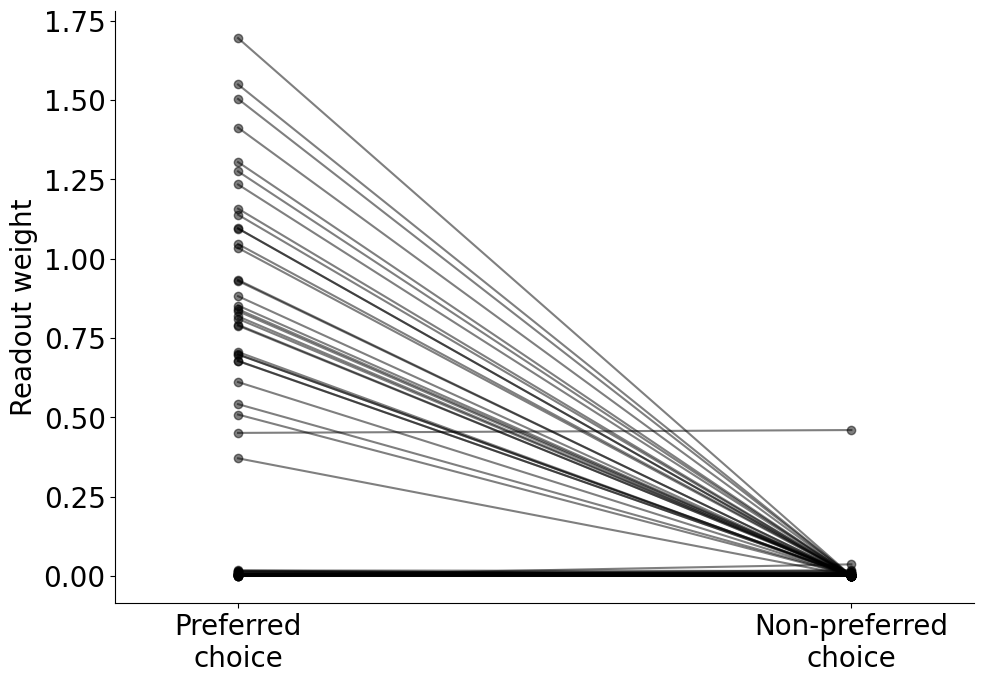

success_2023-05-10-14-28-42_wcst_106_sparsity0


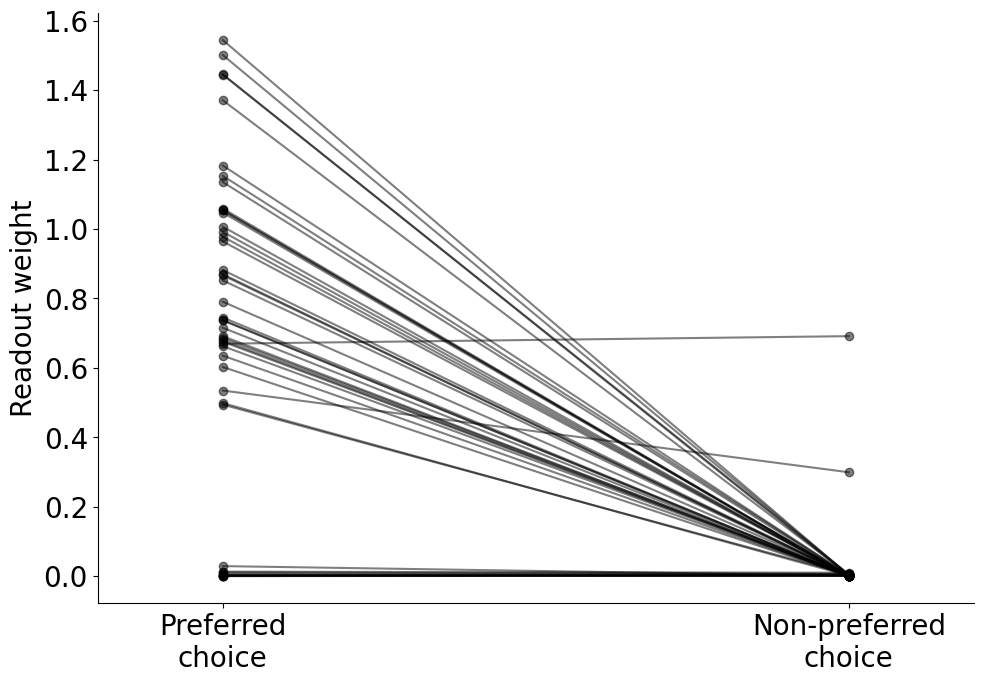

success_2023-05-10-14-28-42_wcst_116_sparsity0


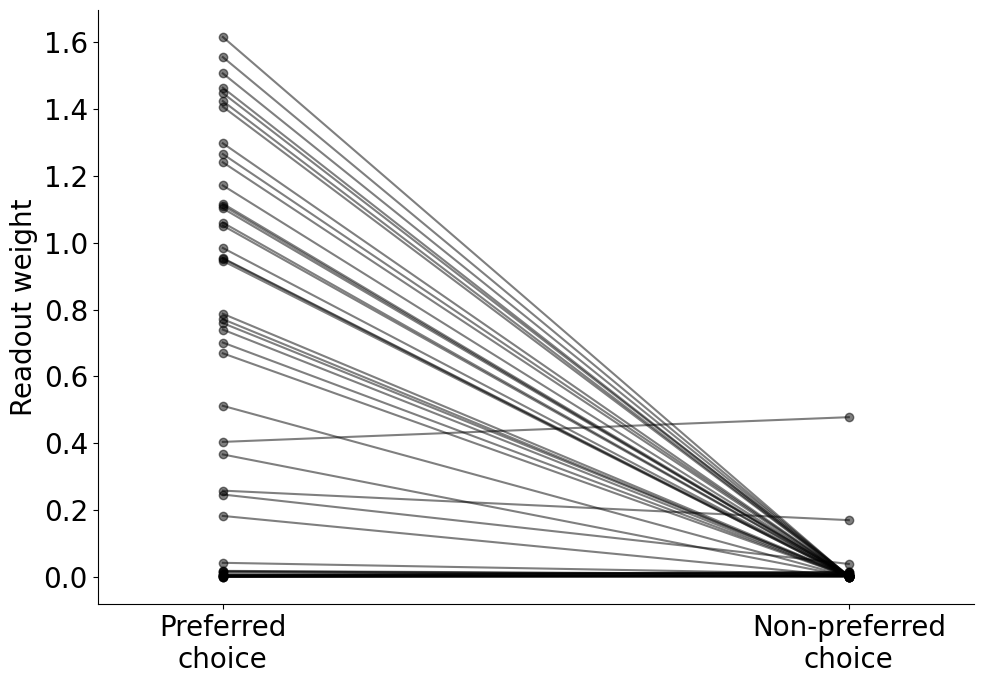

success_2023-05-10-14-28-42_wcst_118_sparsity0


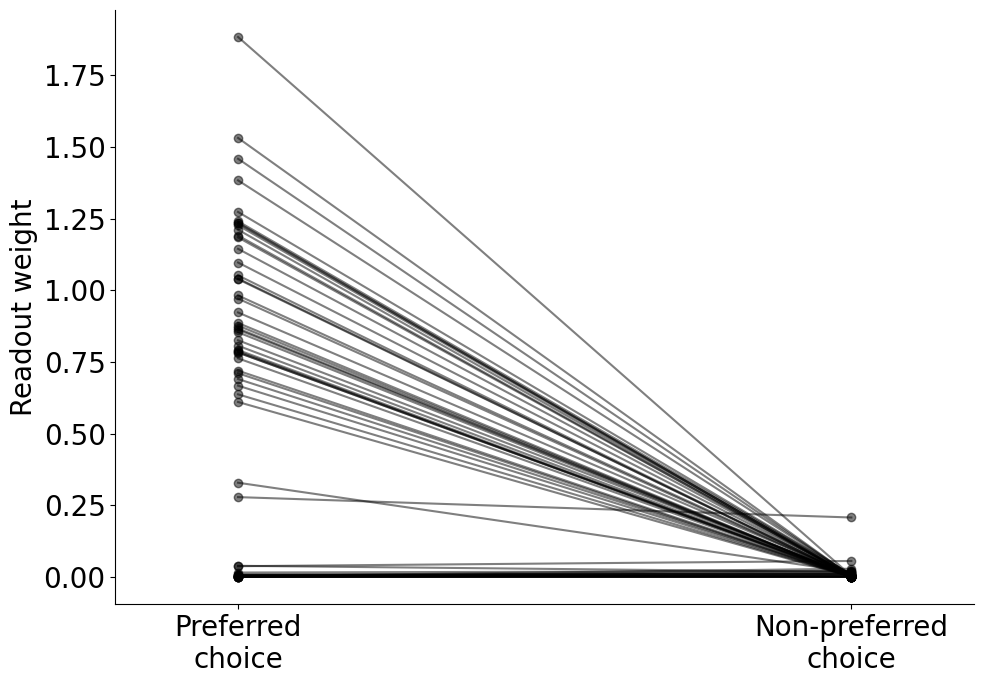

success_2023-05-10-14-28-42_wcst_121_sparsity0


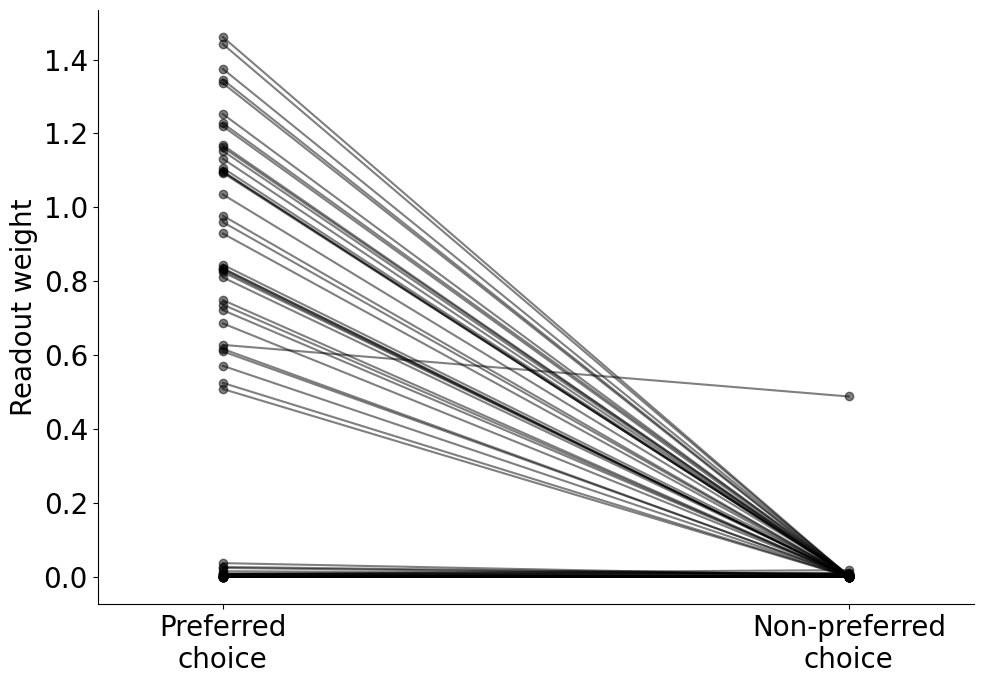

success_2023-05-10-14-28-42_wcst_122_sparsity0


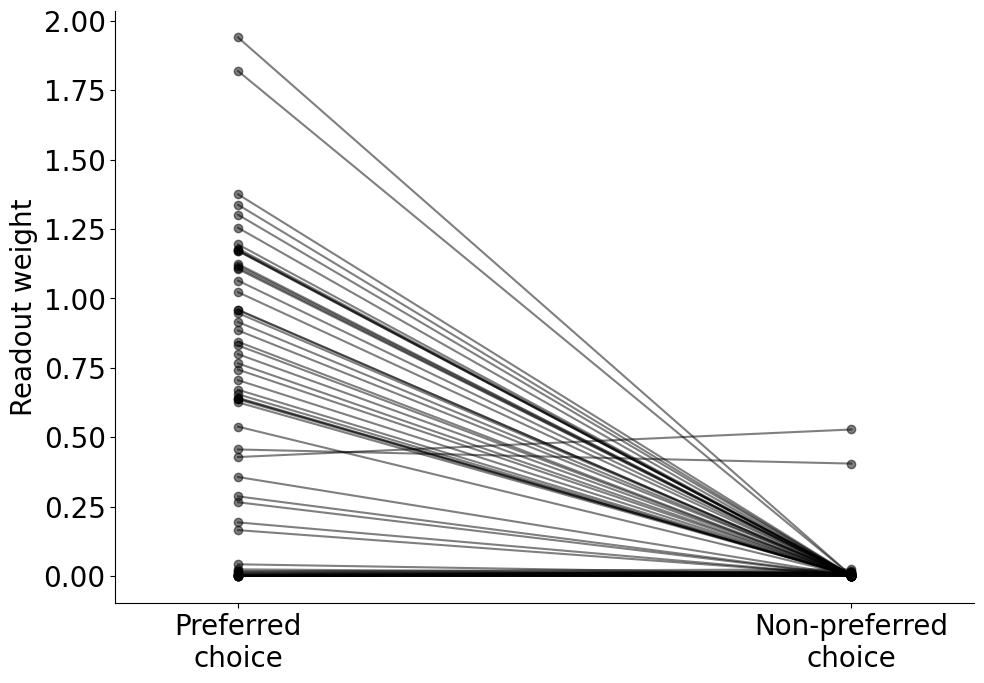

success_2023-05-10-14-28-42_wcst_124_sparsity0


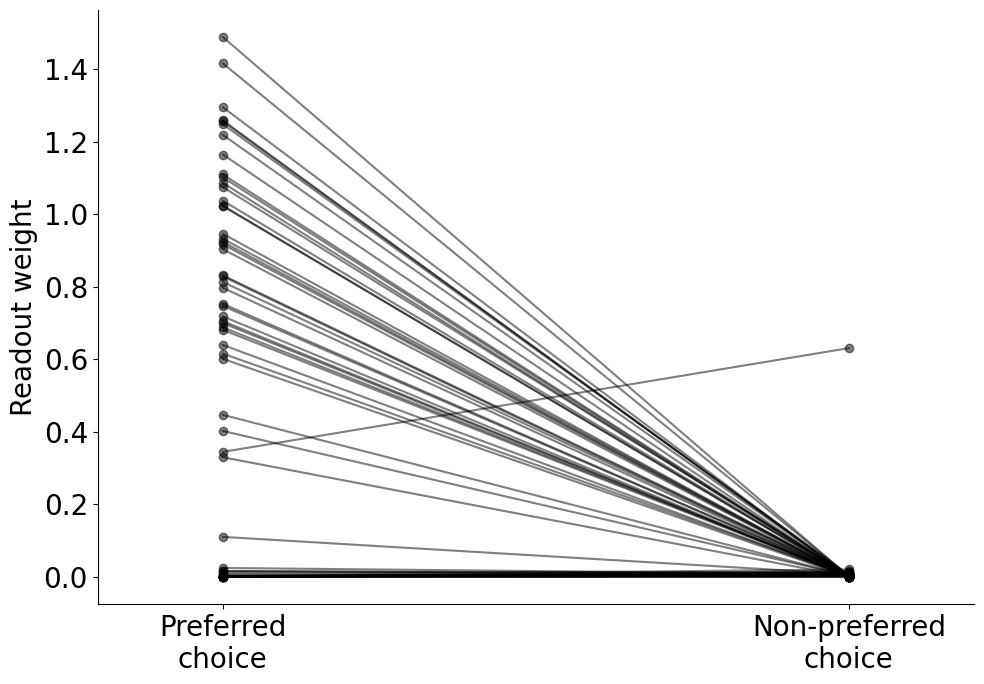

success_2023-05-10-14-28-42_wcst_126_sparsity0


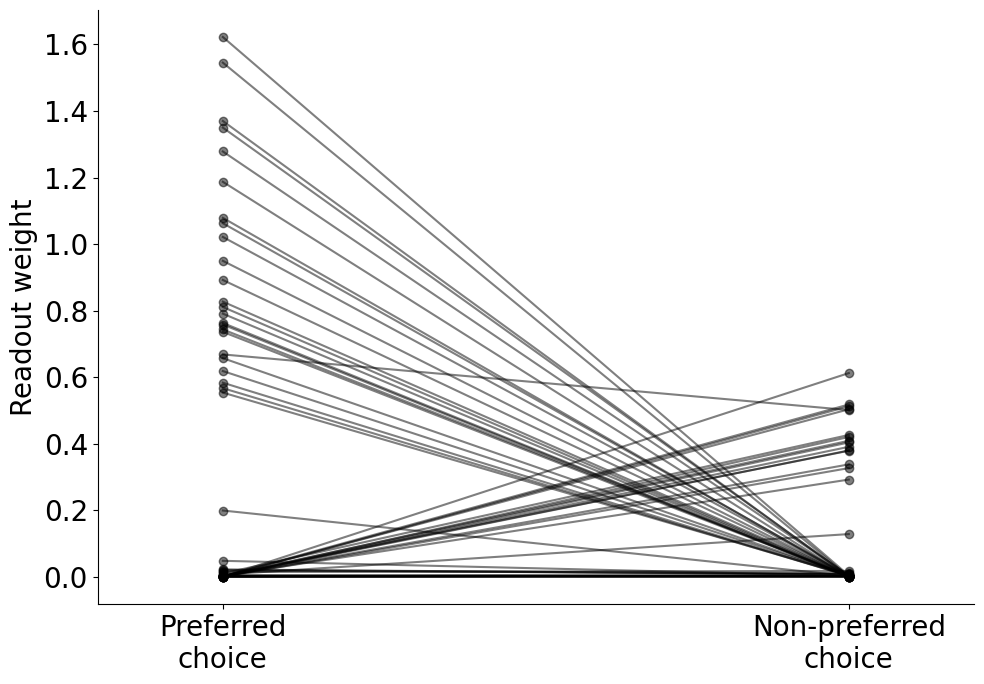

success_2023-05-10-14-28-42_wcst_131_sparsity0


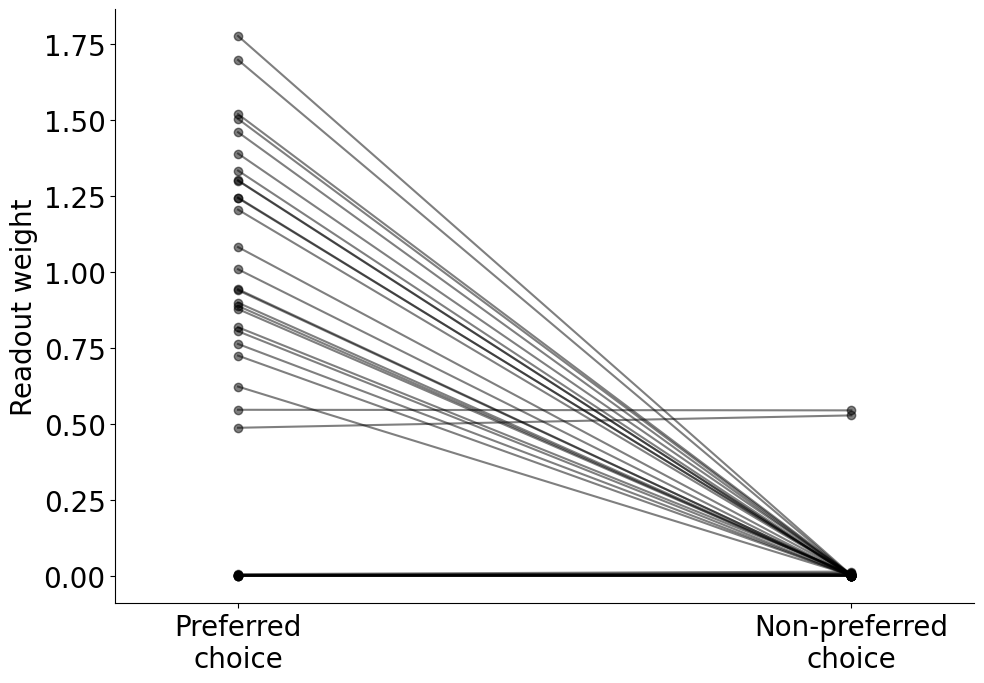

success_2023-05-10-14-28-42_wcst_134_sparsity0


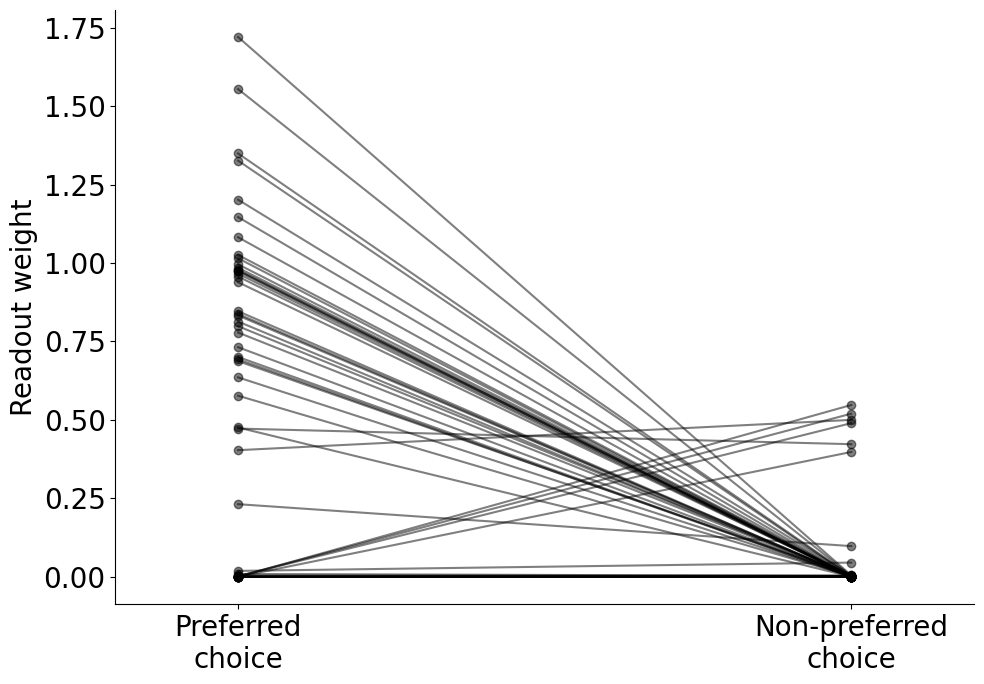

success_2023-05-10-14-28-42_wcst_136_sparsity0


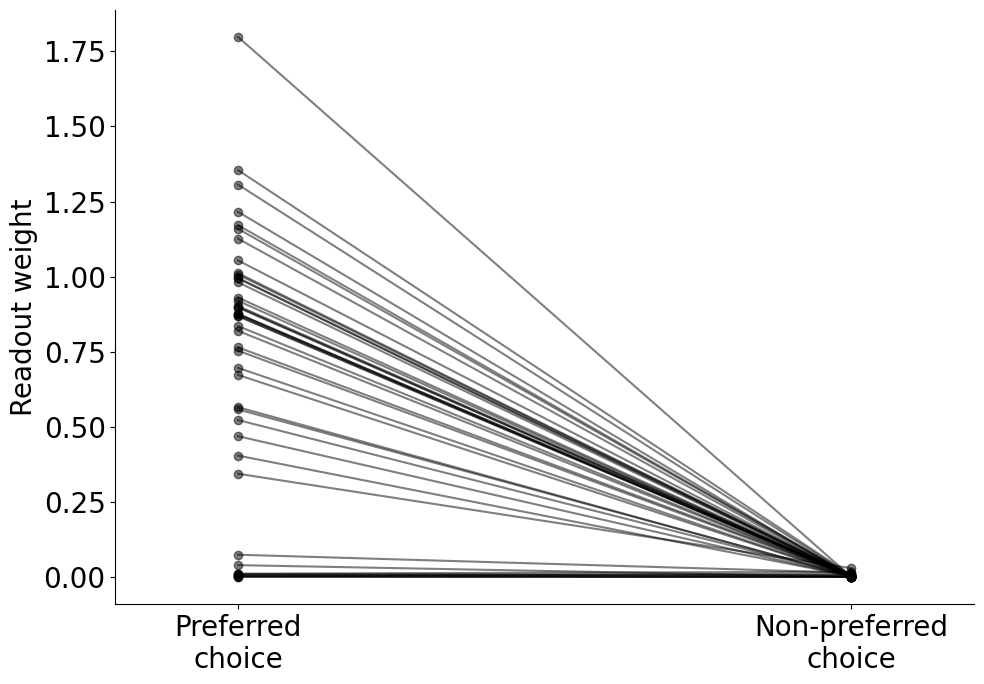

success_2023-05-10-14-28-42_wcst_139_sparsity0


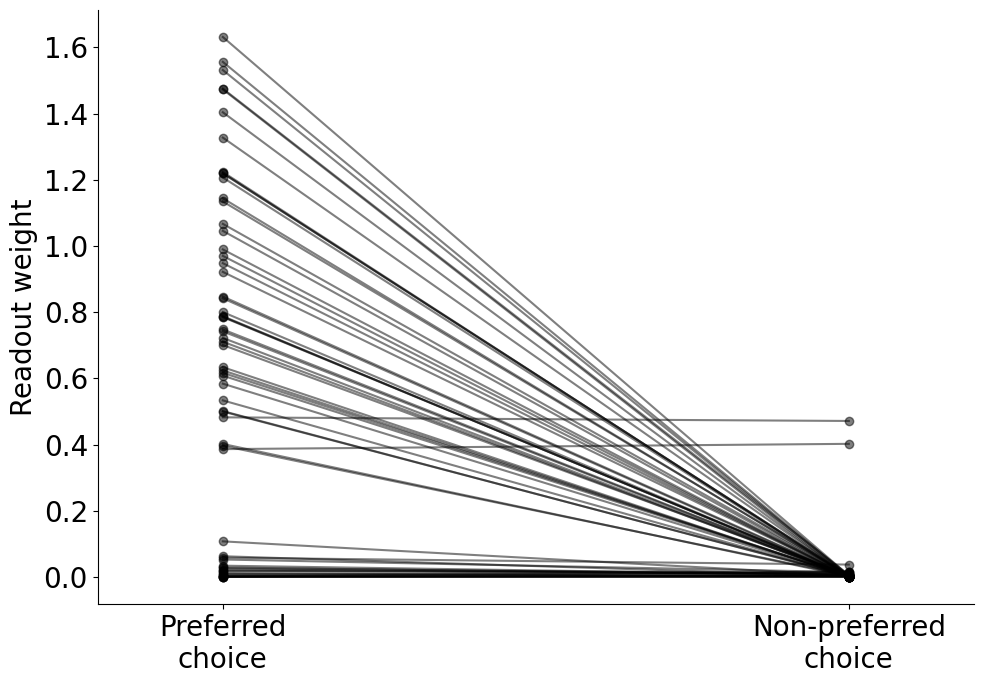

success_2023-05-10-14-28-42_wcst_142_sparsity0


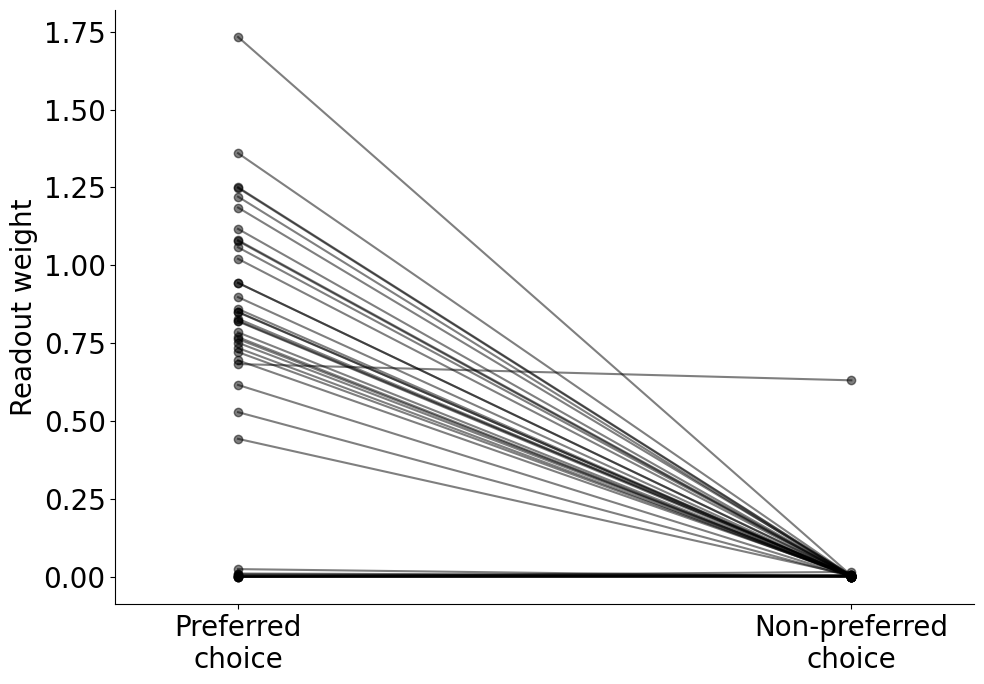

success_2023-05-10-14-28-42_wcst_143_sparsity0


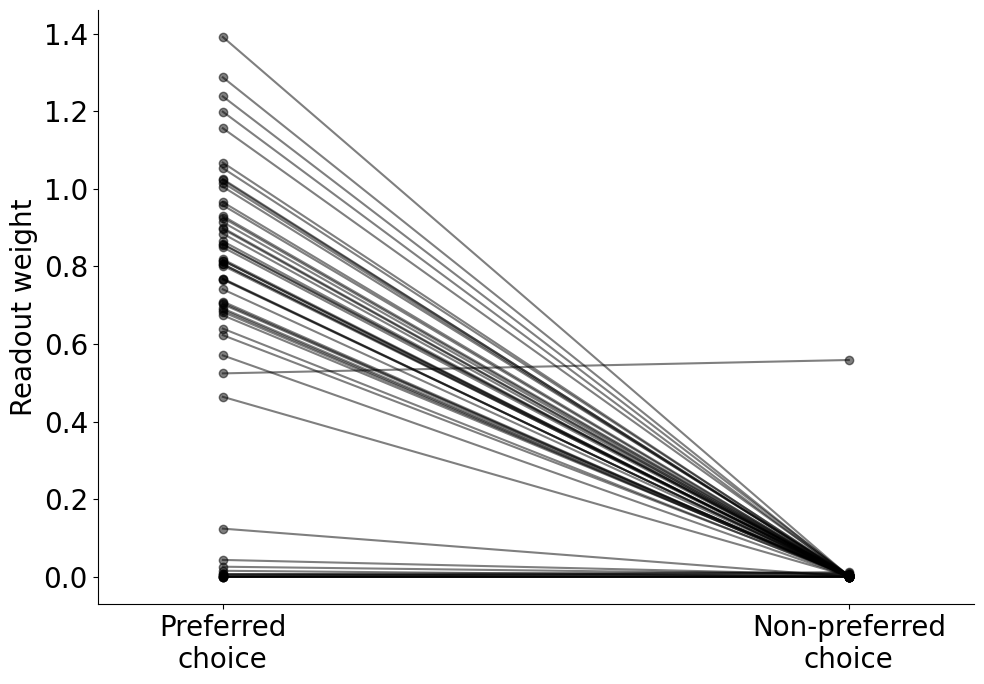

success_2023-05-10-14-28-42_wcst_144_sparsity0


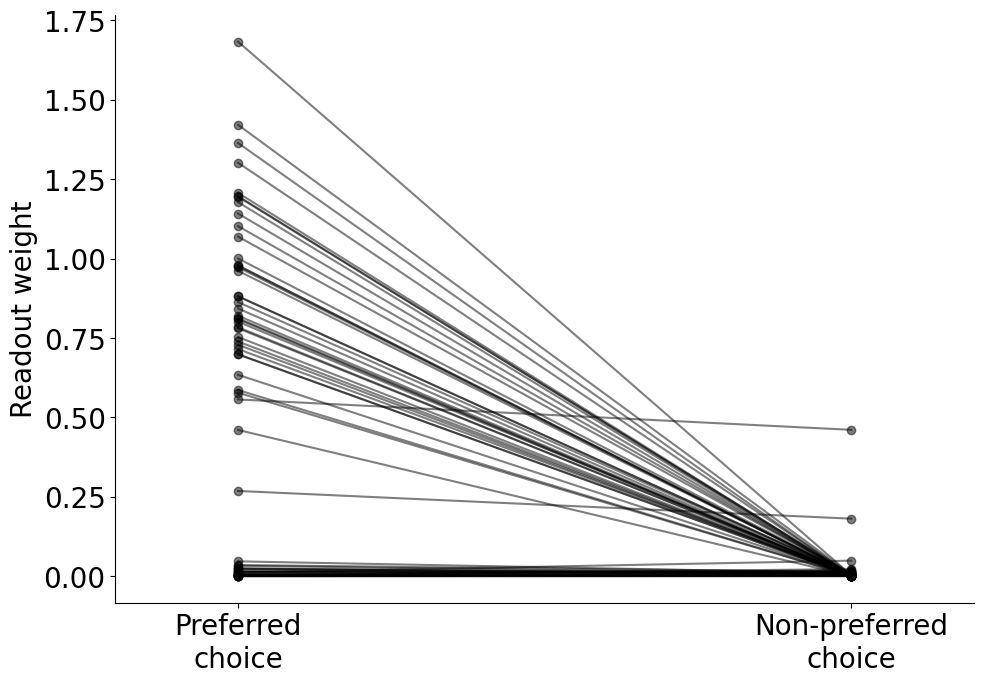

success_2023-05-10-14-28-42_wcst_149_sparsity0


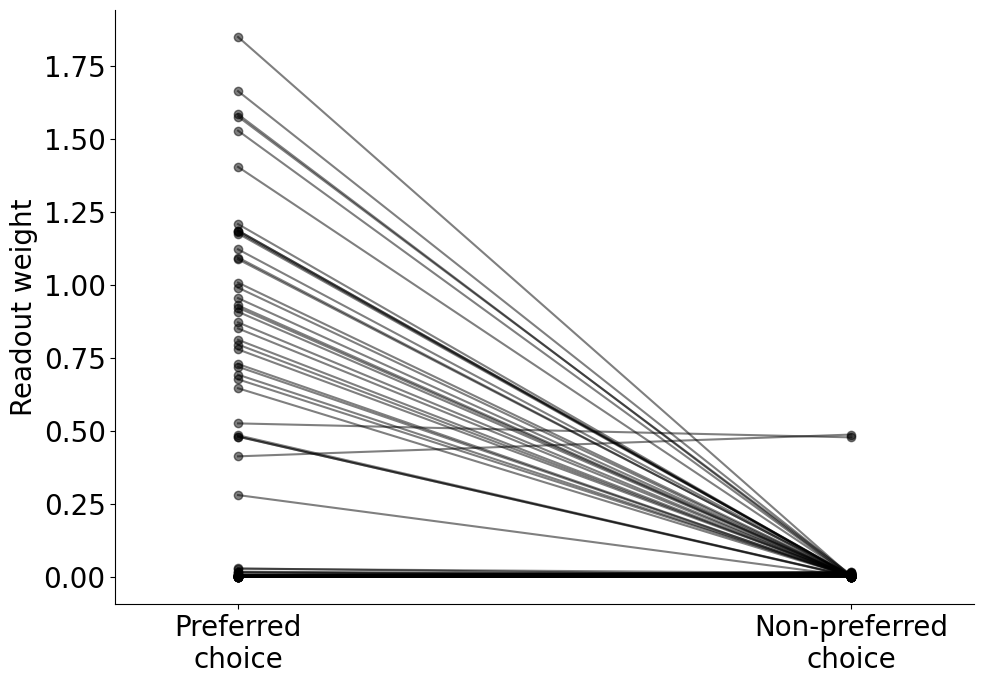

success_2023-05-10-14-28-42_wcst_151_sparsity0


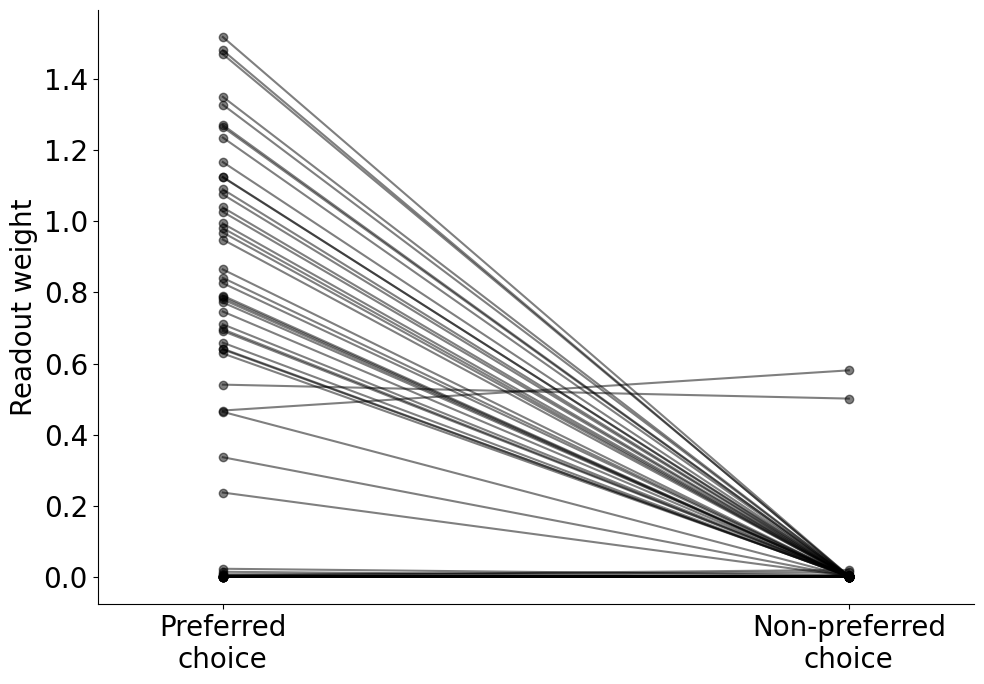

success_2023-05-10-14-28-42_wcst_156_sparsity0


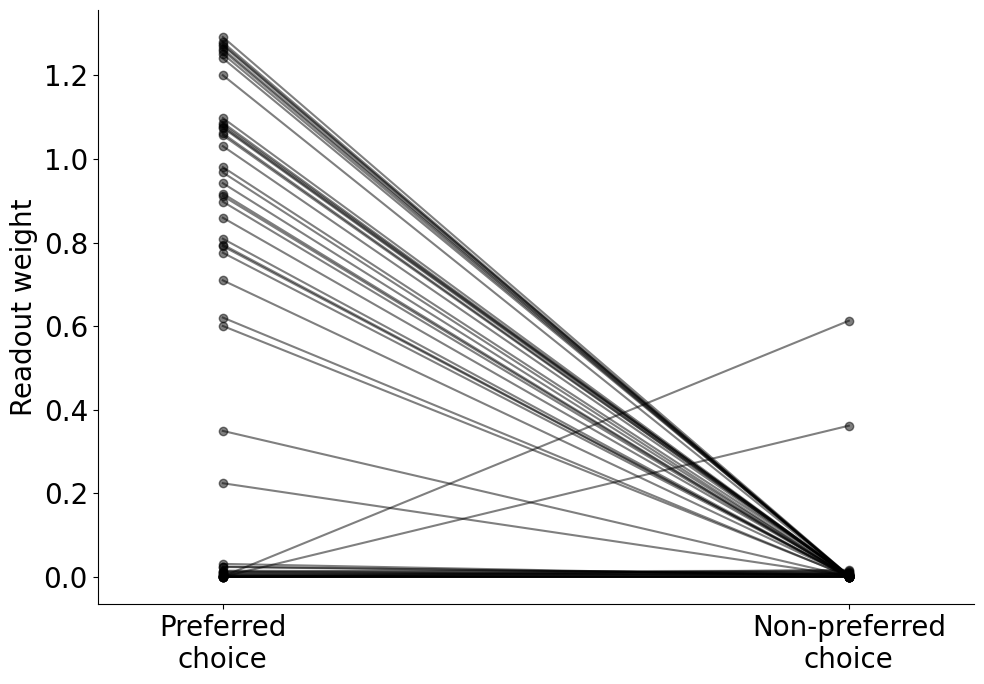

success_2023-05-10-14-28-42_wcst_165_sparsity0


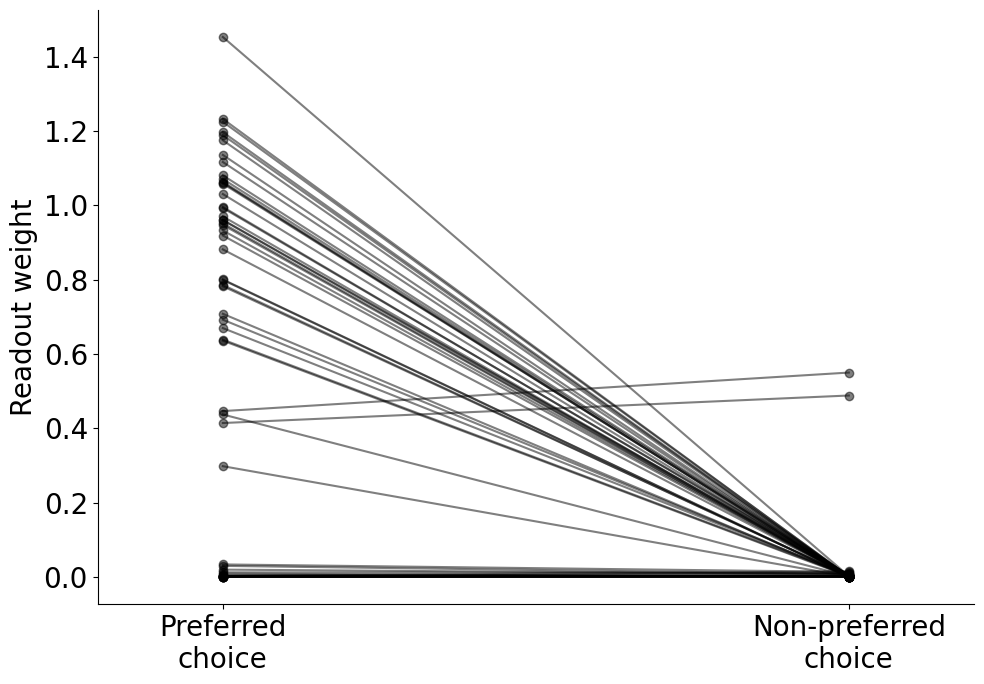

success_2023-05-10-14-28-42_wcst_170_sparsity0


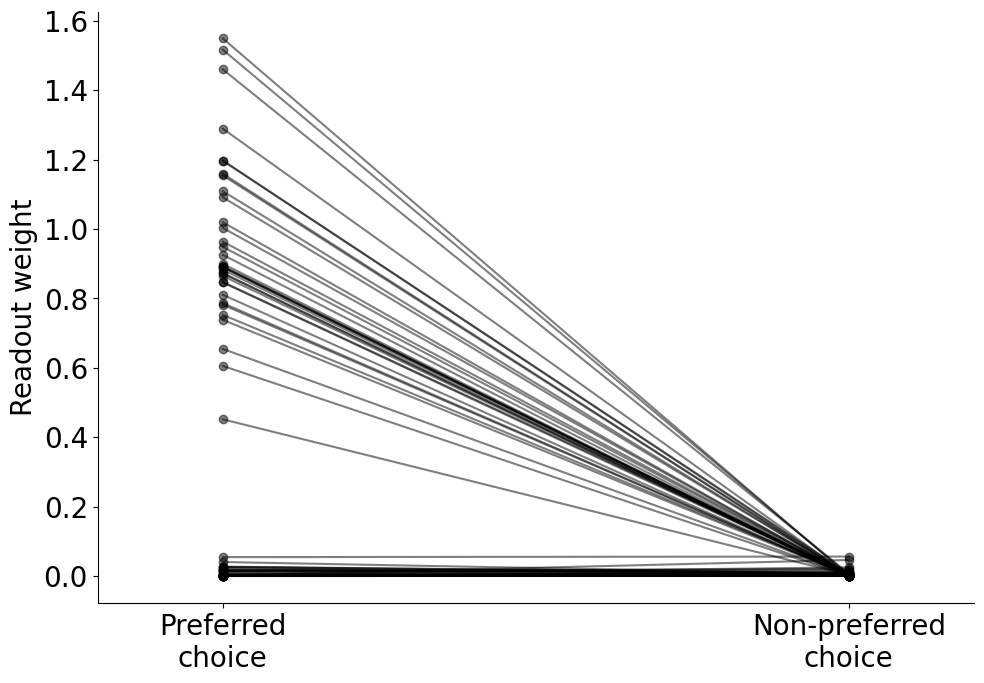

success_2023-05-10-14-28-42_wcst_176_sparsity0


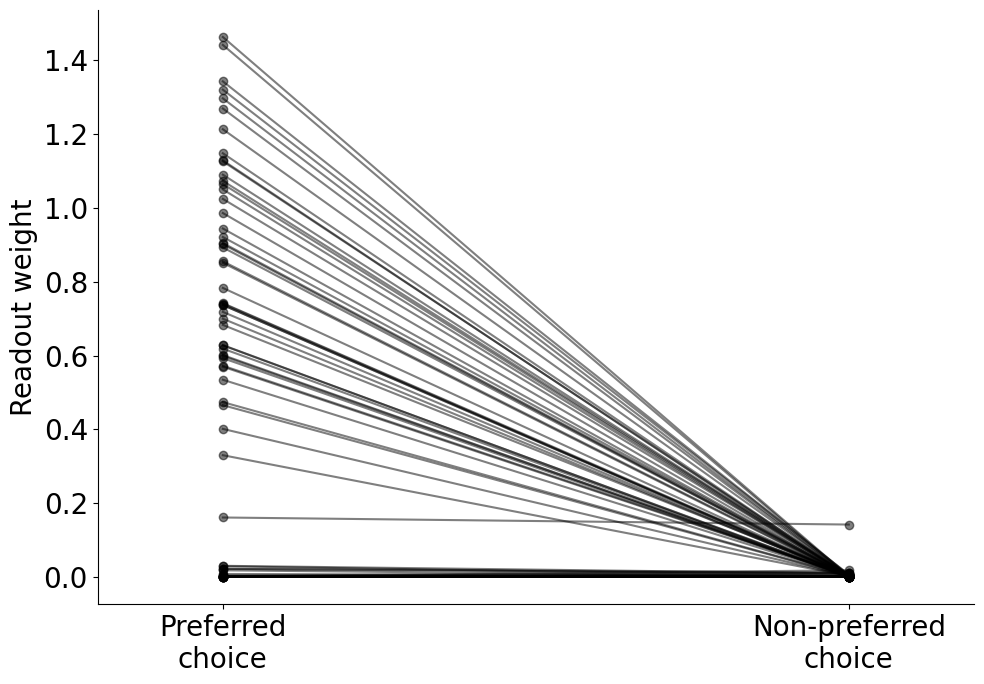

success_2023-05-10-14-28-42_wcst_177_sparsity0


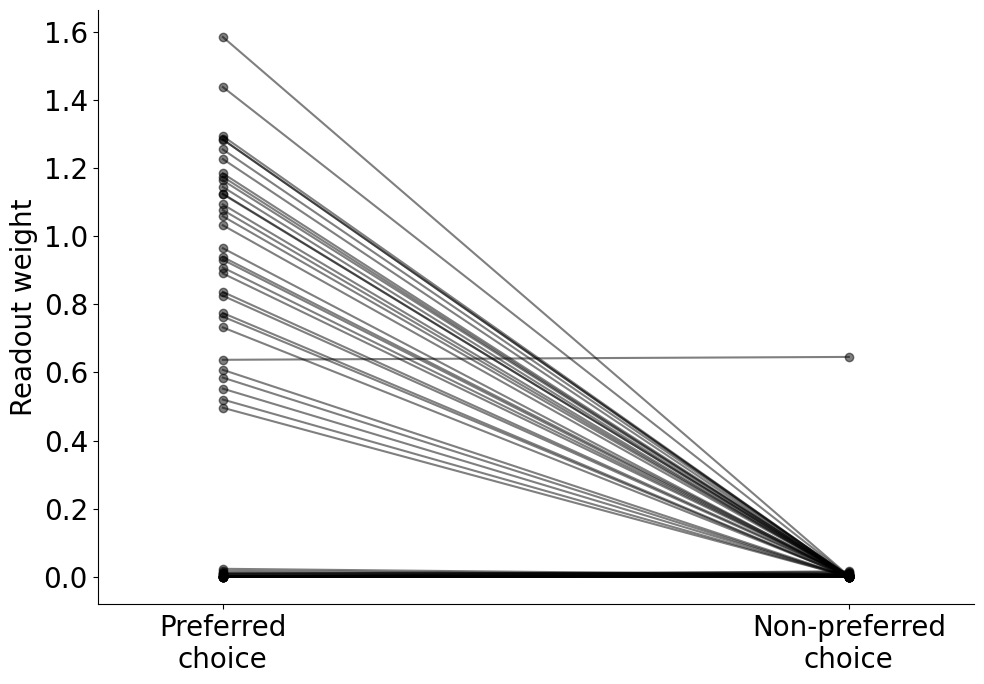

success_2023-05-10-14-28-42_wcst_179_sparsity0


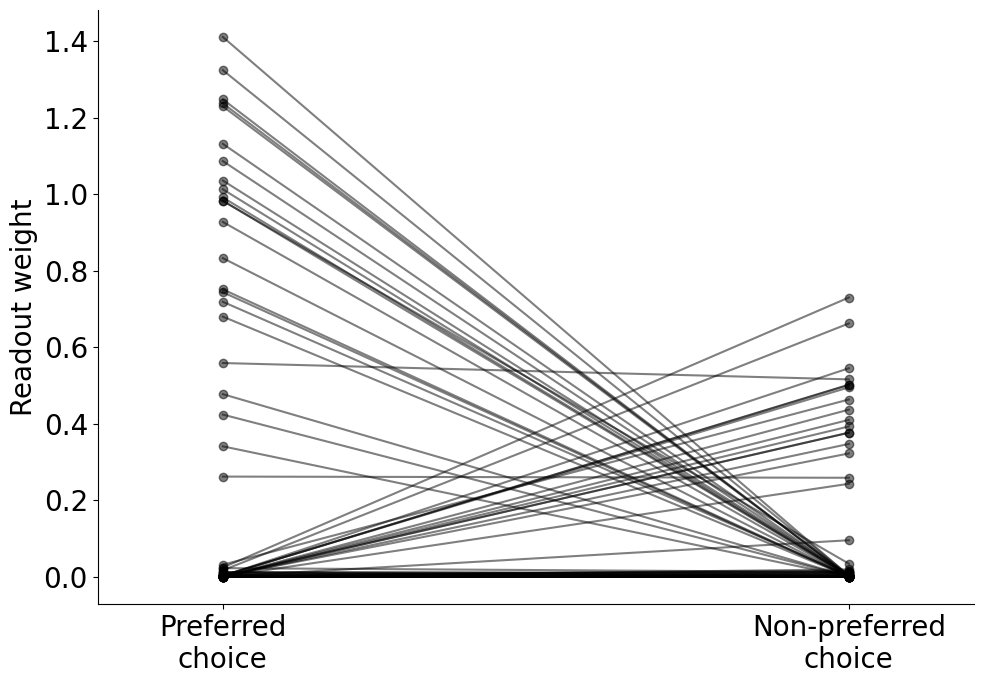

success_2023-05-10-14-28-42_wcst_180_sparsity0


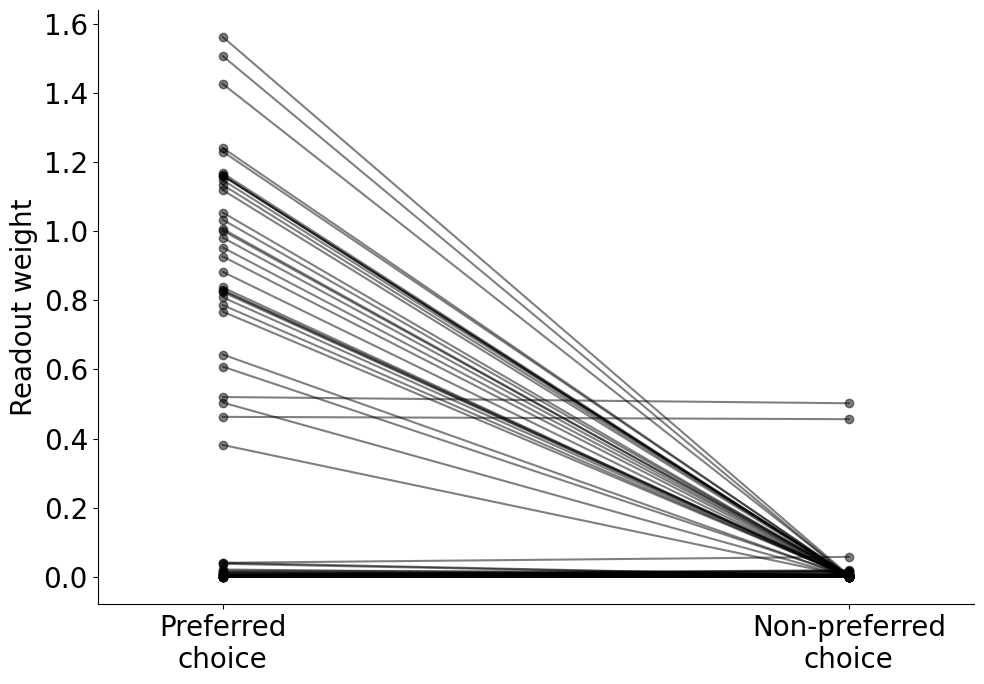

success_2023-05-10-14-28-42_wcst_189_sparsity0


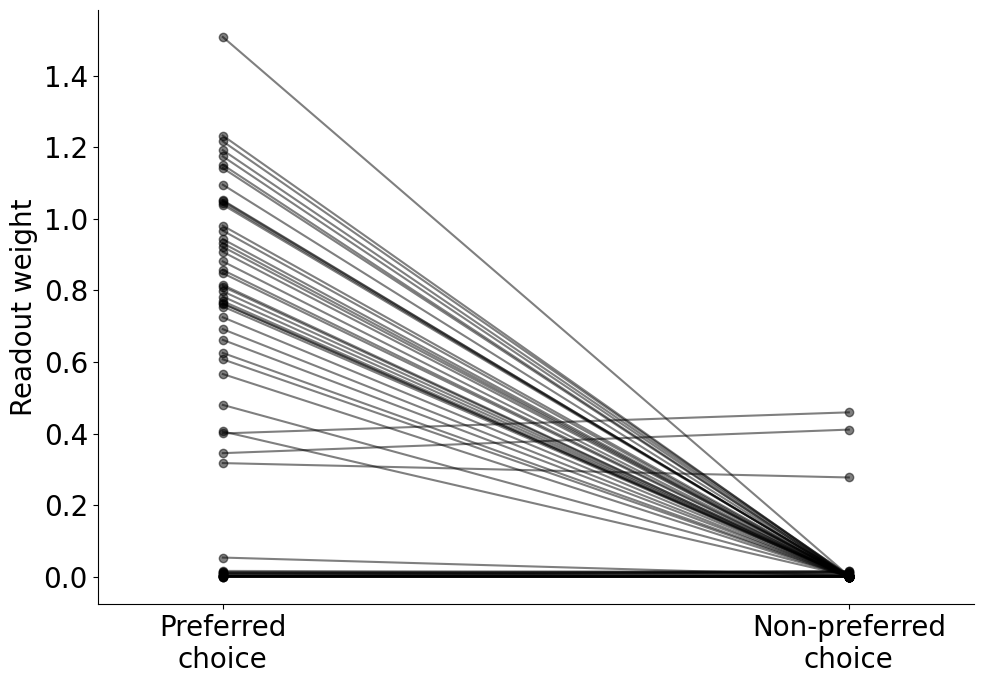

success_2023-05-10-14-28-42_wcst_197_sparsity0


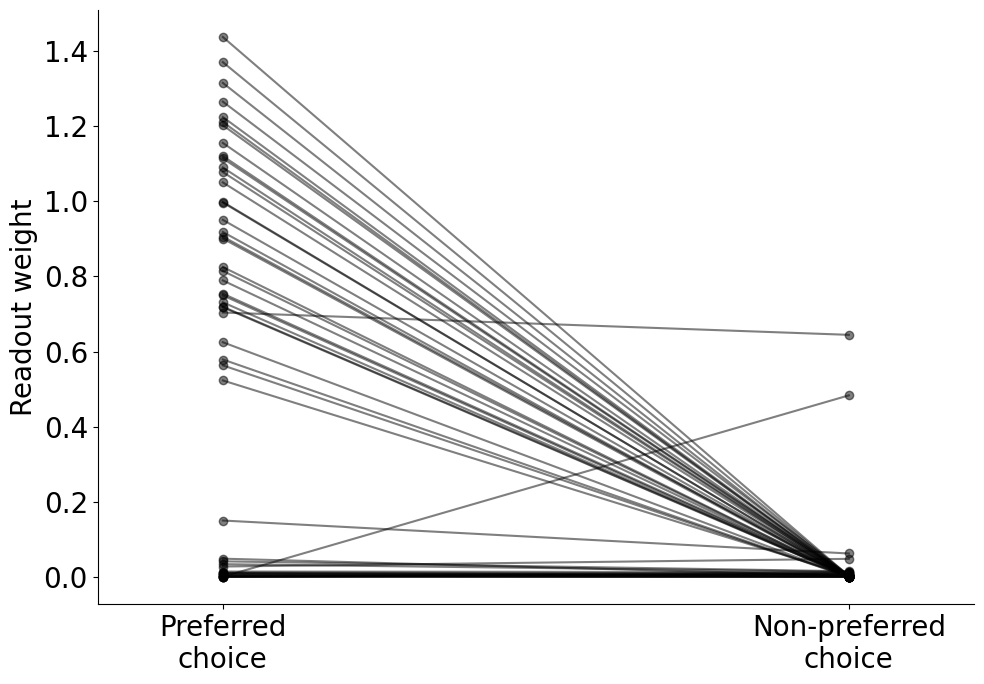

success_2023-05-10-14-28-42_wcst_200_sparsity0


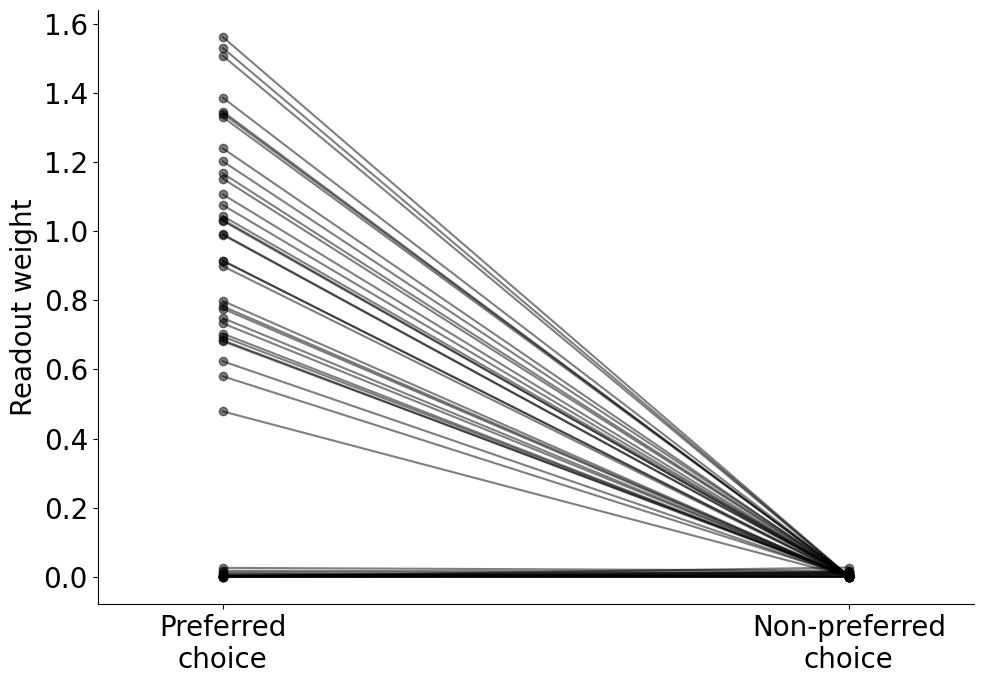

all models


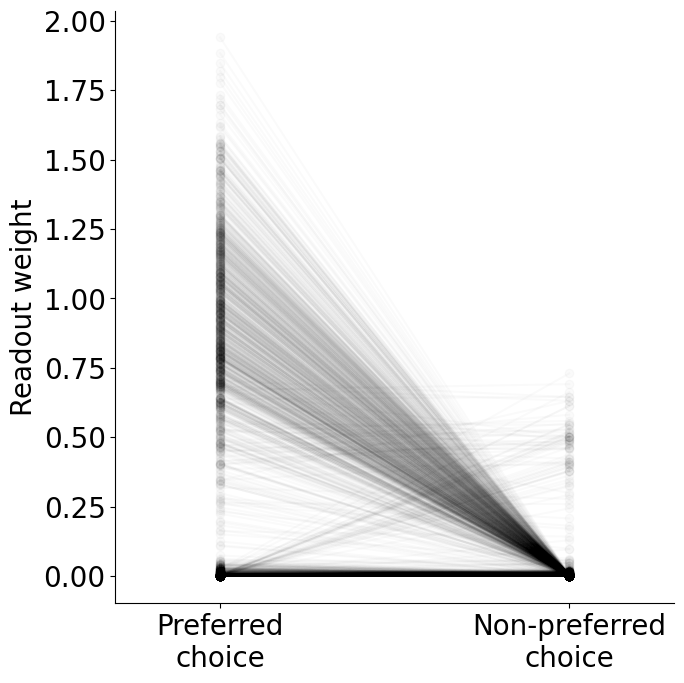

In [7]:
wout_pref_all = []
wout_nonpref_all = []

for data in all_data_wout:
    if data['hp']['dend_nonlinearity']!='divisive_2':
        continue
    print(data['model_name'])
    wout_pref = []
    wout_nonpref = []
    wout = data['w_out_eff']
    for resp in ['c1', 'c2', 'c3']:
        neuron_idx = data['subcg_sr_idx']['resp{}_sr_esoma'.format(resp)]
        if resp=='c1':
            wout_idx_pref, wout_idx_nonpref = 0, [1, 2]
        elif resp=='c2':
            wout_idx_pref, wout_idx_nonpref = 1, [0, 2]
        elif resp=='c3':
            wout_idx_pref, wout_idx_nonpref = 2, [0, 1]
        wout_pref.extend(wout[neuron_idx, wout_idx_pref])
        wout_nonpref.extend(np.mean(wout[np.ix_(neuron_idx, wout_idx_nonpref)], axis=1))
        wout_pref_all.extend(wout[neuron_idx, wout_idx_pref])
        wout_nonpref_all.extend(np.mean(wout[np.ix_(neuron_idx, wout_idx_nonpref)], axis=1))
        
    fig, ax = plt.subplots(figsize=[10,7])
    fig.patch.set_facecolor('white')
    ax.plot([0, 1], [wout_pref, wout_nonpref], color='k', marker='o', alpha=0.5)
    ax.set_xlim([-0.2, 1.2])
    ax.set_xticks([0, 1])
    ax.set_xticklabels(['Preferred\nchoice', 'Non-preferred\nchoice'], rotation=0)
    ax.set_ylabel('Readout weight', fontsize=20)
    make_pretty_axes(ax)
    fig.tight_layout()
    plt.show()
    
print('all models')
fig, ax = plt.subplots(figsize=[7,7])
fig.patch.set_facecolor('white')
ax.plot([0, 1], [wout_pref_all, wout_nonpref_all], color='k', marker='o', alpha=0.02)
ax.set_xlim([-0.3, 1.3])
ax.set_xticks([0, 1])
ax.set_xticklabels(['Preferred\nchoice', 'Non-preferred\nchoice'], rotation=0)
ax.set_ylabel('Readout weight', fontsize=20)
make_pretty_axes(ax)
fig.tight_layout()
plt.show()